Sur les data que la prof à envoyé

## <span style="color:brown"> 1. Imports 

In [1]:
# Import libraries
# PyTorch for building and training neural networks
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader, random_split

from torch import Tensor

# Torchvision for data transformations
import torchvision
from torchvision import datasets, transforms

# Torchinfo to display model summaries
from torchinfo import summary

# Numpy and Pathlib for data handling
import numpy as np
from pathlib import Path

# Tqdm for progress bars
from tqdm.auto import tqdm

# Scikit-learn for splitting datasets
#from sklearn.model_selection import train_test_split

import os
from typing import Optional, Union, Tuple

# Monai for medical imaging, specific to preprocessing and loss functions
import monai
from monai.transforms import LoadImage
from monai.losses import DiceLoss

# Matplotlib for data visualization
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
%matplotlib inline

c:\Users\User\AppData\Local\Programs\Python\Python310\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# Check and display library versions for reproducibility
print(f"PyTorch version: {torch.__version__}")
print(f"Torchvision version: {torchvision.__version__}")
print(f"Numpy version: {np.__version__}")
print(f"Monai version: {monai.__version__}")
print(f"\n")

# Device setup
# Use GPU if available for faster training, otherwise fallback to CPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

PyTorch version: 2.5.1+cu121
Torchvision version: 0.20.1+cu121
Numpy version: 1.26.4
Monai version: 1.4.0


Using device: cuda


## <span style="color:brown"> 2. Load and Visualize the Data

### <span style="color:brown"> 2.1 Slicing Data into PNG files

In [5]:
import os
import SimpleITK as sitk
import numpy as np
from PIL import Image

def preprocess_and_save_slices(input_root, output_root, resized_size=(256, 256)):
    """
    Coupe tous les fichiers .nii en slices .png et sauvegarde sur disque.
    
    input_root: dossier contenant les sous-dossiers patients avec .nii
    output_root: dossier où sauver les slices png
    resized_size: taille des images sauvegardées
    """
    os.makedirs(output_root, exist_ok=True)

    for subfolder in os.listdir(input_root):
        folder_path = os.path.join(input_root, subfolder)
        if not os.path.isdir(folder_path):
            continue

        flair_path = os.path.join(folder_path, "3DFLAIR.nii")
        mask_path = os.path.join(folder_path, "Consensus.nii")

        if not (os.path.exists(flair_path) and os.path.exists(mask_path)):
            continue

        flair_img = sitk.ReadImage(flair_path)
        mask_img = sitk.ReadImage(mask_path)

        flair_array = sitk.GetArrayFromImage(flair_img)  # [D, H, W]
        mask_array = sitk.GetArrayFromImage(mask_img)    # [D, H, W]

        patient_out_folder = os.path.join(output_root, subfolder)
        images_folder = os.path.join(patient_out_folder, "images")
        masks_folder = os.path.join(patient_out_folder, "masks")

        os.makedirs(images_folder, exist_ok=True)
        os.makedirs(masks_folder, exist_ok=True)

        for idx in range(flair_array.shape[0]):
            img_slice = flair_array[idx]
            mask_slice = mask_array[idx]

            img_slice = (img_slice - np.min(img_slice)) / (np.max(img_slice) - np.min(img_slice) + 1e-8)

            img_pil = Image.fromarray((img_slice * 255).astype(np.uint8)).resize(resized_size)
            mask_pil = Image.fromarray((mask_slice > 0).astype(np.uint8) * 255).resize(resized_size)

            img_pil.save(os.path.join(images_folder, f"slice_{idx:04d}.png"))
            mask_pil.save(os.path.join(masks_folder, f"slice_{idx:04d}.png"))

    print(f"✅ Slicing terminé et sauvegardé sous {output_root}")

# 🔥 Comment l'utiliser :
input_root = "../data"  # Ton dossier de base contenant les IRMs
output_root = "../pngData"  # Dossier où sauver les PNG

preprocess_and_save_slices(input_root, output_root)

✅ Slicing terminé et sauvegardé sous ../pngData


### <span style="color:brown"> 2.2 Load PNG files

In [6]:
from torchvision import transforms
from torch.utils.data import Dataset
from PIL import Image
import os
import re

class PngSlicesDataset(Dataset):
    def __init__(self, root_dir, resized_width=256, resized_height=256, slice_range=None, transform=None):
        self.image_paths = []
        self.mask_paths = []
        self.resized_width = resized_width
        self.resized_height = resized_height
        self.slice_range = slice_range
        self.transform = transform if transform is not None else transforms.ToTensor()

        patients = os.listdir(root_dir)
        for patient in patients:
            images_folder = os.path.join(root_dir, patient, "images")
            masks_folder = os.path.join(root_dir, patient, "masks")

            if not os.path.isdir(images_folder) or not os.path.isdir(masks_folder):
                continue

            image_files = sorted(os.listdir(images_folder))

            for img_file in image_files:
                # Utiliser une expression régulière pour détecter slice_XXXX.png
                match = re.match(r"slice_(\d+)\.png", img_file)
                if not match:
                    continue  # Si ce n'est pas un slice_XXXX.png, on ignore

                slice_num = int(match.group(1))

                if self.slice_range:
                    if not (self.slice_range[0] <= slice_num <= self.slice_range[1]):
                        continue

                img_path = os.path.join(images_folder, img_file)
                mask_path = os.path.join(masks_folder, img_file)

                if os.path.exists(img_path) and os.path.exists(mask_path):
                    self.image_paths.append(img_path)
                    self.mask_paths.append(mask_path)

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img = Image.open(self.image_paths[idx]).convert('L')
        mask = Image.open(self.mask_paths[idx]).convert('L')

        resize_transform = transforms.Resize((self.resized_height, self.resized_width))

        img = resize_transform(img)
        mask = resize_transform(mask)

        img = self.transform(img)
        mask = self.transform(mask)

        img = (img - 0.5) / 0.5  # Normaliser [-1,1]
        mask = (mask > 0.5).float()  # Binariser

        return img, mask, os.path.basename(self.image_paths[idx])

In [7]:
def getNearestMultipleOfTwo(x):
    multipleOfTwo = [2**i for i in range(10)]  # [1, 2, 4, ..., 512]
    mini = float('inf')
    nearest_value = None
    
    for elem in multipleOfTwo:
        difference = abs(elem - x)
        if difference < mini:
            mini = difference
            nearest_value = elem
    
    return nearest_value

In [9]:
# Dossier d'un patient
patient_folder = "../pngData/01016SACH"
images_folder = os.path.join(patient_folder, "images")
masks_folder = os.path.join(patient_folder, "masks")

# Liste des fichiers slices
image_files = sorted([f for f in os.listdir(images_folder) if f.endswith('.png')])
mask_files = sorted([f for f in os.listdir(masks_folder) if f.endswith('.png')])

# Charger un exemple pour connaître la taille
img = Image.open(os.path.join(images_folder, image_files[0]))
mask = Image.open(os.path.join(masks_folder, mask_files[0]))

# Obtenir largeur et hauteur
w, h = img.size
print((w, h, len(image_files)), "W, H, num_slices (à partir des PNG)")
print((w, h, len(mask_files)), "W, H, num_slices (masks PNG)")

(256, 256, 336) W, H, num_slices (à partir des PNG)
(256, 256, 336) W, H, num_slices (masks PNG)


In [12]:
width = getNearestMultipleOfTwo(w)
height = getNearestMultipleOfTwo(h)
slice_range = [145, 291]

ROOT_DIR = '../pngData'

train_dataset = PngSlicesDataset(
    root_dir=ROOT_DIR,
    resized_width=width,
    resized_height=height,
    slice_range=slice_range
)

generator = torch.Generator().manual_seed(25)
train_dataset, test_dataset = random_split(train_dataset, [0.8, 0.2], generator=generator)
print("Size dataset :", len(train_dataset) + len(test_dataset))
print("Size train_dataset :", len(train_dataset))
print("Size test_dataset :", len(test_dataset))

test_dataset, val_dataset = random_split(test_dataset, [0.5, 0.5], generator=generator)
print("Size train_dataset :", len(train_dataset))
print("Size test_dataset :", len(test_dataset))
print("Size val_dataset :", len(val_dataset))

device = "cuda" if torch.cuda.is_available() else "cpu"
num_workers = torch.cuda.device_count() * 4 - 1 if device == "cuda" else 1

print("device:", device)
print("num_workers:", num_workers)

LEARNING_RATE = 0.005
BATCH_SIZE = 8

Size dataset : 2205
Size train_dataset : 1764
Size test_dataset : 441
Size train_dataset : 1764
Size test_dataset : 221
Size val_dataset : 220
device: cuda
num_workers: 3


In [13]:
train_dataloader = DataLoader(dataset=train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_dataloader = DataLoader(dataset=val_dataset,batch_size=BATCH_SIZE,shuffle= False)
test_dataloader = DataLoader(dataset=test_dataset,batch_size=1, shuffle=False)

### <span style="color:brown"> 2.3 Visualize data samples

train_idx: 898
val_idx: 188
test_idx: 145


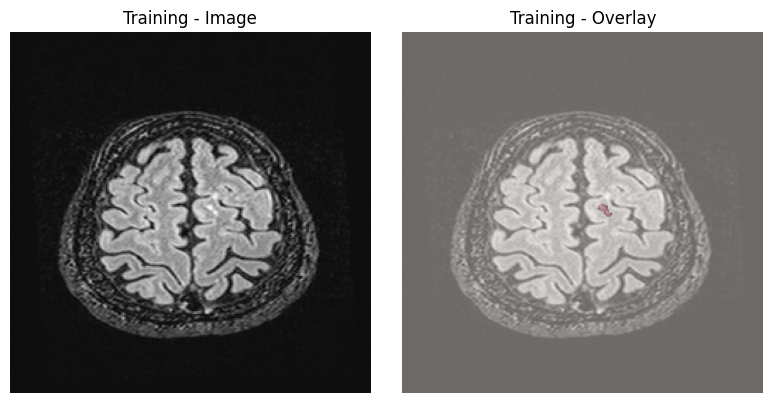

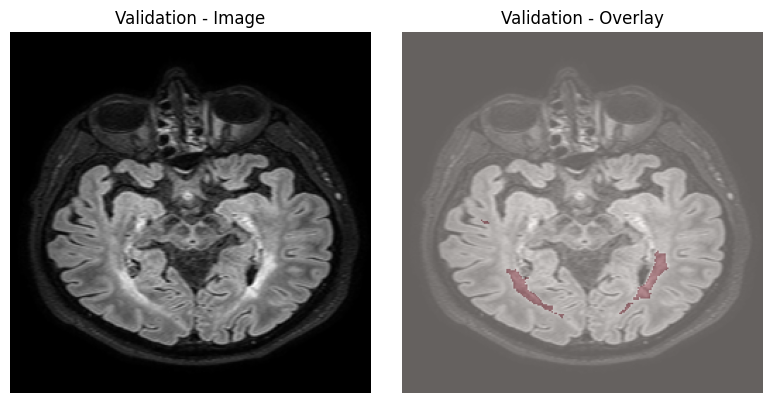

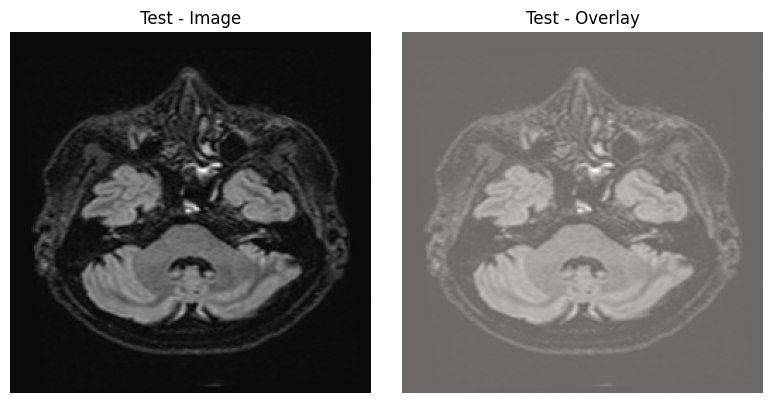

In [14]:
# Obtenir un index aléatoire pour chaque dataset
train_idx = np.random.randint(len(train_dataset))
val_idx = np.random.randint(len(val_dataset))
test_idx = np.random.randint(len(test_dataset))

print("train_idx:", train_idx)
print("val_idx:", val_idx)
print("test_idx:", test_idx)

def plot_slice(dataset, index, dataset_name):
    batch_data = dataset[index]
    image, label = batch_data[0].to(device), batch_data[1].to(device)

    # Conversion en numpy
    image = image.squeeze().detach().cpu().numpy()
    label = label.squeeze().detach().cpu().numpy()

    image = (image + 1) / 2.0  # Normaliser [0,1]

    fig, axes = plt.subplots(1, 2, figsize=(8, 4))

    axes[0].imshow(image, cmap='gray')
    axes[0].set_title(f"{dataset_name} - Image")
    axes[0].axis('off')

    axes[1].imshow(image, cmap='gray')
    axes[1].imshow(label, cmap='Reds', alpha=0.4)
    axes[1].set_title(f"{dataset_name} - Overlay")
    axes[1].axis('off')

    plt.tight_layout()
    plt.show()

# 🔥 Afficher séparément
plot_slice(train_dataset, train_idx, dataset_name="Training")
plot_slice(val_dataset, val_idx, dataset_name="Validation")
plot_slice(test_dataset, test_idx, dataset_name="Test")


## <span style="color:brown"> 3 UNet Network Architecture

### UNet parameters

In [15]:
# Model Architecture Parameters
input_channels = 1
num_classes  = 1      #  e.g. 1 for binary segmentation (background vs object)
input_shape = (input_channels, width, height)  # This is the shape of the input image to the network
output_shape = (num_classes, width, height)  # This is the shape of the output mask
init_channels = 32              # This is the number of channels in the first layer of the network

### UNet Model

In [16]:
from monai.networks.nets import UNet

# Define a Unet with  monai, lighter than Class Unet 
# Creation of the model U-Net with MONAI
model = UNet(
    spatial_dims = 2,                   # 2D U-Net
    in_channels = 1,                    # e.g. 3 for RGB, 1 for grayscale input images
    out_channels = 1,                   # 1 for binary segmentation
    channels = (16, 32, 64, 128, 256),  # Nombres de canaux aux différents niveaux d'encodage
    strides = (2, 2, 2, 2),             # Strides de downsampling (modèle aura 4 niveaux) 
    num_res_units=1                     # Nombre d'unités résiduelles par bloc
).to(device)

### Loss function

In [17]:
learning_rate = 0.001
n_epochs = 1000 

from monai.losses import DiceLoss

# Option 1 : Utiliser Dice Loss seule
criterion = DiceLoss(sigmoid=True)

# Option 2 (recommandée) : Combiner Dice + BCE
class ComboLoss(nn.Module):
    def __init__(self, dice_weight=0.7):
        super().__init__()
        self.dice = DiceLoss(sigmoid=True)
        self.bce = nn.BCEWithLogitsLoss(pos_weight=torch.tensor([20.0]).to(device))  # 20 peut être ajusté
        self.dice_weight = dice_weight

    def forward(self, inputs, targets):
        dice_loss = self.dice(inputs, targets)
        bce_loss = self.bce(inputs, targets)
        return self.dice_weight * dice_loss + (1 - self.dice_weight) * bce_loss

criterion = ComboLoss(dice_weight=0.7)

optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

# Train the model

In [25]:
%%time
# Déplacement du modèle sur le device
model = model.to(device)

# Listes pour stocker les pertes
train_losses = []
valid_losses = []

best_metric = -1
best_valid_loss = float('inf')
best_model = None
best_epoch = 0

model.train()  # mettre en mode entraînement

for epoch in tqdm(range(n_epochs)):

    train_loss = 0.0
    model.train()

    ###################
    # Phase entraînement
    ###################
    for batch_data in tqdm(train_dataloader, position=0, leave=True):
        images, labels = batch_data[0].to(device), batch_data[1].to(device)
        optimizer.zero_grad()

        output = model(images)

        loss = criterion(output, labels)  # ici output brut pour la loss (pas de sigmoid ici)
        loss.backward()
        optimizer.step()

        train_loss += loss.item() * images.size(0)

    train_loss = train_loss / len(train_dataloader.dataset)
    train_losses.append(train_loss)

    ###################
    # Phase validation
    ###################
    model.eval()
    valid_loss = 0.0

    with torch.no_grad():
        for batch_data in tqdm(val_dataloader, position=0, leave=True):
            val_inputs, val_labels = batch_data[0].to(device), batch_data[1].to(device)

            val_outputs = model(val_inputs)
            val_loss = criterion(val_outputs, val_labels)  # pareil : output brut

            valid_loss += val_loss.item() * val_inputs.size(0)

        valid_loss = valid_loss / len(val_dataloader.dataset)
        valid_losses.append(valid_loss)

        print(f'Epoch: {epoch+1} \tTraining Loss: {train_loss:.4f} \tValidation Loss: {valid_loss:.4f}')

        # Sauvegarde du meilleur modèle
        if valid_loss < best_valid_loss:
            best_valid_loss = valid_loss
            best_model = model.state_dict()
            best_epoch = epoch + 1

print(f"✅ Best model selected at epoch {best_epoch} with validation loss: {best_valid_loss:.4f}")


  0%|          | 1/1000 [00:17<4:54:04, 17.66s/it]

Epoch: 1 	Training Loss: 0.1356 	Validation Loss: 0.2052


  0%|          | 2/1000 [00:27<3:37:19, 13.07s/it]

Epoch: 2 	Training Loss: 0.1211 	Validation Loss: 0.2074


  0%|          | 3/1000 [00:35<3:01:39, 10.93s/it]

Epoch: 3 	Training Loss: 0.1131 	Validation Loss: 0.1968


  0%|          | 4/1000 [00:44<2:44:44,  9.92s/it]

Epoch: 4 	Training Loss: 0.1099 	Validation Loss: 0.1974


  0%|          | 5/1000 [00:52<2:35:50,  9.40s/it]

Epoch: 5 	Training Loss: 0.1072 	Validation Loss: 0.1924


  1%|          | 6/1000 [01:01<2:29:55,  9.05s/it]

Epoch: 6 	Training Loss: 0.1040 	Validation Loss: 0.1881


  1%|          | 7/1000 [01:09<2:25:52,  8.81s/it]

Epoch: 7 	Training Loss: 0.1011 	Validation Loss: 0.1901


  1%|          | 8/1000 [01:17<2:23:28,  8.68s/it]

Epoch: 8 	Training Loss: 0.0992 	Validation Loss: 0.1902


  1%|          | 9/1000 [01:26<2:21:57,  8.60s/it]

Epoch: 9 	Training Loss: 0.0968 	Validation Loss: 0.1892


  1%|          | 10/1000 [01:34<2:20:57,  8.54s/it]

Epoch: 10 	Training Loss: 0.0959 	Validation Loss: 0.1870


  1%|          | 11/1000 [01:43<2:20:39,  8.53s/it]

Epoch: 11 	Training Loss: 0.0944 	Validation Loss: 0.1888


  1%|          | 12/1000 [01:51<2:20:21,  8.52s/it]

Epoch: 12 	Training Loss: 0.0935 	Validation Loss: 0.1839


  1%|▏         | 13/1000 [02:00<2:20:15,  8.53s/it]

Epoch: 13 	Training Loss: 0.0917 	Validation Loss: 0.1842


  1%|▏         | 14/1000 [02:09<2:22:58,  8.70s/it]

Epoch: 14 	Training Loss: 0.0908 	Validation Loss: 0.1839


  2%|▏         | 15/1000 [02:18<2:24:11,  8.78s/it]

Epoch: 15 	Training Loss: 0.0892 	Validation Loss: 0.1844


  2%|▏         | 16/1000 [02:26<2:23:12,  8.73s/it]

Epoch: 16 	Training Loss: 0.0888 	Validation Loss: 0.1848


  2%|▏         | 17/1000 [02:36<2:29:02,  9.10s/it]

Epoch: 17 	Training Loss: 0.0879 	Validation Loss: 0.2001


  2%|▏         | 18/1000 [02:46<2:33:18,  9.37s/it]

Epoch: 18 	Training Loss: 0.0911 	Validation Loss: 0.1988


  2%|▏         | 19/1000 [02:56<2:33:45,  9.40s/it]

Epoch: 19 	Training Loss: 0.0893 	Validation Loss: 0.1823


  2%|▏         | 20/1000 [03:08<2:47:08, 10.23s/it]

Epoch: 20 	Training Loss: 0.0859 	Validation Loss: 0.1875


  2%|▏         | 21/1000 [03:17<2:40:30,  9.84s/it]

Epoch: 21 	Training Loss: 0.0846 	Validation Loss: 0.1834


  2%|▏         | 22/1000 [03:26<2:36:12,  9.58s/it]

Epoch: 22 	Training Loss: 0.0841 	Validation Loss: 0.1827


  2%|▏         | 23/1000 [03:35<2:33:29,  9.43s/it]

Epoch: 23 	Training Loss: 0.0837 	Validation Loss: 0.1798


  2%|▏         | 24/1000 [03:46<2:42:29,  9.99s/it]

Epoch: 24 	Training Loss: 0.0886 	Validation Loss: 0.1846


  2%|▎         | 25/1000 [03:56<2:40:59,  9.91s/it]

Epoch: 25 	Training Loss: 0.0875 	Validation Loss: 0.1773


  3%|▎         | 26/1000 [04:05<2:38:31,  9.77s/it]

Epoch: 26 	Training Loss: 0.0839 	Validation Loss: 0.1787


  3%|▎         | 27/1000 [04:15<2:37:06,  9.69s/it]

Epoch: 27 	Training Loss: 0.0814 	Validation Loss: 0.1764


  3%|▎         | 28/1000 [04:25<2:36:53,  9.68s/it]

Epoch: 28 	Training Loss: 0.0802 	Validation Loss: 0.1789


  3%|▎         | 29/1000 [04:35<2:41:01,  9.95s/it]

Epoch: 29 	Training Loss: 0.0785 	Validation Loss: 0.1800


  3%|▎         | 30/1000 [04:46<2:43:07, 10.09s/it]

Epoch: 30 	Training Loss: 0.0844 	Validation Loss: 0.1857


  3%|▎         | 31/1000 [04:58<2:54:49, 10.83s/it]

Epoch: 31 	Training Loss: 0.0781 	Validation Loss: 0.1821


  3%|▎         | 32/1000 [05:09<2:54:17, 10.80s/it]

Epoch: 32 	Training Loss: 0.0773 	Validation Loss: 0.1806


  3%|▎         | 33/1000 [05:19<2:48:55, 10.48s/it]

Epoch: 33 	Training Loss: 0.0758 	Validation Loss: 0.1801


  3%|▎         | 34/1000 [05:28<2:44:59, 10.25s/it]

Epoch: 34 	Training Loss: 0.0762 	Validation Loss: 0.1837


  4%|▎         | 35/1000 [05:38<2:44:12, 10.21s/it]

Epoch: 35 	Training Loss: 0.0765 	Validation Loss: 0.1802


  4%|▎         | 36/1000 [05:49<2:46:53, 10.39s/it]

Epoch: 36 	Training Loss: 0.0774 	Validation Loss: 0.1801


  4%|▎         | 37/1000 [06:00<2:46:18, 10.36s/it]

Epoch: 37 	Training Loss: 0.0758 	Validation Loss: 0.1821


  4%|▍         | 38/1000 [06:13<2:59:26, 11.19s/it]

Epoch: 38 	Training Loss: 0.0743 	Validation Loss: 0.1838


  4%|▍         | 39/1000 [06:24<2:59:26, 11.20s/it]

Epoch: 39 	Training Loss: 0.0731 	Validation Loss: 0.1843


  4%|▍         | 40/1000 [06:35<2:56:52, 11.05s/it]

Epoch: 40 	Training Loss: 0.0730 	Validation Loss: 0.1783


  4%|▍         | 41/1000 [06:46<2:57:41, 11.12s/it]

Epoch: 41 	Training Loss: 0.0774 	Validation Loss: 0.1929


  4%|▍         | 42/1000 [06:57<2:58:09, 11.16s/it]

Epoch: 42 	Training Loss: 0.0784 	Validation Loss: 0.1837


  4%|▍         | 43/1000 [07:09<2:59:17, 11.24s/it]

Epoch: 43 	Training Loss: 0.0727 	Validation Loss: 0.1767


  4%|▍         | 44/1000 [07:20<3:00:20, 11.32s/it]

Epoch: 44 	Training Loss: 0.0713 	Validation Loss: 0.1796


  4%|▍         | 45/1000 [07:32<3:02:26, 11.46s/it]

Epoch: 45 	Training Loss: 0.0711 	Validation Loss: 0.1848


  5%|▍         | 46/1000 [07:43<3:02:10, 11.46s/it]

Epoch: 46 	Training Loss: 0.0701 	Validation Loss: 0.1782


  5%|▍         | 47/1000 [07:55<3:04:53, 11.64s/it]

Epoch: 47 	Training Loss: 0.0711 	Validation Loss: 0.1849


  5%|▍         | 48/1000 [08:07<3:06:10, 11.73s/it]

Epoch: 48 	Training Loss: 0.0752 	Validation Loss: 0.1818


  5%|▍         | 49/1000 [08:19<3:05:05, 11.68s/it]

Epoch: 49 	Training Loss: 0.0720 	Validation Loss: 0.1846


  5%|▌         | 50/1000 [08:31<3:07:33, 11.85s/it]

Epoch: 50 	Training Loss: 0.0702 	Validation Loss: 0.1837


  5%|▌         | 51/1000 [08:43<3:08:34, 11.92s/it]

Epoch: 51 	Training Loss: 0.0696 	Validation Loss: 0.1735


  5%|▌         | 52/1000 [08:56<3:10:28, 12.05s/it]

Epoch: 52 	Training Loss: 0.0679 	Validation Loss: 0.1771


  5%|▌         | 53/1000 [09:08<3:09:59, 12.04s/it]

Epoch: 53 	Training Loss: 0.0680 	Validation Loss: 0.1782


  5%|▌         | 54/1000 [09:20<3:09:32, 12.02s/it]

Epoch: 54 	Training Loss: 0.0677 	Validation Loss: 0.1871


  6%|▌         | 55/1000 [09:32<3:10:26, 12.09s/it]

Epoch: 55 	Training Loss: 0.0673 	Validation Loss: 0.1751


  6%|▌         | 56/1000 [09:44<3:09:52, 12.07s/it]

Epoch: 56 	Training Loss: 0.0686 	Validation Loss: 0.1812


  6%|▌         | 57/1000 [09:56<3:09:59, 12.09s/it]

Epoch: 57 	Training Loss: 0.0689 	Validation Loss: 0.1779


  6%|▌         | 58/1000 [10:09<3:12:20, 12.25s/it]

Epoch: 58 	Training Loss: 0.0676 	Validation Loss: 0.1781


  6%|▌         | 59/1000 [10:20<3:10:24, 12.14s/it]

Epoch: 59 	Training Loss: 0.0660 	Validation Loss: 0.1810


  6%|▌         | 60/1000 [10:33<3:09:50, 12.12s/it]

Epoch: 60 	Training Loss: 0.0708 	Validation Loss: 0.1778


  6%|▌         | 61/1000 [10:44<3:08:30, 12.05s/it]

Epoch: 61 	Training Loss: 0.0676 	Validation Loss: 0.1767


  6%|▌         | 62/1000 [10:57<3:10:49, 12.21s/it]

Epoch: 62 	Training Loss: 0.0669 	Validation Loss: 0.1811


  6%|▋         | 63/1000 [11:10<3:12:41, 12.34s/it]

Epoch: 63 	Training Loss: 0.0770 	Validation Loss: 0.1909


  6%|▋         | 64/1000 [11:22<3:11:20, 12.27s/it]

Epoch: 64 	Training Loss: 0.0705 	Validation Loss: 0.1848


  6%|▋         | 65/1000 [11:33<3:06:19, 11.96s/it]

Epoch: 65 	Training Loss: 0.0683 	Validation Loss: 0.1800


  7%|▋         | 66/1000 [11:45<3:06:51, 12.00s/it]

Epoch: 66 	Training Loss: 0.0661 	Validation Loss: 0.1870


  7%|▋         | 67/1000 [11:59<3:16:17, 12.62s/it]

Epoch: 67 	Training Loss: 0.0645 	Validation Loss: 0.1829


  7%|▋         | 68/1000 [12:13<3:21:07, 12.95s/it]

Epoch: 68 	Training Loss: 0.0638 	Validation Loss: 0.1849


  7%|▋         | 69/1000 [12:26<3:22:41, 13.06s/it]

Epoch: 69 	Training Loss: 0.0628 	Validation Loss: 0.1868


  7%|▋         | 70/1000 [12:39<3:19:12, 12.85s/it]

Epoch: 70 	Training Loss: 0.0625 	Validation Loss: 0.1851


  7%|▋         | 71/1000 [12:53<3:26:49, 13.36s/it]

Epoch: 71 	Training Loss: 0.0626 	Validation Loss: 0.1824


  7%|▋         | 72/1000 [13:05<3:21:00, 13.00s/it]

Epoch: 72 	Training Loss: 0.0628 	Validation Loss: 0.1883


  7%|▋         | 73/1000 [13:17<3:15:51, 12.68s/it]

Epoch: 73 	Training Loss: 0.0643 	Validation Loss: 0.1830


  7%|▋         | 74/1000 [13:30<3:17:31, 12.80s/it]

Epoch: 74 	Training Loss: 0.0649 	Validation Loss: 0.1869


  8%|▊         | 75/1000 [13:43<3:15:14, 12.66s/it]

Epoch: 75 	Training Loss: 0.0641 	Validation Loss: 0.1838


  8%|▊         | 76/1000 [13:55<3:12:28, 12.50s/it]

Epoch: 76 	Training Loss: 0.0631 	Validation Loss: 0.1858


  8%|▊         | 77/1000 [14:07<3:09:12, 12.30s/it]

Epoch: 77 	Training Loss: 0.0627 	Validation Loss: 0.1892


  8%|▊         | 78/1000 [14:19<3:07:23, 12.19s/it]

Epoch: 78 	Training Loss: 0.0624 	Validation Loss: 0.1840


  8%|▊         | 79/1000 [14:30<3:04:04, 11.99s/it]

Epoch: 79 	Training Loss: 0.0625 	Validation Loss: 0.1857


  8%|▊         | 80/1000 [14:43<3:06:44, 12.18s/it]

Epoch: 80 	Training Loss: 0.0621 	Validation Loss: 0.1835


  8%|▊         | 81/1000 [14:55<3:05:38, 12.12s/it]

Epoch: 81 	Training Loss: 0.0636 	Validation Loss: 0.1833


  8%|▊         | 82/1000 [15:07<3:04:22, 12.05s/it]

Epoch: 82 	Training Loss: 0.0643 	Validation Loss: 0.1805


  8%|▊         | 83/1000 [15:19<3:04:40, 12.08s/it]

Epoch: 83 	Training Loss: 0.0626 	Validation Loss: 0.1889


  8%|▊         | 84/1000 [15:32<3:10:35, 12.48s/it]

Epoch: 84 	Training Loss: 0.0624 	Validation Loss: 0.1889


  8%|▊         | 85/1000 [15:44<3:09:12, 12.41s/it]

Epoch: 85 	Training Loss: 0.0660 	Validation Loss: 0.2010


  9%|▊         | 86/1000 [15:58<3:13:38, 12.71s/it]

Epoch: 86 	Training Loss: 0.0652 	Validation Loss: 0.1839


  9%|▊         | 87/1000 [16:11<3:14:16, 12.77s/it]

Epoch: 87 	Training Loss: 0.0630 	Validation Loss: 0.1894


  9%|▉         | 88/1000 [16:23<3:10:10, 12.51s/it]

Epoch: 88 	Training Loss: 0.0642 	Validation Loss: 0.2079


  9%|▉         | 89/1000 [16:35<3:09:17, 12.47s/it]

Epoch: 89 	Training Loss: 0.0647 	Validation Loss: 0.1932


  9%|▉         | 90/1000 [16:47<3:08:07, 12.40s/it]

Epoch: 90 	Training Loss: 0.0609 	Validation Loss: 0.1888


  9%|▉         | 91/1000 [17:00<3:07:44, 12.39s/it]

Epoch: 91 	Training Loss: 0.0601 	Validation Loss: 0.1842


  9%|▉         | 92/1000 [17:13<3:11:01, 12.62s/it]

Epoch: 92 	Training Loss: 0.0589 	Validation Loss: 0.1887


  9%|▉         | 93/1000 [17:27<3:16:21, 12.99s/it]

Epoch: 93 	Training Loss: 0.0587 	Validation Loss: 0.1880


  9%|▉         | 94/1000 [17:47<3:49:03, 15.17s/it]

Epoch: 94 	Training Loss: 0.0590 	Validation Loss: 0.1872


 10%|▉         | 95/1000 [17:59<3:34:59, 14.25s/it]

Epoch: 95 	Training Loss: 0.0592 	Validation Loss: 0.1887


 10%|▉         | 96/1000 [18:11<3:23:42, 13.52s/it]

Epoch: 96 	Training Loss: 0.0586 	Validation Loss: 0.1840


 10%|▉         | 97/1000 [18:23<3:18:29, 13.19s/it]

Epoch: 97 	Training Loss: 0.0584 	Validation Loss: 0.1912


 10%|▉         | 98/1000 [18:35<3:12:37, 12.81s/it]

Epoch: 98 	Training Loss: 0.0587 	Validation Loss: 0.1963


 10%|▉         | 99/1000 [18:48<3:11:04, 12.72s/it]

Epoch: 99 	Training Loss: 0.0593 	Validation Loss: 0.1881


 10%|█         | 100/1000 [19:00<3:10:30, 12.70s/it]

Epoch: 100 	Training Loss: 0.0601 	Validation Loss: 0.1907


 10%|█         | 101/1000 [19:12<3:05:07, 12.36s/it]

Epoch: 101 	Training Loss: 0.0598 	Validation Loss: 0.1863


 10%|█         | 102/1000 [19:23<3:01:26, 12.12s/it]

Epoch: 102 	Training Loss: 0.0596 	Validation Loss: 0.1883


 10%|█         | 103/1000 [19:35<3:00:54, 12.10s/it]

Epoch: 103 	Training Loss: 0.0585 	Validation Loss: 0.1931


 10%|█         | 104/1000 [19:47<3:00:02, 12.06s/it]

Epoch: 104 	Training Loss: 0.0584 	Validation Loss: 0.1926


 10%|█         | 105/1000 [19:59<2:57:51, 11.92s/it]

Epoch: 105 	Training Loss: 0.0578 	Validation Loss: 0.1961


 11%|█         | 106/1000 [20:13<3:06:58, 12.55s/it]

Epoch: 106 	Training Loss: 0.0568 	Validation Loss: 0.1907


 11%|█         | 107/1000 [20:25<3:05:41, 12.48s/it]

Epoch: 107 	Training Loss: 0.0669 	Validation Loss: 0.1882


 11%|█         | 108/1000 [20:38<3:07:17, 12.60s/it]

Epoch: 108 	Training Loss: 0.0618 	Validation Loss: 0.1882


 11%|█         | 109/1000 [20:53<3:15:03, 13.13s/it]

Epoch: 109 	Training Loss: 0.0603 	Validation Loss: 0.2038


 11%|█         | 110/1000 [21:04<3:08:34, 12.71s/it]

Epoch: 110 	Training Loss: 0.0753 	Validation Loss: 0.2019


 11%|█         | 111/1000 [21:16<3:04:50, 12.48s/it]

Epoch: 111 	Training Loss: 0.0699 	Validation Loss: 0.2145


 11%|█         | 112/1000 [21:29<3:04:48, 12.49s/it]

Epoch: 112 	Training Loss: 0.0689 	Validation Loss: 0.1948


 11%|█▏        | 113/1000 [21:41<3:03:56, 12.44s/it]

Epoch: 113 	Training Loss: 0.0602 	Validation Loss: 0.1953


 11%|█▏        | 114/1000 [21:53<3:00:10, 12.20s/it]

Epoch: 114 	Training Loss: 0.0578 	Validation Loss: 0.1927


 12%|█▏        | 115/1000 [22:05<3:00:10, 12.22s/it]

Epoch: 115 	Training Loss: 0.0558 	Validation Loss: 0.1936


 12%|█▏        | 116/1000 [22:18<3:01:57, 12.35s/it]

Epoch: 116 	Training Loss: 0.0546 	Validation Loss: 0.1938


 12%|█▏        | 117/1000 [22:30<3:00:51, 12.29s/it]

Epoch: 117 	Training Loss: 0.0539 	Validation Loss: 0.1961


 12%|█▏        | 118/1000 [22:44<3:07:06, 12.73s/it]

Epoch: 118 	Training Loss: 0.0543 	Validation Loss: 0.1936


 12%|█▏        | 119/1000 [22:56<3:03:57, 12.53s/it]

Epoch: 119 	Training Loss: 0.0538 	Validation Loss: 0.1964


 12%|█▏        | 120/1000 [23:09<3:06:25, 12.71s/it]

Epoch: 120 	Training Loss: 0.0538 	Validation Loss: 0.1955


 12%|█▏        | 121/1000 [23:21<3:04:15, 12.58s/it]

Epoch: 121 	Training Loss: 0.0538 	Validation Loss: 0.1960


 12%|█▏        | 122/1000 [23:33<3:00:54, 12.36s/it]

Epoch: 122 	Training Loss: 0.0578 	Validation Loss: 0.2027


 12%|█▏        | 123/1000 [23:43<2:49:57, 11.63s/it]

Epoch: 123 	Training Loss: 0.0669 	Validation Loss: 0.2055


 12%|█▏        | 124/1000 [23:57<3:00:16, 12.35s/it]

Epoch: 124 	Training Loss: 0.0630 	Validation Loss: 0.1895


 12%|█▎        | 125/1000 [24:09<2:58:14, 12.22s/it]

Epoch: 125 	Training Loss: 0.0579 	Validation Loss: 0.1880


 13%|█▎        | 126/1000 [24:21<2:57:21, 12.18s/it]

Epoch: 126 	Training Loss: 0.0553 	Validation Loss: 0.1861


 13%|█▎        | 127/1000 [24:33<2:57:06, 12.17s/it]

Epoch: 127 	Training Loss: 0.0539 	Validation Loss: 0.1923


 13%|█▎        | 128/1000 [24:45<2:57:57, 12.25s/it]

Epoch: 128 	Training Loss: 0.0530 	Validation Loss: 0.1913


 13%|█▎        | 129/1000 [24:57<2:56:50, 12.18s/it]

Epoch: 129 	Training Loss: 0.0526 	Validation Loss: 0.1998


 13%|█▎        | 130/1000 [25:09<2:55:45, 12.12s/it]

Epoch: 130 	Training Loss: 0.0526 	Validation Loss: 0.1971


 13%|█▎        | 131/1000 [25:22<2:56:21, 12.18s/it]

Epoch: 131 	Training Loss: 0.0768 	Validation Loss: 0.1996


 13%|█▎        | 132/1000 [25:35<3:00:44, 12.49s/it]

Epoch: 132 	Training Loss: 0.0633 	Validation Loss: 0.1855


 13%|█▎        | 133/1000 [25:47<2:57:22, 12.27s/it]

Epoch: 133 	Training Loss: 0.0653 	Validation Loss: 0.1914


 13%|█▎        | 134/1000 [25:59<2:55:33, 12.16s/it]

Epoch: 134 	Training Loss: 0.0583 	Validation Loss: 0.1838


 14%|█▎        | 135/1000 [26:11<2:57:01, 12.28s/it]

Epoch: 135 	Training Loss: 0.0547 	Validation Loss: 0.1850


 14%|█▎        | 136/1000 [26:25<3:03:10, 12.72s/it]

Epoch: 136 	Training Loss: 0.0553 	Validation Loss: 0.1916


 14%|█▎        | 137/1000 [26:36<2:57:06, 12.31s/it]

Epoch: 137 	Training Loss: 0.0539 	Validation Loss: 0.1942


 14%|█▍        | 138/1000 [26:47<2:51:31, 11.94s/it]

Epoch: 138 	Training Loss: 0.0520 	Validation Loss: 0.1947


 14%|█▍        | 139/1000 [26:59<2:51:40, 11.96s/it]

Epoch: 139 	Training Loss: 0.0513 	Validation Loss: 0.1955


 14%|█▍        | 140/1000 [27:12<2:53:29, 12.10s/it]

Epoch: 140 	Training Loss: 0.0518 	Validation Loss: 0.1954


 14%|█▍        | 141/1000 [27:23<2:49:07, 11.81s/it]

Epoch: 141 	Training Loss: 0.0517 	Validation Loss: 0.1993


 14%|█▍        | 142/1000 [27:34<2:46:13, 11.62s/it]

Epoch: 142 	Training Loss: 0.0528 	Validation Loss: 0.2046


 14%|█▍        | 143/1000 [27:47<2:51:21, 12.00s/it]

Epoch: 143 	Training Loss: 0.0543 	Validation Loss: 0.1980


 14%|█▍        | 144/1000 [28:00<2:55:28, 12.30s/it]

Epoch: 144 	Training Loss: 0.0533 	Validation Loss: 0.2034


 14%|█▍        | 145/1000 [28:12<2:54:53, 12.27s/it]

Epoch: 145 	Training Loss: 0.0533 	Validation Loss: 0.2057


 15%|█▍        | 146/1000 [28:25<2:57:59, 12.51s/it]

Epoch: 146 	Training Loss: 0.0545 	Validation Loss: 0.1998


 15%|█▍        | 147/1000 [28:39<3:01:37, 12.78s/it]

Epoch: 147 	Training Loss: 0.0541 	Validation Loss: 0.2004


 15%|█▍        | 148/1000 [28:50<2:57:02, 12.47s/it]

Epoch: 148 	Training Loss: 0.0550 	Validation Loss: 0.1911


 15%|█▍        | 149/1000 [29:07<3:12:59, 13.61s/it]

Epoch: 149 	Training Loss: 0.0546 	Validation Loss: 0.1972


 15%|█▌        | 150/1000 [29:19<3:06:00, 13.13s/it]

Epoch: 150 	Training Loss: 0.0528 	Validation Loss: 0.1979


 15%|█▌        | 151/1000 [29:31<3:01:45, 12.85s/it]

Epoch: 151 	Training Loss: 0.0520 	Validation Loss: 0.2001


 15%|█▌        | 152/1000 [29:43<2:59:13, 12.68s/it]

Epoch: 152 	Training Loss: 0.0701 	Validation Loss: 0.1869


 15%|█▌        | 153/1000 [29:56<3:00:48, 12.81s/it]

Epoch: 153 	Training Loss: 0.0591 	Validation Loss: 0.2008


 15%|█▌        | 154/1000 [30:09<3:01:36, 12.88s/it]

Epoch: 154 	Training Loss: 0.0532 	Validation Loss: 0.1965


 16%|█▌        | 155/1000 [30:25<3:14:47, 13.83s/it]

Epoch: 155 	Training Loss: 0.0514 	Validation Loss: 0.2031


 16%|█▌        | 156/1000 [30:38<3:09:51, 13.50s/it]

Epoch: 156 	Training Loss: 0.0508 	Validation Loss: 0.1971


 16%|█▌        | 157/1000 [30:50<3:03:52, 13.09s/it]

Epoch: 157 	Training Loss: 0.0585 	Validation Loss: 0.2012


 16%|█▌        | 158/1000 [31:03<3:00:59, 12.90s/it]

Epoch: 158 	Training Loss: 0.0540 	Validation Loss: 0.1985


 16%|█▌        | 159/1000 [31:15<2:58:42, 12.75s/it]

Epoch: 159 	Training Loss: 0.0535 	Validation Loss: 0.1913


 16%|█▌        | 160/1000 [31:29<3:02:35, 13.04s/it]

Epoch: 160 	Training Loss: 0.0519 	Validation Loss: 0.1925


 16%|█▌        | 161/1000 [31:41<2:58:28, 12.76s/it]

Epoch: 161 	Training Loss: 0.0512 	Validation Loss: 0.1917


 16%|█▌        | 162/1000 [31:52<2:53:10, 12.40s/it]

Epoch: 162 	Training Loss: 0.0562 	Validation Loss: 0.1989


 16%|█▋        | 163/1000 [32:08<3:04:29, 13.23s/it]

Epoch: 163 	Training Loss: 0.0537 	Validation Loss: 0.1933


 16%|█▋        | 164/1000 [32:20<3:00:11, 12.93s/it]

Epoch: 164 	Training Loss: 0.0522 	Validation Loss: 0.1935


 16%|█▋        | 165/1000 [32:32<2:58:05, 12.80s/it]

Epoch: 165 	Training Loss: 0.0505 	Validation Loss: 0.1910


 17%|█▋        | 166/1000 [32:45<2:56:01, 12.66s/it]

Epoch: 166 	Training Loss: 0.0499 	Validation Loss: 0.1981


 17%|█▋        | 167/1000 [33:00<3:06:02, 13.40s/it]

Epoch: 167 	Training Loss: 0.0497 	Validation Loss: 0.1923


 17%|█▋        | 168/1000 [33:12<3:02:03, 13.13s/it]

Epoch: 168 	Training Loss: 0.0537 	Validation Loss: 0.2046


 17%|█▋        | 169/1000 [33:25<2:58:25, 12.88s/it]

Epoch: 169 	Training Loss: 0.0633 	Validation Loss: 0.1904


 17%|█▋        | 170/1000 [33:37<2:56:19, 12.75s/it]

Epoch: 170 	Training Loss: 0.0531 	Validation Loss: 0.1875


 17%|█▋        | 171/1000 [33:51<3:02:28, 13.21s/it]

Epoch: 171 	Training Loss: 0.0500 	Validation Loss: 0.1879


 17%|█▋        | 172/1000 [34:04<3:00:42, 13.10s/it]

Epoch: 172 	Training Loss: 0.0490 	Validation Loss: 0.1956


 17%|█▋        | 173/1000 [34:18<3:02:26, 13.24s/it]

Epoch: 173 	Training Loss: 0.0490 	Validation Loss: 0.1969


 17%|█▋        | 174/1000 [34:30<2:58:32, 12.97s/it]

Epoch: 174 	Training Loss: 0.0502 	Validation Loss: 0.1941


 18%|█▊        | 175/1000 [34:43<2:57:26, 12.91s/it]

Epoch: 175 	Training Loss: 0.0518 	Validation Loss: 0.1891


 18%|█▊        | 176/1000 [34:55<2:54:15, 12.69s/it]

Epoch: 176 	Training Loss: 0.0490 	Validation Loss: 0.2017


 18%|█▊        | 177/1000 [35:07<2:53:02, 12.62s/it]

Epoch: 177 	Training Loss: 0.0493 	Validation Loss: 0.1900


 18%|█▊        | 178/1000 [35:20<2:51:32, 12.52s/it]

Epoch: 178 	Training Loss: 0.0487 	Validation Loss: 0.1992


 18%|█▊        | 179/1000 [35:33<2:52:44, 12.62s/it]

Epoch: 179 	Training Loss: 0.0486 	Validation Loss: 0.1943


 18%|█▊        | 180/1000 [35:48<3:02:24, 13.35s/it]

Epoch: 180 	Training Loss: 0.0484 	Validation Loss: 0.2072


 18%|█▊        | 181/1000 [36:00<2:59:01, 13.12s/it]

Epoch: 181 	Training Loss: 0.0501 	Validation Loss: 0.1955


 18%|█▊        | 182/1000 [36:13<2:56:32, 12.95s/it]

Epoch: 182 	Training Loss: 0.0523 	Validation Loss: 0.2047


 18%|█▊        | 183/1000 [36:25<2:53:16, 12.72s/it]

Epoch: 183 	Training Loss: 0.0533 	Validation Loss: 0.1994


 18%|█▊        | 184/1000 [36:37<2:51:07, 12.58s/it]

Epoch: 184 	Training Loss: 0.0531 	Validation Loss: 0.2001


 18%|█▊        | 185/1000 [36:49<2:48:23, 12.40s/it]

Epoch: 185 	Training Loss: 0.0498 	Validation Loss: 0.2036


 19%|█▊        | 186/1000 [37:01<2:43:51, 12.08s/it]

Epoch: 186 	Training Loss: 0.0492 	Validation Loss: 0.1967


 19%|█▊        | 187/1000 [37:17<3:03:06, 13.51s/it]

Epoch: 187 	Training Loss: 0.0491 	Validation Loss: 0.1978


 19%|█▉        | 188/1000 [37:34<3:16:15, 14.50s/it]

Epoch: 188 	Training Loss: 0.0798 	Validation Loss: 0.2206


 19%|█▉        | 189/1000 [37:47<3:07:53, 13.90s/it]

Epoch: 189 	Training Loss: 0.0770 	Validation Loss: 0.1825


 19%|█▉        | 190/1000 [37:59<3:00:46, 13.39s/it]

Epoch: 190 	Training Loss: 0.0604 	Validation Loss: 0.1776


 19%|█▉        | 191/1000 [38:12<2:57:38, 13.17s/it]

Epoch: 191 	Training Loss: 0.0531 	Validation Loss: 0.1847


 19%|█▉        | 192/1000 [38:28<3:11:43, 14.24s/it]

Epoch: 192 	Training Loss: 0.0499 	Validation Loss: 0.1851


 19%|█▉        | 193/1000 [38:42<3:10:15, 14.15s/it]

Epoch: 193 	Training Loss: 0.0484 	Validation Loss: 0.1852


 19%|█▉        | 194/1000 [38:55<3:04:04, 13.70s/it]

Epoch: 194 	Training Loss: 0.0472 	Validation Loss: 0.1869


 20%|█▉        | 195/1000 [39:10<3:08:38, 14.06s/it]

Epoch: 195 	Training Loss: 0.0462 	Validation Loss: 0.1858


 20%|█▉        | 196/1000 [39:23<3:06:09, 13.89s/it]

Epoch: 196 	Training Loss: 0.0462 	Validation Loss: 0.1860


 20%|█▉        | 197/1000 [39:36<3:02:28, 13.63s/it]

Epoch: 197 	Training Loss: 0.0469 	Validation Loss: 0.1887


 20%|█▉        | 198/1000 [39:49<2:58:30, 13.35s/it]

Epoch: 198 	Training Loss: 0.0474 	Validation Loss: 0.1872


 20%|█▉        | 199/1000 [40:02<2:58:31, 13.37s/it]

Epoch: 199 	Training Loss: 0.0456 	Validation Loss: 0.1832


 20%|██        | 200/1000 [40:16<2:58:32, 13.39s/it]

Epoch: 200 	Training Loss: 0.0467 	Validation Loss: 0.2013


 20%|██        | 201/1000 [40:32<3:10:48, 14.33s/it]

Epoch: 201 	Training Loss: 0.0470 	Validation Loss: 0.1916


 20%|██        | 202/1000 [40:46<3:07:36, 14.11s/it]

Epoch: 202 	Training Loss: 0.0471 	Validation Loss: 0.1857


 20%|██        | 203/1000 [40:59<3:04:57, 13.92s/it]

Epoch: 203 	Training Loss: 0.0489 	Validation Loss: 0.1914


 20%|██        | 204/1000 [41:12<3:00:15, 13.59s/it]

Epoch: 204 	Training Loss: 0.0687 	Validation Loss: 0.1896


 20%|██        | 205/1000 [41:25<2:55:45, 13.26s/it]

Epoch: 205 	Training Loss: 0.0861 	Validation Loss: 0.1935


 21%|██        | 206/1000 [41:36<2:48:27, 12.73s/it]

Epoch: 206 	Training Loss: 0.0652 	Validation Loss: 0.1888


 21%|██        | 207/1000 [41:48<2:43:03, 12.34s/it]

Epoch: 207 	Training Loss: 0.0597 	Validation Loss: 0.1921


 21%|██        | 208/1000 [42:03<2:56:37, 13.38s/it]

Epoch: 208 	Training Loss: 0.0538 	Validation Loss: 0.1914


 21%|██        | 209/1000 [42:17<2:58:15, 13.52s/it]

Epoch: 209 	Training Loss: 0.0509 	Validation Loss: 0.1932


 21%|██        | 210/1000 [42:30<2:55:30, 13.33s/it]

Epoch: 210 	Training Loss: 0.0491 	Validation Loss: 0.1914


 21%|██        | 211/1000 [42:44<2:57:23, 13.49s/it]

Epoch: 211 	Training Loss: 0.0478 	Validation Loss: 0.1903


 21%|██        | 212/1000 [42:59<3:03:23, 13.96s/it]

Epoch: 212 	Training Loss: 0.0472 	Validation Loss: 0.1931


 21%|██▏       | 213/1000 [43:12<2:58:29, 13.61s/it]

Epoch: 213 	Training Loss: 0.0469 	Validation Loss: 0.1906


 21%|██▏       | 214/1000 [43:26<2:58:44, 13.64s/it]

Epoch: 214 	Training Loss: 0.0694 	Validation Loss: 0.2064


 22%|██▏       | 215/1000 [43:38<2:53:43, 13.28s/it]

Epoch: 215 	Training Loss: 0.0729 	Validation Loss: 0.1893


 22%|██▏       | 216/1000 [43:51<2:50:27, 13.05s/it]

Epoch: 216 	Training Loss: 0.0560 	Validation Loss: 0.1854


 22%|██▏       | 217/1000 [44:03<2:47:42, 12.85s/it]

Epoch: 217 	Training Loss: 0.0571 	Validation Loss: 0.1933


 22%|██▏       | 218/1000 [44:19<3:01:30, 13.93s/it]

Epoch: 218 	Training Loss: 0.0551 	Validation Loss: 0.1906


 22%|██▏       | 219/1000 [44:33<3:01:25, 13.94s/it]

Epoch: 219 	Training Loss: 0.0510 	Validation Loss: 0.1921


 22%|██▏       | 220/1000 [44:47<3:01:10, 13.94s/it]

Epoch: 220 	Training Loss: 0.0476 	Validation Loss: 0.1937


 22%|██▏       | 221/1000 [45:01<3:00:52, 13.93s/it]

Epoch: 221 	Training Loss: 0.0461 	Validation Loss: 0.1924


 22%|██▏       | 222/1000 [45:16<3:04:52, 14.26s/it]

Epoch: 222 	Training Loss: 0.0468 	Validation Loss: 0.1897


 22%|██▏       | 223/1000 [45:30<3:04:16, 14.23s/it]

Epoch: 223 	Training Loss: 0.0464 	Validation Loss: 0.1931


 22%|██▏       | 224/1000 [45:47<3:12:00, 14.85s/it]

Epoch: 224 	Training Loss: 0.0449 	Validation Loss: 0.1912


 22%|██▎       | 225/1000 [46:01<3:08:52, 14.62s/it]

Epoch: 225 	Training Loss: 0.0441 	Validation Loss: 0.1972


 23%|██▎       | 226/1000 [46:14<3:02:19, 14.13s/it]

Epoch: 226 	Training Loss: 0.0443 	Validation Loss: 0.2008


 23%|██▎       | 227/1000 [46:26<2:53:46, 13.49s/it]

Epoch: 227 	Training Loss: 0.0454 	Validation Loss: 0.1922


 23%|██▎       | 228/1000 [46:37<2:46:32, 12.94s/it]

Epoch: 228 	Training Loss: 0.0446 	Validation Loss: 0.1953


 23%|██▎       | 229/1000 [46:50<2:43:49, 12.75s/it]

Epoch: 229 	Training Loss: 0.0451 	Validation Loss: 0.1998


 23%|██▎       | 230/1000 [47:02<2:43:17, 12.72s/it]

Epoch: 230 	Training Loss: 0.0450 	Validation Loss: 0.2015


 23%|██▎       | 231/1000 [47:19<2:59:09, 13.98s/it]

Epoch: 231 	Training Loss: 0.0651 	Validation Loss: 0.2041


 23%|██▎       | 232/1000 [47:32<2:55:35, 13.72s/it]

Epoch: 232 	Training Loss: 0.0620 	Validation Loss: 0.1913


 23%|██▎       | 233/1000 [47:45<2:49:53, 13.29s/it]

Epoch: 233 	Training Loss: 0.0527 	Validation Loss: 0.1955


 23%|██▎       | 234/1000 [47:57<2:46:07, 13.01s/it]

Epoch: 234 	Training Loss: 0.0479 	Validation Loss: 0.1877


 24%|██▎       | 235/1000 [48:13<2:55:07, 13.74s/it]

Epoch: 235 	Training Loss: 0.0479 	Validation Loss: 0.1940


 24%|██▎       | 236/1000 [48:30<3:10:28, 14.96s/it]

Epoch: 236 	Training Loss: 0.0455 	Validation Loss: 0.1981


 24%|██▎       | 237/1000 [48:44<3:04:17, 14.49s/it]

Epoch: 237 	Training Loss: 0.0444 	Validation Loss: 0.1966


 24%|██▍       | 238/1000 [48:58<3:03:06, 14.42s/it]

Epoch: 238 	Training Loss: 0.0436 	Validation Loss: 0.1952


 24%|██▍       | 239/1000 [49:13<3:04:53, 14.58s/it]

Epoch: 239 	Training Loss: 0.0430 	Validation Loss: 0.1957


 24%|██▍       | 240/1000 [49:28<3:06:13, 14.70s/it]

Epoch: 240 	Training Loss: 0.0469 	Validation Loss: 0.2022


 24%|██▍       | 241/1000 [49:43<3:07:07, 14.79s/it]

Epoch: 241 	Training Loss: 0.0440 	Validation Loss: 0.1995


 24%|██▍       | 242/1000 [49:57<3:04:45, 14.62s/it]

Epoch: 242 	Training Loss: 0.0434 	Validation Loss: 0.1991


 24%|██▍       | 243/1000 [50:10<2:56:58, 14.03s/it]

Epoch: 243 	Training Loss: 0.0435 	Validation Loss: 0.2084


 24%|██▍       | 244/1000 [50:23<2:55:08, 13.90s/it]

Epoch: 244 	Training Loss: 0.0450 	Validation Loss: 0.2007


 24%|██▍       | 245/1000 [50:39<3:01:37, 14.43s/it]

Epoch: 245 	Training Loss: 0.0520 	Validation Loss: 0.2132


 25%|██▍       | 246/1000 [50:51<2:51:32, 13.65s/it]

Epoch: 246 	Training Loss: 0.0644 	Validation Loss: 0.1856


 25%|██▍       | 247/1000 [51:08<3:04:10, 14.67s/it]

Epoch: 247 	Training Loss: 0.0597 	Validation Loss: 0.1861


 25%|██▍       | 248/1000 [51:23<3:07:08, 14.93s/it]

Epoch: 248 	Training Loss: 0.0504 	Validation Loss: 0.1948


 25%|██▍       | 249/1000 [51:36<2:57:57, 14.22s/it]

Epoch: 249 	Training Loss: 0.0461 	Validation Loss: 0.1976


 25%|██▌       | 250/1000 [51:48<2:48:01, 13.44s/it]

Epoch: 250 	Training Loss: 0.0524 	Validation Loss: 0.2017


 25%|██▌       | 251/1000 [52:04<2:59:41, 14.39s/it]

Epoch: 251 	Training Loss: 0.0524 	Validation Loss: 0.1999


 25%|██▌       | 252/1000 [52:21<3:07:44, 15.06s/it]

Epoch: 252 	Training Loss: 0.0474 	Validation Loss: 0.1970


 25%|██▌       | 253/1000 [52:36<3:07:39, 15.07s/it]

Epoch: 253 	Training Loss: 0.0442 	Validation Loss: 0.2012


 25%|██▌       | 254/1000 [52:50<3:03:09, 14.73s/it]

Epoch: 254 	Training Loss: 0.0429 	Validation Loss: 0.2008


 26%|██▌       | 255/1000 [53:03<2:57:27, 14.29s/it]

Epoch: 255 	Training Loss: 0.0419 	Validation Loss: 0.1965


 26%|██▌       | 256/1000 [53:15<2:49:24, 13.66s/it]

Epoch: 256 	Training Loss: 0.0425 	Validation Loss: 0.1952


 26%|██▌       | 257/1000 [53:29<2:49:31, 13.69s/it]

Epoch: 257 	Training Loss: 0.0422 	Validation Loss: 0.2023


 26%|██▌       | 258/1000 [53:44<2:54:10, 14.08s/it]

Epoch: 258 	Training Loss: 0.0433 	Validation Loss: 0.2011


 26%|██▌       | 259/1000 [53:58<2:52:04, 13.93s/it]

Epoch: 259 	Training Loss: 0.0449 	Validation Loss: 0.1904


 26%|██▌       | 260/1000 [54:11<2:47:42, 13.60s/it]

Epoch: 260 	Training Loss: 0.0443 	Validation Loss: 0.2035


 26%|██▌       | 261/1000 [54:25<2:49:23, 13.75s/it]

Epoch: 261 	Training Loss: 0.0448 	Validation Loss: 0.2000


 26%|██▌       | 262/1000 [54:41<2:59:22, 14.58s/it]

Epoch: 262 	Training Loss: 0.0443 	Validation Loss: 0.2015


 26%|██▋       | 263/1000 [54:54<2:53:27, 14.12s/it]

Epoch: 263 	Training Loss: 0.0467 	Validation Loss: 0.2268


 26%|██▋       | 264/1000 [55:07<2:47:31, 13.66s/it]

Epoch: 264 	Training Loss: 0.0681 	Validation Loss: 0.2048


 26%|██▋       | 265/1000 [55:18<2:38:25, 12.93s/it]

Epoch: 265 	Training Loss: 0.0568 	Validation Loss: 0.1953


 27%|██▋       | 266/1000 [55:32<2:41:50, 13.23s/it]

Epoch: 266 	Training Loss: 0.0482 	Validation Loss: 0.1972


 27%|██▋       | 267/1000 [55:46<2:44:49, 13.49s/it]

Epoch: 267 	Training Loss: 0.0439 	Validation Loss: 0.1947


 27%|██▋       | 268/1000 [56:00<2:45:58, 13.60s/it]

Epoch: 268 	Training Loss: 0.0420 	Validation Loss: 0.1975


 27%|██▋       | 269/1000 [56:17<2:56:55, 14.52s/it]

Epoch: 269 	Training Loss: 0.0406 	Validation Loss: 0.1961


 27%|██▋       | 270/1000 [56:32<2:58:11, 14.65s/it]

Epoch: 270 	Training Loss: 0.0405 	Validation Loss: 0.1971


 27%|██▋       | 271/1000 [56:46<2:58:05, 14.66s/it]

Epoch: 271 	Training Loss: 0.0406 	Validation Loss: 0.1965


 27%|██▋       | 272/1000 [57:01<2:56:53, 14.58s/it]

Epoch: 272 	Training Loss: 0.0401 	Validation Loss: 0.1933


 27%|██▋       | 273/1000 [57:16<2:58:15, 14.71s/it]

Epoch: 273 	Training Loss: 0.0401 	Validation Loss: 0.2056


 27%|██▋       | 274/1000 [57:32<3:03:24, 15.16s/it]

Epoch: 274 	Training Loss: 0.0401 	Validation Loss: 0.2056


 28%|██▊       | 275/1000 [57:46<2:58:49, 14.80s/it]

Epoch: 275 	Training Loss: 0.0415 	Validation Loss: 0.1956


 28%|██▊       | 276/1000 [57:58<2:49:53, 14.08s/it]

Epoch: 276 	Training Loss: 0.0491 	Validation Loss: 0.2588


 28%|██▊       | 277/1000 [58:12<2:48:06, 13.95s/it]

Epoch: 277 	Training Loss: 0.0723 	Validation Loss: 0.2035


 28%|██▊       | 278/1000 [58:25<2:44:48, 13.70s/it]

Epoch: 278 	Training Loss: 0.0590 	Validation Loss: 0.1913


 28%|██▊       | 279/1000 [58:38<2:41:42, 13.46s/it]

Epoch: 279 	Training Loss: 0.0520 	Validation Loss: 0.1880


 28%|██▊       | 280/1000 [58:50<2:37:58, 13.16s/it]

Epoch: 280 	Training Loss: 0.0472 	Validation Loss: 0.1892


 28%|██▊       | 281/1000 [59:03<2:35:54, 13.01s/it]

Epoch: 281 	Training Loss: 0.0499 	Validation Loss: 0.1850


 28%|██▊       | 282/1000 [59:16<2:36:47, 13.10s/it]

Epoch: 282 	Training Loss: 0.0464 	Validation Loss: 0.1919


 28%|██▊       | 283/1000 [59:33<2:48:58, 14.14s/it]

Epoch: 283 	Training Loss: 0.0434 	Validation Loss: 0.1805


 28%|██▊       | 284/1000 [59:48<2:51:57, 14.41s/it]

Epoch: 284 	Training Loss: 0.0417 	Validation Loss: 0.1840


 28%|██▊       | 285/1000 [1:00:03<2:53:06, 14.53s/it]

Epoch: 285 	Training Loss: 0.0411 	Validation Loss: 0.1910


 29%|██▊       | 286/1000 [1:00:17<2:50:16, 14.31s/it]

Epoch: 286 	Training Loss: 0.0421 	Validation Loss: 0.1974


 29%|██▊       | 287/1000 [1:00:32<2:54:18, 14.67s/it]

Epoch: 287 	Training Loss: 0.0419 	Validation Loss: 0.1984


 29%|██▉       | 288/1000 [1:00:48<2:58:21, 15.03s/it]

Epoch: 288 	Training Loss: 0.0422 	Validation Loss: 0.1913


 29%|██▉       | 289/1000 [1:01:01<2:50:32, 14.39s/it]

Epoch: 289 	Training Loss: 0.0439 	Validation Loss: 0.1856


 29%|██▉       | 290/1000 [1:01:16<2:53:41, 14.68s/it]

Epoch: 290 	Training Loss: 0.0463 	Validation Loss: 0.1837


 29%|██▉       | 291/1000 [1:01:31<2:54:35, 14.77s/it]

Epoch: 291 	Training Loss: 0.0454 	Validation Loss: 0.1933


 29%|██▉       | 292/1000 [1:01:47<2:58:03, 15.09s/it]

Epoch: 292 	Training Loss: 0.0438 	Validation Loss: 0.1954


 29%|██▉       | 293/1000 [1:02:02<2:57:45, 15.09s/it]

Epoch: 293 	Training Loss: 0.0434 	Validation Loss: 0.1941


 29%|██▉       | 294/1000 [1:02:18<2:59:58, 15.30s/it]

Epoch: 294 	Training Loss: 0.0587 	Validation Loss: 0.2043


 30%|██▉       | 295/1000 [1:02:31<2:53:58, 14.81s/it]

Epoch: 295 	Training Loss: 0.0704 	Validation Loss: 0.2087


 30%|██▉       | 296/1000 [1:02:44<2:45:15, 14.08s/it]

Epoch: 296 	Training Loss: 0.0653 	Validation Loss: 0.1947


 30%|██▉       | 297/1000 [1:03:00<2:53:13, 14.78s/it]

Epoch: 297 	Training Loss: 0.0558 	Validation Loss: 0.1795


 30%|██▉       | 298/1000 [1:03:15<2:51:55, 14.69s/it]

Epoch: 298 	Training Loss: 0.0488 	Validation Loss: 0.1778


 30%|██▉       | 299/1000 [1:03:31<2:58:08, 15.25s/it]

Epoch: 299 	Training Loss: 0.0451 	Validation Loss: 0.1814


 30%|███       | 300/1000 [1:03:45<2:52:22, 14.78s/it]

Epoch: 300 	Training Loss: 0.0429 	Validation Loss: 0.1790


 30%|███       | 301/1000 [1:03:59<2:48:52, 14.50s/it]

Epoch: 301 	Training Loss: 0.0417 	Validation Loss: 0.1812


 30%|███       | 302/1000 [1:04:15<2:53:51, 14.94s/it]

Epoch: 302 	Training Loss: 0.0436 	Validation Loss: 0.2146


 30%|███       | 303/1000 [1:04:33<3:05:01, 15.93s/it]

Epoch: 303 	Training Loss: 0.0598 	Validation Loss: 0.1861


 30%|███       | 304/1000 [1:04:47<2:58:13, 15.36s/it]

Epoch: 304 	Training Loss: 0.0487 	Validation Loss: 0.1868


 30%|███       | 305/1000 [1:05:02<2:57:32, 15.33s/it]

Epoch: 305 	Training Loss: 0.0465 	Validation Loss: 0.1803


 31%|███       | 306/1000 [1:05:14<2:45:59, 14.35s/it]

Epoch: 306 	Training Loss: 0.0443 	Validation Loss: 0.1833


 31%|███       | 307/1000 [1:05:28<2:42:45, 14.09s/it]

Epoch: 307 	Training Loss: 0.0429 	Validation Loss: 0.1808


 31%|███       | 308/1000 [1:05:41<2:39:28, 13.83s/it]

Epoch: 308 	Training Loss: 0.0409 	Validation Loss: 0.1828


 31%|███       | 309/1000 [1:05:58<2:50:15, 14.78s/it]

Epoch: 309 	Training Loss: 0.0402 	Validation Loss: 0.1822


 31%|███       | 310/1000 [1:06:12<2:47:19, 14.55s/it]

Epoch: 310 	Training Loss: 0.0396 	Validation Loss: 0.1817


 31%|███       | 311/1000 [1:06:25<2:42:18, 14.13s/it]

Epoch: 311 	Training Loss: 0.0405 	Validation Loss: 0.1808


 31%|███       | 312/1000 [1:06:39<2:39:50, 13.94s/it]

Epoch: 312 	Training Loss: 0.0400 	Validation Loss: 0.1830


 31%|███▏      | 313/1000 [1:06:51<2:34:22, 13.48s/it]

Epoch: 313 	Training Loss: 0.0712 	Validation Loss: 0.1991


 31%|███▏      | 314/1000 [1:07:04<2:33:16, 13.41s/it]

Epoch: 314 	Training Loss: 0.0864 	Validation Loss: 0.1890


 32%|███▏      | 315/1000 [1:07:19<2:37:17, 13.78s/it]

Epoch: 315 	Training Loss: 0.0607 	Validation Loss: 0.1856


 32%|███▏      | 316/1000 [1:07:33<2:38:46, 13.93s/it]

Epoch: 316 	Training Loss: 0.0509 	Validation Loss: 0.1855


 32%|███▏      | 317/1000 [1:07:49<2:44:28, 14.45s/it]

Epoch: 317 	Training Loss: 0.0464 	Validation Loss: 0.1940


 32%|███▏      | 318/1000 [1:08:03<2:44:18, 14.46s/it]

Epoch: 318 	Training Loss: 0.0584 	Validation Loss: 0.1862


 32%|███▏      | 319/1000 [1:08:17<2:42:26, 14.31s/it]

Epoch: 319 	Training Loss: 0.0476 	Validation Loss: 0.1817


 32%|███▏      | 320/1000 [1:08:34<2:49:42, 14.97s/it]

Epoch: 320 	Training Loss: 0.0451 	Validation Loss: 0.1851


 32%|███▏      | 321/1000 [1:08:47<2:42:41, 14.38s/it]

Epoch: 321 	Training Loss: 0.0425 	Validation Loss: 0.1815


 32%|███▏      | 322/1000 [1:08:59<2:34:13, 13.65s/it]

Epoch: 322 	Training Loss: 0.0428 	Validation Loss: 0.1811


 32%|███▏      | 323/1000 [1:09:11<2:29:01, 13.21s/it]

Epoch: 323 	Training Loss: 0.0415 	Validation Loss: 0.1831


 32%|███▏      | 324/1000 [1:09:24<2:27:43, 13.11s/it]

Epoch: 324 	Training Loss: 0.0403 	Validation Loss: 0.1850


 32%|███▎      | 325/1000 [1:09:37<2:27:14, 13.09s/it]

Epoch: 325 	Training Loss: 0.0397 	Validation Loss: 0.1875


 33%|███▎      | 326/1000 [1:09:51<2:29:36, 13.32s/it]

Epoch: 326 	Training Loss: 0.0396 	Validation Loss: 0.1863


 33%|███▎      | 327/1000 [1:10:06<2:36:05, 13.92s/it]

Epoch: 327 	Training Loss: 0.0411 	Validation Loss: 0.1866


 33%|███▎      | 328/1000 [1:10:22<2:40:57, 14.37s/it]

Epoch: 328 	Training Loss: 0.0561 	Validation Loss: 0.2153


 33%|███▎      | 329/1000 [1:10:37<2:42:29, 14.53s/it]

Epoch: 329 	Training Loss: 0.0702 	Validation Loss: 0.1787


 33%|███▎      | 330/1000 [1:10:54<2:53:46, 15.56s/it]

Epoch: 330 	Training Loss: 0.0590 	Validation Loss: 0.1818


 33%|███▎      | 331/1000 [1:11:08<2:45:41, 14.86s/it]

Epoch: 331 	Training Loss: 0.0493 	Validation Loss: 0.1752


 33%|███▎      | 332/1000 [1:11:20<2:38:05, 14.20s/it]

Epoch: 332 	Training Loss: 0.0445 	Validation Loss: 0.1788


 33%|███▎      | 333/1000 [1:11:33<2:33:40, 13.82s/it]

Epoch: 333 	Training Loss: 0.0424 	Validation Loss: 0.1788


 33%|███▎      | 334/1000 [1:11:46<2:29:36, 13.48s/it]

Epoch: 334 	Training Loss: 0.0410 	Validation Loss: 0.1795


 34%|███▎      | 335/1000 [1:12:01<2:36:02, 14.08s/it]

Epoch: 335 	Training Loss: 0.0409 	Validation Loss: 0.1772


 34%|███▎      | 336/1000 [1:12:14<2:31:57, 13.73s/it]

Epoch: 336 	Training Loss: 0.0402 	Validation Loss: 0.1791


 34%|███▎      | 337/1000 [1:12:28<2:30:23, 13.61s/it]

Epoch: 337 	Training Loss: 0.0396 	Validation Loss: 0.1799


 34%|███▍      | 338/1000 [1:12:45<2:42:03, 14.69s/it]

Epoch: 338 	Training Loss: 0.0407 	Validation Loss: 0.1780


 34%|███▍      | 339/1000 [1:13:00<2:42:43, 14.77s/it]

Epoch: 339 	Training Loss: 0.0425 	Validation Loss: 0.1823


 34%|███▍      | 340/1000 [1:13:12<2:35:08, 14.10s/it]

Epoch: 340 	Training Loss: 0.0408 	Validation Loss: 0.1809


 34%|███▍      | 341/1000 [1:13:25<2:29:22, 13.60s/it]

Epoch: 341 	Training Loss: 0.0432 	Validation Loss: 0.1855


 34%|███▍      | 342/1000 [1:13:40<2:33:55, 14.04s/it]

Epoch: 342 	Training Loss: 0.0417 	Validation Loss: 0.1812


 34%|███▍      | 343/1000 [1:13:50<2:21:51, 12.96s/it]

Epoch: 343 	Training Loss: 0.0414 	Validation Loss: 0.1798


 34%|███▍      | 344/1000 [1:14:04<2:22:31, 13.04s/it]

Epoch: 344 	Training Loss: 0.0417 	Validation Loss: 0.1821


 34%|███▍      | 345/1000 [1:14:18<2:26:59, 13.47s/it]

Epoch: 345 	Training Loss: 0.0520 	Validation Loss: 0.1902


 35%|███▍      | 346/1000 [1:14:32<2:28:17, 13.61s/it]

Epoch: 346 	Training Loss: 0.0623 	Validation Loss: 0.2061


 35%|███▍      | 347/1000 [1:14:45<2:24:43, 13.30s/it]

Epoch: 347 	Training Loss: 0.0635 	Validation Loss: 0.1907


 35%|███▍      | 348/1000 [1:14:58<2:24:36, 13.31s/it]

Epoch: 348 	Training Loss: 0.0527 	Validation Loss: 0.1747


 35%|███▍      | 349/1000 [1:15:16<2:39:27, 14.70s/it]

Epoch: 349 	Training Loss: 0.0548 	Validation Loss: 0.1963


 35%|███▌      | 350/1000 [1:15:31<2:41:14, 14.88s/it]

Epoch: 350 	Training Loss: 0.0522 	Validation Loss: 0.2246


 35%|███▌      | 351/1000 [1:15:46<2:39:56, 14.79s/it]

Epoch: 351 	Training Loss: 0.0639 	Validation Loss: 0.1858


 35%|███▌      | 352/1000 [1:15:59<2:33:28, 14.21s/it]

Epoch: 352 	Training Loss: 0.0554 	Validation Loss: 0.1758


 35%|███▌      | 353/1000 [1:16:12<2:29:55, 13.90s/it]

Epoch: 353 	Training Loss: 0.0471 	Validation Loss: 0.1741


 35%|███▌      | 354/1000 [1:16:25<2:26:17, 13.59s/it]

Epoch: 354 	Training Loss: 0.0439 	Validation Loss: 0.1738


 36%|███▌      | 355/1000 [1:16:39<2:29:42, 13.93s/it]

Epoch: 355 	Training Loss: 0.0418 	Validation Loss: 0.1754


 36%|███▌      | 356/1000 [1:16:56<2:38:24, 14.76s/it]

Epoch: 356 	Training Loss: 0.0420 	Validation Loss: 0.1767


 36%|███▌      | 357/1000 [1:17:10<2:36:22, 14.59s/it]

Epoch: 357 	Training Loss: 0.0401 	Validation Loss: 0.1821


 36%|███▌      | 358/1000 [1:17:23<2:31:09, 14.13s/it]

Epoch: 358 	Training Loss: 0.0454 	Validation Loss: 0.1776


 36%|███▌      | 359/1000 [1:17:36<2:26:34, 13.72s/it]

Epoch: 359 	Training Loss: 0.0658 	Validation Loss: 0.2039


 36%|███▌      | 360/1000 [1:17:49<2:24:08, 13.51s/it]

Epoch: 360 	Training Loss: 0.0553 	Validation Loss: 0.1804


 36%|███▌      | 361/1000 [1:18:02<2:20:36, 13.20s/it]

Epoch: 361 	Training Loss: 0.0459 	Validation Loss: 0.1763


 36%|███▌      | 362/1000 [1:18:18<2:29:13, 14.03s/it]

Epoch: 362 	Training Loss: 0.0432 	Validation Loss: 0.1770


 36%|███▋      | 363/1000 [1:18:29<2:22:27, 13.42s/it]

Epoch: 363 	Training Loss: 0.0407 	Validation Loss: 0.1732


 36%|███▋      | 364/1000 [1:18:42<2:18:24, 13.06s/it]

Epoch: 364 	Training Loss: 0.0410 	Validation Loss: 0.1758


 36%|███▋      | 365/1000 [1:18:56<2:20:47, 13.30s/it]

Epoch: 365 	Training Loss: 0.0396 	Validation Loss: 0.1865


 37%|███▋      | 366/1000 [1:19:10<2:23:03, 13.54s/it]

Epoch: 366 	Training Loss: 0.0389 	Validation Loss: 0.1784


 37%|███▋      | 367/1000 [1:19:23<2:21:52, 13.45s/it]

Epoch: 367 	Training Loss: 0.0376 	Validation Loss: 0.1772


 37%|███▋      | 368/1000 [1:19:36<2:21:11, 13.40s/it]

Epoch: 368 	Training Loss: 0.0377 	Validation Loss: 0.1752


 37%|███▋      | 369/1000 [1:19:50<2:22:00, 13.50s/it]

Epoch: 369 	Training Loss: 0.0386 	Validation Loss: 0.1759


 37%|███▋      | 370/1000 [1:20:03<2:20:27, 13.38s/it]

Epoch: 370 	Training Loss: 0.0386 	Validation Loss: 0.1653


 37%|███▋      | 371/1000 [1:20:20<2:32:51, 14.58s/it]

Epoch: 371 	Training Loss: 0.0402 	Validation Loss: 0.1777


 37%|███▋      | 372/1000 [1:20:34<2:29:21, 14.27s/it]

Epoch: 372 	Training Loss: 0.0416 	Validation Loss: 0.1782


 37%|███▋      | 373/1000 [1:20:48<2:29:25, 14.30s/it]

Epoch: 373 	Training Loss: 0.0481 	Validation Loss: 0.1771


 37%|███▋      | 374/1000 [1:21:02<2:28:17, 14.21s/it]

Epoch: 374 	Training Loss: 0.0538 	Validation Loss: 0.1838


 38%|███▊      | 375/1000 [1:21:14<2:19:56, 13.43s/it]

Epoch: 375 	Training Loss: 0.0470 	Validation Loss: 0.1783


 38%|███▊      | 376/1000 [1:21:29<2:25:07, 13.95s/it]

Epoch: 376 	Training Loss: 0.0435 	Validation Loss: 0.1750


 38%|███▊      | 377/1000 [1:21:47<2:38:24, 15.26s/it]

Epoch: 377 	Training Loss: 0.0408 	Validation Loss: 0.1783


 38%|███▊      | 378/1000 [1:22:01<2:32:07, 14.67s/it]

Epoch: 378 	Training Loss: 0.0398 	Validation Loss: 0.1726


 38%|███▊      | 379/1000 [1:22:13<2:24:16, 13.94s/it]

Epoch: 379 	Training Loss: 0.0395 	Validation Loss: 0.1815


 38%|███▊      | 380/1000 [1:22:26<2:20:30, 13.60s/it]

Epoch: 380 	Training Loss: 0.0392 	Validation Loss: 0.1805


 38%|███▊      | 381/1000 [1:22:38<2:15:32, 13.14s/it]

Epoch: 381 	Training Loss: 0.0389 	Validation Loss: 0.1773


 38%|███▊      | 382/1000 [1:22:50<2:13:08, 12.93s/it]

Epoch: 382 	Training Loss: 0.0407 	Validation Loss: 0.1768


 38%|███▊      | 383/1000 [1:23:03<2:13:28, 12.98s/it]

Epoch: 383 	Training Loss: 0.0679 	Validation Loss: 0.1877


 38%|███▊      | 384/1000 [1:23:18<2:17:06, 13.36s/it]

Epoch: 384 	Training Loss: 0.0854 	Validation Loss: 0.1915


 38%|███▊      | 385/1000 [1:23:34<2:27:25, 14.38s/it]

Epoch: 385 	Training Loss: 0.0672 	Validation Loss: 0.1839


 39%|███▊      | 386/1000 [1:23:46<2:19:58, 13.68s/it]

Epoch: 386 	Training Loss: 0.0650 	Validation Loss: 0.1932


 39%|███▊      | 387/1000 [1:23:59<2:15:46, 13.29s/it]

Epoch: 387 	Training Loss: 0.0529 	Validation Loss: 0.1834


 39%|███▉      | 388/1000 [1:24:13<2:19:06, 13.64s/it]

Epoch: 388 	Training Loss: 0.0472 	Validation Loss: 0.1863


 39%|███▉      | 389/1000 [1:24:27<2:19:01, 13.65s/it]

Epoch: 389 	Training Loss: 0.0510 	Validation Loss: 0.2108


 39%|███▉      | 390/1000 [1:24:40<2:17:19, 13.51s/it]

Epoch: 390 	Training Loss: 0.0500 	Validation Loss: 0.1919


 39%|███▉      | 391/1000 [1:24:56<2:24:09, 14.20s/it]

Epoch: 391 	Training Loss: 0.0448 	Validation Loss: 0.1848


 39%|███▉      | 392/1000 [1:25:09<2:20:16, 13.84s/it]

Epoch: 392 	Training Loss: 0.0461 	Validation Loss: 0.1887


 39%|███▉      | 393/1000 [1:25:22<2:17:22, 13.58s/it]

Epoch: 393 	Training Loss: 0.0429 	Validation Loss: 0.1829


 39%|███▉      | 394/1000 [1:25:37<2:21:55, 14.05s/it]

Epoch: 394 	Training Loss: 0.0404 	Validation Loss: 0.1809


 40%|███▉      | 395/1000 [1:25:53<2:26:33, 14.54s/it]

Epoch: 395 	Training Loss: 0.0397 	Validation Loss: 0.1799


 40%|███▉      | 396/1000 [1:26:06<2:21:37, 14.07s/it]

Epoch: 396 	Training Loss: 0.0384 	Validation Loss: 0.1830


 40%|███▉      | 397/1000 [1:26:22<2:28:37, 14.79s/it]

Epoch: 397 	Training Loss: 0.0381 	Validation Loss: 0.1799


 40%|███▉      | 398/1000 [1:26:36<2:25:21, 14.49s/it]

Epoch: 398 	Training Loss: 0.0390 	Validation Loss: 0.1869


 40%|███▉      | 399/1000 [1:26:49<2:22:17, 14.21s/it]

Epoch: 399 	Training Loss: 0.0405 	Validation Loss: 0.1879


 40%|████      | 400/1000 [1:27:02<2:17:32, 13.75s/it]

Epoch: 400 	Training Loss: 0.0411 	Validation Loss: 0.1730


 40%|████      | 401/1000 [1:27:18<2:23:33, 14.38s/it]

Epoch: 401 	Training Loss: 0.0414 	Validation Loss: 0.1744


 40%|████      | 402/1000 [1:27:33<2:24:36, 14.51s/it]

Epoch: 402 	Training Loss: 0.0397 	Validation Loss: 0.1836


 40%|████      | 403/1000 [1:27:51<2:35:14, 15.60s/it]

Epoch: 403 	Training Loss: 0.0387 	Validation Loss: 0.1802


 40%|████      | 404/1000 [1:28:05<2:29:26, 15.05s/it]

Epoch: 404 	Training Loss: 0.0385 	Validation Loss: 0.1818


 40%|████      | 405/1000 [1:28:20<2:28:26, 14.97s/it]

Epoch: 405 	Training Loss: 0.0574 	Validation Loss: 0.2340


 41%|████      | 406/1000 [1:28:40<2:45:08, 16.68s/it]

Epoch: 406 	Training Loss: 0.1140 	Validation Loss: 0.2061


 41%|████      | 407/1000 [1:29:01<2:56:27, 17.85s/it]

Epoch: 407 	Training Loss: 0.0761 	Validation Loss: 0.1962


 41%|████      | 408/1000 [1:29:16<2:48:34, 17.09s/it]

Epoch: 408 	Training Loss: 0.0692 	Validation Loss: 0.1944


 41%|████      | 409/1000 [1:29:29<2:35:22, 15.77s/it]

Epoch: 409 	Training Loss: 0.0675 	Validation Loss: 0.1992


 41%|████      | 410/1000 [1:29:44<2:32:11, 15.48s/it]

Epoch: 410 	Training Loss: 0.0592 	Validation Loss: 0.1854


 41%|████      | 411/1000 [1:29:59<2:31:15, 15.41s/it]

Epoch: 411 	Training Loss: 0.0504 	Validation Loss: 0.1849


 41%|████      | 412/1000 [1:30:13<2:27:03, 15.01s/it]

Epoch: 412 	Training Loss: 0.0456 	Validation Loss: 0.1867


 41%|████▏     | 413/1000 [1:30:27<2:24:19, 14.75s/it]

Epoch: 413 	Training Loss: 0.0430 	Validation Loss: 0.1833


 41%|████▏     | 414/1000 [1:30:39<2:15:44, 13.90s/it]

Epoch: 414 	Training Loss: 0.0412 	Validation Loss: 0.1822


 42%|████▏     | 415/1000 [1:30:53<2:14:55, 13.84s/it]

Epoch: 415 	Training Loss: 0.0398 	Validation Loss: 0.1851


 42%|████▏     | 416/1000 [1:31:10<2:26:16, 15.03s/it]

Epoch: 416 	Training Loss: 0.0390 	Validation Loss: 0.1805


 42%|████▏     | 417/1000 [1:31:23<2:19:23, 14.35s/it]

Epoch: 417 	Training Loss: 0.0383 	Validation Loss: 0.1913


 42%|████▏     | 418/1000 [1:31:39<2:23:24, 14.79s/it]

Epoch: 418 	Training Loss: 0.0374 	Validation Loss: 0.1831


 42%|████▏     | 419/1000 [1:31:53<2:21:59, 14.66s/it]

Epoch: 419 	Training Loss: 0.0379 	Validation Loss: 0.1778


 42%|████▏     | 420/1000 [1:32:10<2:27:49, 15.29s/it]

Epoch: 420 	Training Loss: 0.0373 	Validation Loss: 0.1825


 42%|████▏     | 421/1000 [1:32:27<2:32:43, 15.83s/it]

Epoch: 421 	Training Loss: 0.0371 	Validation Loss: 0.1841


 42%|████▏     | 422/1000 [1:32:39<2:21:45, 14.72s/it]

Epoch: 422 	Training Loss: 0.0375 	Validation Loss: 0.1849


 42%|████▏     | 423/1000 [1:32:54<2:22:37, 14.83s/it]

Epoch: 423 	Training Loss: 0.0392 	Validation Loss: 0.1784


 42%|████▏     | 424/1000 [1:33:07<2:15:44, 14.14s/it]

Epoch: 424 	Training Loss: 0.0437 	Validation Loss: 0.1742


 42%|████▎     | 425/1000 [1:33:21<2:14:32, 14.04s/it]

Epoch: 425 	Training Loss: 0.0452 	Validation Loss: 0.1844


 43%|████▎     | 426/1000 [1:33:36<2:16:49, 14.30s/it]

Epoch: 426 	Training Loss: 0.0712 	Validation Loss: 0.1935


 43%|████▎     | 427/1000 [1:33:51<2:18:33, 14.51s/it]

Epoch: 427 	Training Loss: 0.0909 	Validation Loss: 0.1815


 43%|████▎     | 428/1000 [1:34:03<2:12:56, 13.94s/it]

Epoch: 428 	Training Loss: 0.0626 	Validation Loss: 0.1831


 43%|████▎     | 429/1000 [1:34:17<2:12:25, 13.92s/it]

Epoch: 429 	Training Loss: 0.0527 	Validation Loss: 0.1869


 43%|████▎     | 430/1000 [1:34:32<2:15:00, 14.21s/it]

Epoch: 430 	Training Loss: 0.0491 	Validation Loss: 0.1791


 43%|████▎     | 431/1000 [1:34:46<2:13:19, 14.06s/it]

Epoch: 431 	Training Loss: 0.0447 	Validation Loss: 0.1802


 43%|████▎     | 432/1000 [1:34:59<2:12:00, 13.94s/it]

Epoch: 432 	Training Loss: 0.0416 	Validation Loss: 0.1794


 43%|████▎     | 433/1000 [1:35:17<2:23:13, 15.16s/it]

Epoch: 433 	Training Loss: 0.0405 	Validation Loss: 0.1808


 43%|████▎     | 434/1000 [1:35:32<2:20:16, 14.87s/it]

Epoch: 434 	Training Loss: 0.0389 	Validation Loss: 0.1812


 44%|████▎     | 435/1000 [1:35:46<2:18:44, 14.73s/it]

Epoch: 435 	Training Loss: 0.0379 	Validation Loss: 0.1832


 44%|████▎     | 436/1000 [1:36:01<2:19:21, 14.83s/it]

Epoch: 436 	Training Loss: 0.0374 	Validation Loss: 0.1803


 44%|████▎     | 437/1000 [1:36:19<2:28:55, 15.87s/it]

Epoch: 437 	Training Loss: 0.0370 	Validation Loss: 0.1775


 44%|████▍     | 438/1000 [1:36:37<2:32:02, 16.23s/it]

Epoch: 438 	Training Loss: 0.0370 	Validation Loss: 0.1891


 44%|████▍     | 439/1000 [1:36:53<2:31:31, 16.21s/it]

Epoch: 439 	Training Loss: 0.0376 	Validation Loss: 0.2024


 44%|████▍     | 440/1000 [1:37:08<2:29:10, 15.98s/it]

Epoch: 440 	Training Loss: 0.0392 	Validation Loss: 0.2008


 44%|████▍     | 441/1000 [1:37:24<2:28:04, 15.89s/it]

Epoch: 441 	Training Loss: 0.0435 	Validation Loss: 0.1878


 44%|████▍     | 442/1000 [1:37:41<2:30:08, 16.14s/it]

Epoch: 442 	Training Loss: 0.0449 	Validation Loss: 0.1849


 44%|████▍     | 443/1000 [1:37:57<2:29:40, 16.12s/it]

Epoch: 443 	Training Loss: 0.0449 	Validation Loss: 0.1899


 44%|████▍     | 444/1000 [1:38:10<2:21:27, 15.26s/it]

Epoch: 444 	Training Loss: 0.0447 	Validation Loss: 0.1904


 44%|████▍     | 445/1000 [1:38:24<2:19:12, 15.05s/it]

Epoch: 445 	Training Loss: 0.0421 	Validation Loss: 0.1860


 45%|████▍     | 446/1000 [1:38:40<2:20:52, 15.26s/it]

Epoch: 446 	Training Loss: 0.0397 	Validation Loss: 0.1898


 45%|████▍     | 447/1000 [1:38:58<2:28:17, 16.09s/it]

Epoch: 447 	Training Loss: 0.0377 	Validation Loss: 0.1840


 45%|████▍     | 448/1000 [1:39:12<2:20:56, 15.32s/it]

Epoch: 448 	Training Loss: 0.0374 	Validation Loss: 0.1833


 45%|████▍     | 449/1000 [1:39:25<2:15:14, 14.73s/it]

Epoch: 449 	Training Loss: 0.0374 	Validation Loss: 0.1879


 45%|████▌     | 450/1000 [1:39:40<2:14:37, 14.69s/it]

Epoch: 450 	Training Loss: 0.0384 	Validation Loss: 0.2040


 45%|████▌     | 451/1000 [1:39:56<2:19:16, 15.22s/it]

Epoch: 451 	Training Loss: 0.0552 	Validation Loss: 0.2527


 45%|████▌     | 452/1000 [1:40:13<2:24:04, 15.77s/it]

Epoch: 452 	Training Loss: 0.0823 	Validation Loss: 0.2010


 45%|████▌     | 453/1000 [1:40:32<2:32:05, 16.68s/it]

Epoch: 453 	Training Loss: 0.0726 	Validation Loss: 0.1978


 45%|████▌     | 454/1000 [1:40:49<2:31:53, 16.69s/it]

Epoch: 454 	Training Loss: 0.0582 	Validation Loss: 0.1999


 46%|████▌     | 455/1000 [1:41:02<2:22:36, 15.70s/it]

Epoch: 455 	Training Loss: 0.0624 	Validation Loss: 0.1818


 46%|████▌     | 456/1000 [1:41:16<2:18:48, 15.31s/it]

Epoch: 456 	Training Loss: 0.0521 	Validation Loss: 0.1814


 46%|████▌     | 457/1000 [1:41:30<2:13:43, 14.78s/it]

Epoch: 457 	Training Loss: 0.0491 	Validation Loss: 0.1757


 46%|████▌     | 458/1000 [1:41:44<2:10:53, 14.49s/it]

Epoch: 458 	Training Loss: 0.0437 	Validation Loss: 0.1736


 46%|████▌     | 459/1000 [1:42:03<2:22:04, 15.76s/it]

Epoch: 459 	Training Loss: 0.0419 	Validation Loss: 0.1790


 46%|████▌     | 460/1000 [1:42:16<2:14:54, 14.99s/it]

Epoch: 460 	Training Loss: 0.0401 	Validation Loss: 0.1754


 46%|████▌     | 461/1000 [1:42:30<2:12:07, 14.71s/it]

Epoch: 461 	Training Loss: 0.0408 	Validation Loss: 0.1713


 46%|████▌     | 462/1000 [1:42:47<2:18:16, 15.42s/it]

Epoch: 462 	Training Loss: 0.0385 	Validation Loss: 0.1727


 46%|████▋     | 463/1000 [1:43:03<2:19:53, 15.63s/it]

Epoch: 463 	Training Loss: 0.0379 	Validation Loss: 0.1797


 46%|████▋     | 464/1000 [1:43:18<2:17:31, 15.40s/it]

Epoch: 464 	Training Loss: 0.0366 	Validation Loss: 0.1778


 46%|████▋     | 465/1000 [1:43:33<2:15:56, 15.25s/it]

Epoch: 465 	Training Loss: 0.0406 	Validation Loss: 0.1844


 47%|████▋     | 466/1000 [1:43:48<2:14:43, 15.14s/it]

Epoch: 466 	Training Loss: 0.0406 	Validation Loss: 0.1861


 47%|████▋     | 467/1000 [1:44:09<2:29:56, 16.88s/it]

Epoch: 467 	Training Loss: 0.0400 	Validation Loss: 0.1811


 47%|████▋     | 468/1000 [1:44:26<2:30:02, 16.92s/it]

Epoch: 468 	Training Loss: 0.0394 	Validation Loss: 0.1826


 47%|████▋     | 469/1000 [1:44:40<2:24:08, 16.29s/it]

Epoch: 469 	Training Loss: 0.0393 	Validation Loss: 0.1840


 47%|████▋     | 470/1000 [1:44:56<2:22:10, 16.10s/it]

Epoch: 470 	Training Loss: 0.0443 	Validation Loss: 0.1857


 47%|████▋     | 471/1000 [1:45:11<2:19:20, 15.80s/it]

Epoch: 471 	Training Loss: 0.0448 	Validation Loss: 0.1847


 47%|████▋     | 472/1000 [1:45:28<2:20:34, 15.97s/it]

Epoch: 472 	Training Loss: 0.1141 	Validation Loss: 0.2259


 47%|████▋     | 473/1000 [1:45:48<2:32:35, 17.37s/it]

Epoch: 473 	Training Loss: 0.0944 	Validation Loss: 0.2189


 47%|████▋     | 474/1000 [1:46:05<2:29:34, 17.06s/it]

Epoch: 474 	Training Loss: 0.0723 	Validation Loss: 0.1974


 48%|████▊     | 475/1000 [1:46:19<2:22:17, 16.26s/it]

Epoch: 475 	Training Loss: 0.0649 	Validation Loss: 0.1724


 48%|████▊     | 476/1000 [1:46:36<2:23:37, 16.45s/it]

Epoch: 476 	Training Loss: 0.0585 	Validation Loss: 0.1715


 48%|████▊     | 477/1000 [1:46:47<2:09:57, 14.91s/it]

Epoch: 477 	Training Loss: 0.0506 	Validation Loss: 0.1682


 48%|████▊     | 478/1000 [1:46:57<1:56:50, 13.43s/it]

Epoch: 478 	Training Loss: 0.0460 	Validation Loss: 0.1669


 48%|████▊     | 479/1000 [1:47:06<1:44:42, 12.06s/it]

Epoch: 479 	Training Loss: 0.0442 	Validation Loss: 0.1695


 48%|████▊     | 480/1000 [1:47:14<1:34:27, 10.90s/it]

Epoch: 480 	Training Loss: 0.0418 	Validation Loss: 0.1796


 48%|████▊     | 481/1000 [1:47:22<1:27:29, 10.11s/it]

Epoch: 481 	Training Loss: 0.0409 	Validation Loss: 0.1714


 48%|████▊     | 482/1000 [1:47:31<1:22:43,  9.58s/it]

Epoch: 482 	Training Loss: 0.0400 	Validation Loss: 0.1739


 48%|████▊     | 483/1000 [1:47:39<1:19:32,  9.23s/it]

Epoch: 483 	Training Loss: 0.0426 	Validation Loss: 0.1743


 48%|████▊     | 484/1000 [1:47:48<1:17:06,  8.97s/it]

Epoch: 484 	Training Loss: 0.0393 	Validation Loss: 0.1692


 48%|████▊     | 485/1000 [1:47:56<1:15:21,  8.78s/it]

Epoch: 485 	Training Loss: 0.0383 	Validation Loss: 0.1711


 49%|████▊     | 486/1000 [1:48:04<1:14:05,  8.65s/it]

Epoch: 486 	Training Loss: 0.0369 	Validation Loss: 0.1725


 49%|████▊     | 487/1000 [1:48:13<1:13:20,  8.58s/it]

Epoch: 487 	Training Loss: 0.0728 	Validation Loss: 0.2047


 49%|████▉     | 488/1000 [1:48:21<1:13:16,  8.59s/it]

Epoch: 488 	Training Loss: 0.0612 	Validation Loss: 0.1834


 49%|████▉     | 489/1000 [1:48:30<1:12:37,  8.53s/it]

Epoch: 489 	Training Loss: 0.0498 	Validation Loss: 0.1695


 49%|████▉     | 490/1000 [1:48:38<1:11:55,  8.46s/it]

Epoch: 490 	Training Loss: 0.0439 	Validation Loss: 0.1800


 49%|████▉     | 491/1000 [1:48:46<1:11:35,  8.44s/it]

Epoch: 491 	Training Loss: 0.0420 	Validation Loss: 0.1707


 49%|████▉     | 492/1000 [1:48:55<1:11:11,  8.41s/it]

Epoch: 492 	Training Loss: 0.0391 	Validation Loss: 0.1781


 49%|████▉     | 493/1000 [1:49:03<1:10:54,  8.39s/it]

Epoch: 493 	Training Loss: 0.0375 	Validation Loss: 0.1736


 49%|████▉     | 494/1000 [1:49:12<1:12:19,  8.58s/it]

Epoch: 494 	Training Loss: 0.0500 	Validation Loss: 0.1838


 50%|████▉     | 495/1000 [1:49:21<1:14:28,  8.85s/it]

Epoch: 495 	Training Loss: 0.0484 	Validation Loss: 0.1759


 50%|████▉     | 496/1000 [1:49:31<1:15:27,  8.98s/it]

Epoch: 496 	Training Loss: 0.0504 	Validation Loss: 0.1758


 50%|████▉     | 497/1000 [1:49:39<1:13:16,  8.74s/it]

Epoch: 497 	Training Loss: 0.0449 	Validation Loss: 0.1886


 50%|████▉     | 498/1000 [1:49:47<1:11:46,  8.58s/it]

Epoch: 498 	Training Loss: 0.0394 	Validation Loss: 0.1800


 50%|████▉     | 499/1000 [1:49:55<1:10:45,  8.47s/it]

Epoch: 499 	Training Loss: 0.0375 	Validation Loss: 0.1838


 50%|█████     | 500/1000 [1:50:04<1:10:42,  8.48s/it]

Epoch: 500 	Training Loss: 0.0368 	Validation Loss: 0.1859


 50%|█████     | 501/1000 [1:50:12<1:10:06,  8.43s/it]

Epoch: 501 	Training Loss: 0.0443 	Validation Loss: 0.1905


 50%|█████     | 502/1000 [1:50:20<1:09:36,  8.39s/it]

Epoch: 502 	Training Loss: 0.0703 	Validation Loss: 0.2001


 50%|█████     | 503/1000 [1:50:29<1:09:23,  8.38s/it]

Epoch: 503 	Training Loss: 0.0879 	Validation Loss: 0.3155


 50%|█████     | 504/1000 [1:50:37<1:09:01,  8.35s/it]

Epoch: 504 	Training Loss: 0.0710 	Validation Loss: 0.1761


 50%|█████     | 505/1000 [1:50:46<1:08:59,  8.36s/it]

Epoch: 505 	Training Loss: 0.0556 	Validation Loss: 0.1636


 51%|█████     | 506/1000 [1:50:54<1:09:35,  8.45s/it]

Epoch: 506 	Training Loss: 0.0489 	Validation Loss: 0.1753


 51%|█████     | 507/1000 [1:51:03<1:09:24,  8.45s/it]

Epoch: 507 	Training Loss: 0.0442 	Validation Loss: 0.1727


 51%|█████     | 508/1000 [1:51:11<1:09:02,  8.42s/it]

Epoch: 508 	Training Loss: 0.0415 	Validation Loss: 0.1724


 51%|█████     | 509/1000 [1:51:19<1:08:43,  8.40s/it]

Epoch: 509 	Training Loss: 0.0400 	Validation Loss: 0.1740


 51%|█████     | 510/1000 [1:51:28<1:08:28,  8.39s/it]

Epoch: 510 	Training Loss: 0.0382 	Validation Loss: 0.1687


 51%|█████     | 511/1000 [1:51:36<1:09:00,  8.47s/it]

Epoch: 511 	Training Loss: 0.0373 	Validation Loss: 0.1760


 51%|█████     | 512/1000 [1:51:45<1:08:43,  8.45s/it]

Epoch: 512 	Training Loss: 0.0380 	Validation Loss: 0.1686


 51%|█████▏    | 513/1000 [1:51:53<1:08:20,  8.42s/it]

Epoch: 513 	Training Loss: 0.0391 	Validation Loss: 0.1798


 51%|█████▏    | 514/1000 [1:52:01<1:08:03,  8.40s/it]

Epoch: 514 	Training Loss: 0.0387 	Validation Loss: 0.1690


 52%|█████▏    | 515/1000 [1:52:10<1:08:07,  8.43s/it]

Epoch: 515 	Training Loss: 0.0372 	Validation Loss: 0.1692


 52%|█████▏    | 516/1000 [1:52:18<1:07:53,  8.42s/it]

Epoch: 516 	Training Loss: 0.0367 	Validation Loss: 0.1683


 52%|█████▏    | 517/1000 [1:52:27<1:07:32,  8.39s/it]

Epoch: 517 	Training Loss: 0.0376 	Validation Loss: 0.1810


 52%|█████▏    | 518/1000 [1:52:35<1:07:25,  8.39s/it]

Epoch: 518 	Training Loss: 0.0378 	Validation Loss: 0.1736


 52%|█████▏    | 519/1000 [1:52:43<1:07:08,  8.38s/it]

Epoch: 519 	Training Loss: 0.0401 	Validation Loss: 0.1739


 52%|█████▏    | 520/1000 [1:52:52<1:07:02,  8.38s/it]

Epoch: 520 	Training Loss: 0.0405 	Validation Loss: 0.1649


 52%|█████▏    | 521/1000 [1:53:00<1:07:09,  8.41s/it]

Epoch: 521 	Training Loss: 0.0406 	Validation Loss: 0.1753


 52%|█████▏    | 522/1000 [1:53:09<1:07:10,  8.43s/it]

Epoch: 522 	Training Loss: 0.0410 	Validation Loss: 0.1761


 52%|█████▏    | 523/1000 [1:53:17<1:06:50,  8.41s/it]

Epoch: 523 	Training Loss: 0.0451 	Validation Loss: 0.1731


 52%|█████▏    | 524/1000 [1:53:25<1:06:31,  8.38s/it]

Epoch: 524 	Training Loss: 0.0450 	Validation Loss: 0.1761


 52%|█████▎    | 525/1000 [1:53:35<1:08:55,  8.71s/it]

Epoch: 525 	Training Loss: 0.0856 	Validation Loss: 0.2514


 53%|█████▎    | 526/1000 [1:53:43<1:07:47,  8.58s/it]

Epoch: 526 	Training Loss: 0.1019 	Validation Loss: 0.2233


 53%|█████▎    | 527/1000 [1:53:52<1:07:07,  8.51s/it]

Epoch: 527 	Training Loss: 0.0808 	Validation Loss: 0.1873


 53%|█████▎    | 528/1000 [1:54:00<1:06:31,  8.46s/it]

Epoch: 528 	Training Loss: 0.0694 	Validation Loss: 0.1864


 53%|█████▎    | 529/1000 [1:54:08<1:06:06,  8.42s/it]

Epoch: 529 	Training Loss: 0.0569 	Validation Loss: 0.1791


 53%|█████▎    | 530/1000 [1:54:17<1:05:59,  8.42s/it]

Epoch: 530 	Training Loss: 0.0505 	Validation Loss: 0.1764


 53%|█████▎    | 531/1000 [1:54:25<1:05:36,  8.39s/it]

Epoch: 531 	Training Loss: 0.0463 	Validation Loss: 0.1747


 53%|█████▎    | 532/1000 [1:54:33<1:05:22,  8.38s/it]

Epoch: 532 	Training Loss: 0.0431 	Validation Loss: 0.1699


 53%|█████▎    | 533/1000 [1:54:42<1:05:15,  8.38s/it]

Epoch: 533 	Training Loss: 0.0411 	Validation Loss: 0.1674


 53%|█████▎    | 534/1000 [1:54:50<1:06:03,  8.51s/it]

Epoch: 534 	Training Loss: 0.0399 	Validation Loss: 0.1689


 54%|█████▎    | 535/1000 [1:54:59<1:05:40,  8.47s/it]

Epoch: 535 	Training Loss: 0.0396 	Validation Loss: 0.1728


 54%|█████▎    | 536/1000 [1:55:07<1:05:15,  8.44s/it]

Epoch: 536 	Training Loss: 0.0435 	Validation Loss: 0.1751


 54%|█████▎    | 537/1000 [1:55:16<1:05:02,  8.43s/it]

Epoch: 537 	Training Loss: 0.0405 	Validation Loss: 0.1671


 54%|█████▍    | 538/1000 [1:55:24<1:04:44,  8.41s/it]

Epoch: 538 	Training Loss: 0.0391 	Validation Loss: 0.1779


 54%|█████▍    | 539/1000 [1:55:32<1:04:31,  8.40s/it]

Epoch: 539 	Training Loss: 0.0403 	Validation Loss: 0.1864


 54%|█████▍    | 540/1000 [1:55:41<1:04:20,  8.39s/it]

Epoch: 540 	Training Loss: 0.0425 	Validation Loss: 0.1689


 54%|█████▍    | 541/1000 [1:55:49<1:04:18,  8.41s/it]

Epoch: 541 	Training Loss: 0.0387 	Validation Loss: 0.1740


 54%|█████▍    | 542/1000 [1:55:58<1:04:14,  8.42s/it]

Epoch: 542 	Training Loss: 0.0379 	Validation Loss: 0.1795


 54%|█████▍    | 543/1000 [1:56:06<1:03:51,  8.38s/it]

Epoch: 543 	Training Loss: 0.0368 	Validation Loss: 0.1750


 54%|█████▍    | 544/1000 [1:56:14<1:03:51,  8.40s/it]

Epoch: 544 	Training Loss: 0.0360 	Validation Loss: 0.1722


 55%|█████▍    | 545/1000 [1:56:23<1:03:45,  8.41s/it]

Epoch: 545 	Training Loss: 0.0357 	Validation Loss: 0.1726


 55%|█████▍    | 546/1000 [1:56:31<1:03:38,  8.41s/it]

Epoch: 546 	Training Loss: 0.0371 	Validation Loss: 0.1863


 55%|█████▍    | 547/1000 [1:56:40<1:03:18,  8.39s/it]

Epoch: 547 	Training Loss: 0.0377 	Validation Loss: 0.1757


 55%|█████▍    | 548/1000 [1:56:48<1:03:17,  8.40s/it]

Epoch: 548 	Training Loss: 0.0375 	Validation Loss: 0.1784


 55%|█████▍    | 549/1000 [1:56:56<1:02:59,  8.38s/it]

Epoch: 549 	Training Loss: 0.0383 	Validation Loss: 0.1750


 55%|█████▌    | 550/1000 [1:57:05<1:02:49,  8.38s/it]

Epoch: 550 	Training Loss: 0.0627 	Validation Loss: 0.2192


 55%|█████▌    | 551/1000 [1:57:13<1:02:46,  8.39s/it]

Epoch: 551 	Training Loss: 0.0756 	Validation Loss: 0.2399


 55%|█████▌    | 552/1000 [1:57:21<1:02:32,  8.38s/it]

Epoch: 552 	Training Loss: 0.0714 	Validation Loss: 0.1890


 55%|█████▌    | 553/1000 [1:57:30<1:02:31,  8.39s/it]

Epoch: 553 	Training Loss: 0.0856 	Validation Loss: 0.1847


 55%|█████▌    | 554/1000 [1:57:38<1:02:35,  8.42s/it]

Epoch: 554 	Training Loss: 0.0600 	Validation Loss: 0.1818


 56%|█████▌    | 555/1000 [1:57:47<1:02:12,  8.39s/it]

Epoch: 555 	Training Loss: 0.0513 	Validation Loss: 0.1777


 56%|█████▌    | 556/1000 [1:57:55<1:02:08,  8.40s/it]

Epoch: 556 	Training Loss: 0.0469 	Validation Loss: 0.1766


 56%|█████▌    | 557/1000 [1:58:04<1:02:06,  8.41s/it]

Epoch: 557 	Training Loss: 0.0441 	Validation Loss: 0.1782


 56%|█████▌    | 558/1000 [1:58:12<1:02:06,  8.43s/it]

Epoch: 558 	Training Loss: 0.0415 	Validation Loss: 0.1826


 56%|█████▌    | 559/1000 [1:58:20<1:01:45,  8.40s/it]

Epoch: 559 	Training Loss: 0.0392 	Validation Loss: 0.1824


 56%|█████▌    | 560/1000 [1:58:29<1:01:37,  8.40s/it]

Epoch: 560 	Training Loss: 0.0377 	Validation Loss: 0.1806


 56%|█████▌    | 561/1000 [1:58:37<1:01:25,  8.40s/it]

Epoch: 561 	Training Loss: 0.0366 	Validation Loss: 0.1805


 56%|█████▌    | 562/1000 [1:58:46<1:01:15,  8.39s/it]

Epoch: 562 	Training Loss: 0.0361 	Validation Loss: 0.1733


 56%|█████▋    | 563/1000 [1:58:54<1:01:08,  8.39s/it]

Epoch: 563 	Training Loss: 0.0359 	Validation Loss: 0.1862


 56%|█████▋    | 564/1000 [1:59:02<1:00:58,  8.39s/it]

Epoch: 564 	Training Loss: 0.0708 	Validation Loss: 0.2291


 56%|█████▋    | 565/1000 [1:59:11<1:00:52,  8.40s/it]

Epoch: 565 	Training Loss: 0.0960 	Validation Loss: 0.1920


 57%|█████▋    | 566/1000 [1:59:19<1:00:42,  8.39s/it]

Epoch: 566 	Training Loss: 0.0629 	Validation Loss: 0.1879


 57%|█████▋    | 567/1000 [1:59:28<1:00:47,  8.42s/it]

Epoch: 567 	Training Loss: 0.0554 	Validation Loss: 0.1860


 57%|█████▋    | 568/1000 [1:59:36<1:00:30,  8.40s/it]

Epoch: 568 	Training Loss: 0.0477 	Validation Loss: 0.1942


 57%|█████▋    | 569/1000 [1:59:44<1:00:23,  8.41s/it]

Epoch: 569 	Training Loss: 0.0443 	Validation Loss: 0.1875


 57%|█████▋    | 570/1000 [1:59:53<1:00:19,  8.42s/it]

Epoch: 570 	Training Loss: 0.0410 	Validation Loss: 0.1798


 57%|█████▋    | 571/1000 [2:00:01<1:00:12,  8.42s/it]

Epoch: 571 	Training Loss: 0.0393 	Validation Loss: 0.1796


 57%|█████▋    | 572/1000 [2:00:10<1:00:01,  8.42s/it]

Epoch: 572 	Training Loss: 0.0374 	Validation Loss: 0.1810


 57%|█████▋    | 573/1000 [2:00:18<59:37,  8.38s/it]  

Epoch: 573 	Training Loss: 0.0370 	Validation Loss: 0.1834


 57%|█████▋    | 574/1000 [2:00:26<59:30,  8.38s/it]

Epoch: 574 	Training Loss: 0.0356 	Validation Loss: 0.1822


 57%|█████▊    | 575/1000 [2:00:35<59:20,  8.38s/it]

Epoch: 575 	Training Loss: 0.0346 	Validation Loss: 0.1889


 58%|█████▊    | 576/1000 [2:00:43<59:06,  8.36s/it]

Epoch: 576 	Training Loss: 0.0341 	Validation Loss: 0.1807


 58%|█████▊    | 577/1000 [2:00:51<59:11,  8.40s/it]

Epoch: 577 	Training Loss: 0.0346 	Validation Loss: 0.1779


 58%|█████▊    | 578/1000 [2:01:00<58:59,  8.39s/it]

Epoch: 578 	Training Loss: 0.0342 	Validation Loss: 0.1822


 58%|█████▊    | 579/1000 [2:01:08<58:57,  8.40s/it]

Epoch: 579 	Training Loss: 0.0361 	Validation Loss: 0.1779


 58%|█████▊    | 580/1000 [2:01:17<58:43,  8.39s/it]

Epoch: 580 	Training Loss: 0.0401 	Validation Loss: 0.1890


 58%|█████▊    | 581/1000 [2:01:25<58:44,  8.41s/it]

Epoch: 581 	Training Loss: 0.0413 	Validation Loss: 0.1784


 58%|█████▊    | 582/1000 [2:01:33<58:30,  8.40s/it]

Epoch: 582 	Training Loss: 0.0402 	Validation Loss: 0.1860


 58%|█████▊    | 583/1000 [2:01:42<58:13,  8.38s/it]

Epoch: 583 	Training Loss: 0.0376 	Validation Loss: 0.1908


 58%|█████▊    | 584/1000 [2:01:50<58:08,  8.39s/it]

Epoch: 584 	Training Loss: 0.0394 	Validation Loss: 0.2070


 58%|█████▊    | 585/1000 [2:01:59<57:56,  8.38s/it]

Epoch: 585 	Training Loss: 0.0916 	Validation Loss: 0.2748


 59%|█████▊    | 586/1000 [2:02:07<57:51,  8.39s/it]

Epoch: 586 	Training Loss: 0.0883 	Validation Loss: 0.2130


 59%|█████▊    | 587/1000 [2:02:15<57:45,  8.39s/it]

Epoch: 587 	Training Loss: 0.0617 	Validation Loss: 0.2007


 59%|█████▉    | 588/1000 [2:02:24<57:36,  8.39s/it]

Epoch: 588 	Training Loss: 0.0528 	Validation Loss: 0.1985


 59%|█████▉    | 589/1000 [2:02:32<57:28,  8.39s/it]

Epoch: 589 	Training Loss: 0.0497 	Validation Loss: 0.1906


 59%|█████▉    | 590/1000 [2:02:41<57:20,  8.39s/it]

Epoch: 590 	Training Loss: 0.0440 	Validation Loss: 0.1860


 59%|█████▉    | 591/1000 [2:02:49<57:09,  8.38s/it]

Epoch: 591 	Training Loss: 0.0468 	Validation Loss: 0.1824


 59%|█████▉    | 592/1000 [2:02:57<57:01,  8.39s/it]

Epoch: 592 	Training Loss: 0.0413 	Validation Loss: 0.1902


 59%|█████▉    | 593/1000 [2:03:06<56:57,  8.40s/it]

Epoch: 593 	Training Loss: 0.0389 	Validation Loss: 0.1899


 59%|█████▉    | 594/1000 [2:03:14<56:47,  8.39s/it]

Epoch: 594 	Training Loss: 0.0603 	Validation Loss: 0.2245


 60%|█████▉    | 595/1000 [2:03:23<56:41,  8.40s/it]

Epoch: 595 	Training Loss: 0.0725 	Validation Loss: 0.1802


 60%|█████▉    | 596/1000 [2:03:31<56:37,  8.41s/it]

Epoch: 596 	Training Loss: 0.0545 	Validation Loss: 0.1836


 60%|█████▉    | 597/1000 [2:03:39<56:09,  8.36s/it]

Epoch: 597 	Training Loss: 0.0447 	Validation Loss: 0.1809


 60%|█████▉    | 598/1000 [2:03:48<55:54,  8.34s/it]

Epoch: 598 	Training Loss: 0.0421 	Validation Loss: 0.1909


 60%|█████▉    | 599/1000 [2:03:56<55:34,  8.31s/it]

Epoch: 599 	Training Loss: 0.0437 	Validation Loss: 0.1864


 60%|██████    | 600/1000 [2:04:04<55:24,  8.31s/it]

Epoch: 600 	Training Loss: 0.0409 	Validation Loss: 0.1871


 60%|██████    | 601/1000 [2:04:12<55:14,  8.31s/it]

Epoch: 601 	Training Loss: 0.0386 	Validation Loss: 0.1866


 60%|██████    | 602/1000 [2:04:21<54:57,  8.28s/it]

Epoch: 602 	Training Loss: 0.0372 	Validation Loss: 0.1832


 60%|██████    | 603/1000 [2:04:29<55:17,  8.36s/it]

Epoch: 603 	Training Loss: 0.0360 	Validation Loss: 0.1835


 60%|██████    | 604/1000 [2:04:37<55:02,  8.34s/it]

Epoch: 604 	Training Loss: 0.0354 	Validation Loss: 0.1835


 60%|██████    | 605/1000 [2:04:46<54:51,  8.33s/it]

Epoch: 605 	Training Loss: 0.0362 	Validation Loss: 0.1910


 61%|██████    | 606/1000 [2:04:54<54:35,  8.31s/it]

Epoch: 606 	Training Loss: 0.0366 	Validation Loss: 0.1897


 61%|██████    | 607/1000 [2:05:02<54:26,  8.31s/it]

Epoch: 607 	Training Loss: 0.0359 	Validation Loss: 0.1857


 61%|██████    | 608/1000 [2:05:11<54:12,  8.30s/it]

Epoch: 608 	Training Loss: 0.0383 	Validation Loss: 0.1961


 61%|██████    | 609/1000 [2:05:19<53:59,  8.28s/it]

Epoch: 609 	Training Loss: 0.0521 	Validation Loss: 0.1908


 61%|██████    | 610/1000 [2:05:27<53:52,  8.29s/it]

Epoch: 610 	Training Loss: 0.0891 	Validation Loss: 0.2341


 61%|██████    | 611/1000 [2:05:35<53:41,  8.28s/it]

Epoch: 611 	Training Loss: 0.1145 	Validation Loss: 0.2231


 61%|██████    | 612/1000 [2:05:44<53:33,  8.28s/it]

Epoch: 612 	Training Loss: 0.0901 	Validation Loss: 0.2096


 61%|██████▏   | 613/1000 [2:05:52<54:04,  8.38s/it]

Epoch: 613 	Training Loss: 0.0786 	Validation Loss: 0.2097


 61%|██████▏   | 614/1000 [2:06:01<53:41,  8.35s/it]

Epoch: 614 	Training Loss: 0.0620 	Validation Loss: 0.1922


 62%|██████▏   | 615/1000 [2:06:09<53:40,  8.36s/it]

Epoch: 615 	Training Loss: 0.0553 	Validation Loss: 0.1932


 62%|██████▏   | 616/1000 [2:06:17<53:28,  8.35s/it]

Epoch: 616 	Training Loss: 0.0506 	Validation Loss: 0.1849


 62%|██████▏   | 617/1000 [2:06:26<53:16,  8.35s/it]

Epoch: 617 	Training Loss: 0.0472 	Validation Loss: 0.1854


 62%|██████▏   | 618/1000 [2:06:34<52:57,  8.32s/it]

Epoch: 618 	Training Loss: 0.0448 	Validation Loss: 0.1881


 62%|██████▏   | 619/1000 [2:06:42<52:55,  8.33s/it]

Epoch: 619 	Training Loss: 0.0430 	Validation Loss: 0.1850


 62%|██████▏   | 620/1000 [2:06:51<53:09,  8.39s/it]

Epoch: 620 	Training Loss: 0.0419 	Validation Loss: 0.1865


 62%|██████▏   | 621/1000 [2:06:59<52:52,  8.37s/it]

Epoch: 621 	Training Loss: 0.0424 	Validation Loss: 0.1859


 62%|██████▏   | 622/1000 [2:07:07<52:27,  8.33s/it]

Epoch: 622 	Training Loss: 0.0402 	Validation Loss: 0.1845


 62%|██████▏   | 623/1000 [2:07:16<52:18,  8.32s/it]

Epoch: 623 	Training Loss: 0.0388 	Validation Loss: 0.1818


 62%|██████▏   | 624/1000 [2:07:24<52:01,  8.30s/it]

Epoch: 624 	Training Loss: 0.0388 	Validation Loss: 0.1929


 62%|██████▎   | 625/1000 [2:07:32<51:47,  8.29s/it]

Epoch: 625 	Training Loss: 0.0430 	Validation Loss: 0.1801


 63%|██████▎   | 626/1000 [2:07:40<51:38,  8.29s/it]

Epoch: 626 	Training Loss: 0.0483 	Validation Loss: 0.2069


 63%|██████▎   | 627/1000 [2:07:49<51:31,  8.29s/it]

Epoch: 627 	Training Loss: 0.0477 	Validation Loss: 0.1980


 63%|██████▎   | 628/1000 [2:07:57<51:22,  8.28s/it]

Epoch: 628 	Training Loss: 0.0418 	Validation Loss: 0.1906


 63%|██████▎   | 629/1000 [2:08:05<51:11,  8.28s/it]

Epoch: 629 	Training Loss: 0.0423 	Validation Loss: 0.2001


 63%|██████▎   | 630/1000 [2:08:14<51:09,  8.30s/it]

Epoch: 630 	Training Loss: 0.0403 	Validation Loss: 0.1954


 63%|██████▎   | 631/1000 [2:08:22<51:06,  8.31s/it]

Epoch: 631 	Training Loss: 0.0394 	Validation Loss: 0.1866


 63%|██████▎   | 632/1000 [2:08:30<50:47,  8.28s/it]

Epoch: 632 	Training Loss: 0.0374 	Validation Loss: 0.1898


 63%|██████▎   | 633/1000 [2:08:38<50:39,  8.28s/it]

Epoch: 633 	Training Loss: 0.0715 	Validation Loss: 0.2465


 63%|██████▎   | 634/1000 [2:08:47<50:38,  8.30s/it]

Epoch: 634 	Training Loss: 0.0834 	Validation Loss: 0.1856


 64%|██████▎   | 635/1000 [2:08:55<50:24,  8.29s/it]

Epoch: 635 	Training Loss: 0.0927 	Validation Loss: 0.2433


 64%|██████▎   | 636/1000 [2:09:03<50:19,  8.30s/it]

Epoch: 636 	Training Loss: 0.0725 	Validation Loss: 0.1891


 64%|██████▎   | 637/1000 [2:09:12<50:07,  8.28s/it]

Epoch: 637 	Training Loss: 0.0653 	Validation Loss: 0.2000


 64%|██████▍   | 638/1000 [2:09:20<49:59,  8.29s/it]

Epoch: 638 	Training Loss: 0.0536 	Validation Loss: 0.1928


 64%|██████▍   | 639/1000 [2:09:28<49:56,  8.30s/it]

Epoch: 639 	Training Loss: 0.0477 	Validation Loss: 0.1848


 64%|██████▍   | 640/1000 [2:09:37<49:45,  8.29s/it]

Epoch: 640 	Training Loss: 0.0464 	Validation Loss: 0.1837


 64%|██████▍   | 641/1000 [2:09:45<49:40,  8.30s/it]

Epoch: 641 	Training Loss: 0.0447 	Validation Loss: 0.1835


 64%|██████▍   | 642/1000 [2:09:53<49:29,  8.29s/it]

Epoch: 642 	Training Loss: 0.0434 	Validation Loss: 0.2084


 64%|██████▍   | 643/1000 [2:10:01<49:26,  8.31s/it]

Epoch: 643 	Training Loss: 0.0721 	Validation Loss: 0.2325


 64%|██████▍   | 644/1000 [2:10:10<49:17,  8.31s/it]

Epoch: 644 	Training Loss: 0.0793 	Validation Loss: 0.1909


 64%|██████▍   | 645/1000 [2:10:18<49:10,  8.31s/it]

Epoch: 645 	Training Loss: 0.0639 	Validation Loss: 0.1861


 65%|██████▍   | 646/1000 [2:10:26<49:04,  8.32s/it]

Epoch: 646 	Training Loss: 0.0517 	Validation Loss: 0.1810


 65%|██████▍   | 647/1000 [2:10:35<48:57,  8.32s/it]

Epoch: 647 	Training Loss: 0.0457 	Validation Loss: 0.1784


 65%|██████▍   | 648/1000 [2:10:43<49:00,  8.35s/it]

Epoch: 648 	Training Loss: 0.0435 	Validation Loss: 0.1790


 65%|██████▍   | 649/1000 [2:10:52<49:18,  8.43s/it]

Epoch: 649 	Training Loss: 0.0413 	Validation Loss: 0.1868


 65%|██████▌   | 650/1000 [2:11:00<49:03,  8.41s/it]

Epoch: 650 	Training Loss: 0.0399 	Validation Loss: 0.1791


 65%|██████▌   | 651/1000 [2:11:08<48:37,  8.36s/it]

Epoch: 651 	Training Loss: 0.0383 	Validation Loss: 0.1789


 65%|██████▌   | 652/1000 [2:11:17<48:23,  8.34s/it]

Epoch: 652 	Training Loss: 0.0374 	Validation Loss: 0.1858


 65%|██████▌   | 653/1000 [2:11:25<48:22,  8.36s/it]

Epoch: 653 	Training Loss: 0.0378 	Validation Loss: 0.1816


 65%|██████▌   | 654/1000 [2:11:33<48:08,  8.35s/it]

Epoch: 654 	Training Loss: 0.0378 	Validation Loss: 0.1792


 66%|██████▌   | 655/1000 [2:11:42<48:05,  8.36s/it]

Epoch: 655 	Training Loss: 0.0378 	Validation Loss: 0.1887


 66%|██████▌   | 656/1000 [2:11:50<48:12,  8.41s/it]

Epoch: 656 	Training Loss: 0.0382 	Validation Loss: 0.1838


 66%|██████▌   | 657/1000 [2:11:59<47:46,  8.36s/it]

Epoch: 657 	Training Loss: 0.0383 	Validation Loss: 0.1925


 66%|██████▌   | 658/1000 [2:12:07<47:35,  8.35s/it]

Epoch: 658 	Training Loss: 0.0398 	Validation Loss: 0.1899


 66%|██████▌   | 659/1000 [2:12:15<47:26,  8.35s/it]

Epoch: 659 	Training Loss: 0.0374 	Validation Loss: 0.1829


 66%|██████▌   | 660/1000 [2:12:24<47:16,  8.34s/it]

Epoch: 660 	Training Loss: 0.0384 	Validation Loss: 0.1848


 66%|██████▌   | 661/1000 [2:12:32<47:04,  8.33s/it]

Epoch: 661 	Training Loss: 0.0393 	Validation Loss: 0.1976


 66%|██████▌   | 662/1000 [2:12:40<46:59,  8.34s/it]

Epoch: 662 	Training Loss: 0.0425 	Validation Loss: 0.1853


 66%|██████▋   | 663/1000 [2:12:48<46:42,  8.31s/it]

Epoch: 663 	Training Loss: 0.0407 	Validation Loss: 0.1795


 66%|██████▋   | 664/1000 [2:12:57<46:34,  8.32s/it]

Epoch: 664 	Training Loss: 0.0400 	Validation Loss: 0.1786


 66%|██████▋   | 665/1000 [2:13:05<46:28,  8.32s/it]

Epoch: 665 	Training Loss: 0.0411 	Validation Loss: 0.1747


 67%|██████▋   | 666/1000 [2:13:13<46:16,  8.31s/it]

Epoch: 666 	Training Loss: 0.0503 	Validation Loss: 0.2589


 67%|██████▋   | 667/1000 [2:13:22<46:05,  8.31s/it]

Epoch: 667 	Training Loss: 0.1078 	Validation Loss: 0.2120


 67%|██████▋   | 668/1000 [2:13:30<45:52,  8.29s/it]

Epoch: 668 	Training Loss: 0.0914 	Validation Loss: 0.1926


 67%|██████▋   | 669/1000 [2:13:38<45:44,  8.29s/it]

Epoch: 669 	Training Loss: 0.0777 	Validation Loss: 0.1986


 67%|██████▋   | 670/1000 [2:13:47<45:34,  8.29s/it]

Epoch: 670 	Training Loss: 0.0672 	Validation Loss: 0.2019


 67%|██████▋   | 671/1000 [2:13:55<45:24,  8.28s/it]

Epoch: 671 	Training Loss: 0.0557 	Validation Loss: 0.1906


 67%|██████▋   | 672/1000 [2:14:03<45:16,  8.28s/it]

Epoch: 672 	Training Loss: 0.0512 	Validation Loss: 0.1914


 67%|██████▋   | 673/1000 [2:14:11<45:10,  8.29s/it]

Epoch: 673 	Training Loss: 0.0465 	Validation Loss: 0.1870


 67%|██████▋   | 674/1000 [2:14:20<45:10,  8.31s/it]

Epoch: 674 	Training Loss: 0.0432 	Validation Loss: 0.1855


 68%|██████▊   | 675/1000 [2:14:28<44:56,  8.30s/it]

Epoch: 675 	Training Loss: 0.0407 	Validation Loss: 0.1847


 68%|██████▊   | 676/1000 [2:14:36<44:54,  8.31s/it]

Epoch: 676 	Training Loss: 0.0395 	Validation Loss: 0.1834


 68%|██████▊   | 677/1000 [2:14:45<44:44,  8.31s/it]

Epoch: 677 	Training Loss: 0.0387 	Validation Loss: 0.1866


 68%|██████▊   | 678/1000 [2:14:53<44:39,  8.32s/it]

Epoch: 678 	Training Loss: 0.0379 	Validation Loss: 0.1939


 68%|██████▊   | 679/1000 [2:15:01<44:34,  8.33s/it]

Epoch: 679 	Training Loss: 0.0381 	Validation Loss: 0.1848


 68%|██████▊   | 680/1000 [2:15:10<44:20,  8.31s/it]

Epoch: 680 	Training Loss: 0.0378 	Validation Loss: 0.1953


 68%|██████▊   | 681/1000 [2:15:18<44:17,  8.33s/it]

Epoch: 681 	Training Loss: 0.0372 	Validation Loss: 0.1799


 68%|██████▊   | 682/1000 [2:15:26<44:05,  8.32s/it]

Epoch: 682 	Training Loss: 0.0372 	Validation Loss: 0.1874


 68%|██████▊   | 683/1000 [2:15:35<43:54,  8.31s/it]

Epoch: 683 	Training Loss: 0.0388 	Validation Loss: 0.1872


 68%|██████▊   | 684/1000 [2:15:43<43:36,  8.28s/it]

Epoch: 684 	Training Loss: 0.0394 	Validation Loss: 0.1790


 68%|██████▊   | 685/1000 [2:15:51<43:53,  8.36s/it]

Epoch: 685 	Training Loss: 0.0826 	Validation Loss: 0.2538


 69%|██████▊   | 686/1000 [2:16:00<43:37,  8.34s/it]

Epoch: 686 	Training Loss: 0.0750 	Validation Loss: 0.2008


 69%|██████▊   | 687/1000 [2:16:08<43:38,  8.36s/it]

Epoch: 687 	Training Loss: 0.0652 	Validation Loss: 0.1896


 69%|██████▉   | 688/1000 [2:16:16<43:32,  8.37s/it]

Epoch: 688 	Training Loss: 0.0553 	Validation Loss: 0.1915


 69%|██████▉   | 689/1000 [2:16:25<43:17,  8.35s/it]

Epoch: 689 	Training Loss: 0.0496 	Validation Loss: 0.1847


 69%|██████▉   | 690/1000 [2:16:33<42:59,  8.32s/it]

Epoch: 690 	Training Loss: 0.0458 	Validation Loss: 0.2186


 69%|██████▉   | 691/1000 [2:16:41<42:53,  8.33s/it]

Epoch: 691 	Training Loss: 0.0693 	Validation Loss: 0.1880


 69%|██████▉   | 692/1000 [2:16:50<42:57,  8.37s/it]

Epoch: 692 	Training Loss: 0.0689 	Validation Loss: 0.1853


 69%|██████▉   | 693/1000 [2:16:58<42:55,  8.39s/it]

Epoch: 693 	Training Loss: 0.0600 	Validation Loss: 0.1817


 69%|██████▉   | 694/1000 [2:17:07<42:38,  8.36s/it]

Epoch: 694 	Training Loss: 0.0507 	Validation Loss: 0.1802


 70%|██████▉   | 695/1000 [2:17:15<42:25,  8.34s/it]

Epoch: 695 	Training Loss: 0.0446 	Validation Loss: 0.1814


 70%|██████▉   | 696/1000 [2:17:23<42:07,  8.31s/it]

Epoch: 696 	Training Loss: 0.0411 	Validation Loss: 0.1797


 70%|██████▉   | 697/1000 [2:17:31<41:53,  8.30s/it]

Epoch: 697 	Training Loss: 0.0469 	Validation Loss: 0.1787


 70%|██████▉   | 698/1000 [2:17:40<41:48,  8.31s/it]

Epoch: 698 	Training Loss: 0.0409 	Validation Loss: 0.1806


 70%|██████▉   | 699/1000 [2:17:48<41:46,  8.33s/it]

Epoch: 699 	Training Loss: 0.0382 	Validation Loss: 0.1786


 70%|███████   | 700/1000 [2:17:56<41:43,  8.34s/it]

Epoch: 700 	Training Loss: 0.0373 	Validation Loss: 0.1814


 70%|███████   | 701/1000 [2:18:05<41:30,  8.33s/it]

Epoch: 701 	Training Loss: 0.0368 	Validation Loss: 0.1817


 70%|███████   | 702/1000 [2:18:13<41:24,  8.34s/it]

Epoch: 702 	Training Loss: 0.0368 	Validation Loss: 0.1872


 70%|███████   | 703/1000 [2:18:21<41:05,  8.30s/it]

Epoch: 703 	Training Loss: 0.0371 	Validation Loss: 0.1791


 70%|███████   | 704/1000 [2:18:30<40:55,  8.29s/it]

Epoch: 704 	Training Loss: 0.0365 	Validation Loss: 0.1789


 70%|███████   | 705/1000 [2:18:38<40:50,  8.31s/it]

Epoch: 705 	Training Loss: 0.0369 	Validation Loss: 0.1823


 71%|███████   | 706/1000 [2:18:46<40:46,  8.32s/it]

Epoch: 706 	Training Loss: 0.0380 	Validation Loss: 0.1881


 71%|███████   | 707/1000 [2:18:55<40:42,  8.34s/it]

Epoch: 707 	Training Loss: 0.0373 	Validation Loss: 0.1828


 71%|███████   | 708/1000 [2:19:03<40:40,  8.36s/it]

Epoch: 708 	Training Loss: 0.0391 	Validation Loss: 0.1941


 71%|███████   | 709/1000 [2:19:11<40:31,  8.36s/it]

Epoch: 709 	Training Loss: 0.0627 	Validation Loss: 0.3185


 71%|███████   | 710/1000 [2:19:20<40:18,  8.34s/it]

Epoch: 710 	Training Loss: 0.0794 	Validation Loss: 0.1865


 71%|███████   | 711/1000 [2:19:28<40:04,  8.32s/it]

Epoch: 711 	Training Loss: 0.0538 	Validation Loss: 0.1751


 71%|███████   | 712/1000 [2:19:36<39:57,  8.33s/it]

Epoch: 712 	Training Loss: 0.0488 	Validation Loss: 0.1807


 71%|███████▏  | 713/1000 [2:19:45<39:41,  8.30s/it]

Epoch: 713 	Training Loss: 0.0528 	Validation Loss: 0.1793


 71%|███████▏  | 714/1000 [2:19:53<39:29,  8.29s/it]

Epoch: 714 	Training Loss: 0.0471 	Validation Loss: 0.1815


 72%|███████▏  | 715/1000 [2:20:01<39:20,  8.28s/it]

Epoch: 715 	Training Loss: 0.0431 	Validation Loss: 0.1904


 72%|███████▏  | 716/1000 [2:20:09<39:14,  8.29s/it]

Epoch: 716 	Training Loss: 0.0422 	Validation Loss: 0.1776


 72%|███████▏  | 717/1000 [2:20:18<39:06,  8.29s/it]

Epoch: 717 	Training Loss: 0.0534 	Validation Loss: 0.2349


 72%|███████▏  | 718/1000 [2:20:26<39:04,  8.31s/it]

Epoch: 718 	Training Loss: 0.0611 	Validation Loss: 0.2358


 72%|███████▏  | 719/1000 [2:20:34<38:54,  8.31s/it]

Epoch: 719 	Training Loss: 0.0600 	Validation Loss: 0.1764


 72%|███████▏  | 720/1000 [2:20:43<38:42,  8.29s/it]

Epoch: 720 	Training Loss: 0.0461 	Validation Loss: 0.1747


 72%|███████▏  | 721/1000 [2:20:51<38:58,  8.38s/it]

Epoch: 721 	Training Loss: 0.0411 	Validation Loss: 0.1821


 72%|███████▏  | 722/1000 [2:20:59<38:39,  8.34s/it]

Epoch: 722 	Training Loss: 0.0393 	Validation Loss: 0.1758


 72%|███████▏  | 723/1000 [2:21:08<38:28,  8.34s/it]

Epoch: 723 	Training Loss: 0.0379 	Validation Loss: 0.1791


 72%|███████▏  | 724/1000 [2:21:16<38:16,  8.32s/it]

Epoch: 724 	Training Loss: 0.0371 	Validation Loss: 0.1751


 72%|███████▎  | 725/1000 [2:21:24<38:03,  8.30s/it]

Epoch: 725 	Training Loss: 0.0370 	Validation Loss: 0.1807


 73%|███████▎  | 726/1000 [2:21:33<37:59,  8.32s/it]

Epoch: 726 	Training Loss: 0.0368 	Validation Loss: 0.1742


 73%|███████▎  | 727/1000 [2:21:41<37:43,  8.29s/it]

Epoch: 727 	Training Loss: 0.0367 	Validation Loss: 0.1823


 73%|███████▎  | 728/1000 [2:21:49<37:39,  8.31s/it]

Epoch: 728 	Training Loss: 0.0368 	Validation Loss: 0.1771


 73%|███████▎  | 729/1000 [2:21:58<37:33,  8.31s/it]

Epoch: 729 	Training Loss: 0.0363 	Validation Loss: 0.1779


 73%|███████▎  | 730/1000 [2:22:06<37:35,  8.35s/it]

Epoch: 730 	Training Loss: 0.0390 	Validation Loss: 0.1793


 73%|███████▎  | 731/1000 [2:22:14<37:27,  8.36s/it]

Epoch: 731 	Training Loss: 0.0399 	Validation Loss: 0.1773


 73%|███████▎  | 732/1000 [2:22:23<37:12,  8.33s/it]

Epoch: 732 	Training Loss: 0.0668 	Validation Loss: 0.2231


 73%|███████▎  | 733/1000 [2:22:31<37:07,  8.34s/it]

Epoch: 733 	Training Loss: 0.1207 	Validation Loss: 0.2222


 73%|███████▎  | 734/1000 [2:22:39<36:59,  8.35s/it]

Epoch: 734 	Training Loss: 0.0815 	Validation Loss: 0.1954


 74%|███████▎  | 735/1000 [2:22:48<36:48,  8.33s/it]

Epoch: 735 	Training Loss: 0.0613 	Validation Loss: 0.1778


 74%|███████▎  | 736/1000 [2:22:56<36:43,  8.34s/it]

Epoch: 736 	Training Loss: 0.0635 	Validation Loss: 0.1775


 74%|███████▎  | 737/1000 [2:23:04<36:26,  8.31s/it]

Epoch: 737 	Training Loss: 0.0545 	Validation Loss: 0.1753


 74%|███████▍  | 738/1000 [2:23:13<36:13,  8.30s/it]

Epoch: 738 	Training Loss: 0.0495 	Validation Loss: 0.1784


 74%|███████▍  | 739/1000 [2:23:21<36:05,  8.30s/it]

Epoch: 739 	Training Loss: 0.0458 	Validation Loss: 0.1801


 74%|███████▍  | 740/1000 [2:23:29<36:00,  8.31s/it]

Epoch: 740 	Training Loss: 0.0435 	Validation Loss: 0.1826


 74%|███████▍  | 741/1000 [2:23:37<35:48,  8.29s/it]

Epoch: 741 	Training Loss: 0.0406 	Validation Loss: 0.1853


 74%|███████▍  | 742/1000 [2:23:46<35:42,  8.30s/it]

Epoch: 742 	Training Loss: 0.0379 	Validation Loss: 0.1816


 74%|███████▍  | 743/1000 [2:23:54<35:45,  8.35s/it]

Epoch: 743 	Training Loss: 0.0380 	Validation Loss: 0.1761


 74%|███████▍  | 744/1000 [2:24:03<35:30,  8.32s/it]

Epoch: 744 	Training Loss: 0.0365 	Validation Loss: 0.1789


 74%|███████▍  | 745/1000 [2:24:11<35:21,  8.32s/it]

Epoch: 745 	Training Loss: 0.0351 	Validation Loss: 0.1790


 75%|███████▍  | 746/1000 [2:24:19<35:09,  8.30s/it]

Epoch: 746 	Training Loss: 0.0352 	Validation Loss: 0.1754


 75%|███████▍  | 747/1000 [2:24:27<34:58,  8.30s/it]

Epoch: 747 	Training Loss: 0.0375 	Validation Loss: 0.2187


 75%|███████▍  | 748/1000 [2:24:36<34:49,  8.29s/it]

Epoch: 748 	Training Loss: 0.0839 	Validation Loss: 0.1916


 75%|███████▍  | 749/1000 [2:24:44<34:37,  8.28s/it]

Epoch: 749 	Training Loss: 0.0605 	Validation Loss: 0.1970


 75%|███████▌  | 750/1000 [2:24:52<34:32,  8.29s/it]

Epoch: 750 	Training Loss: 0.0546 	Validation Loss: 0.1830


 75%|███████▌  | 751/1000 [2:25:01<34:23,  8.29s/it]

Epoch: 751 	Training Loss: 0.0504 	Validation Loss: 0.1805


 75%|███████▌  | 752/1000 [2:25:09<34:15,  8.29s/it]

Epoch: 752 	Training Loss: 0.0432 	Validation Loss: 0.1729


 75%|███████▌  | 753/1000 [2:25:17<34:04,  8.28s/it]

Epoch: 753 	Training Loss: 0.0392 	Validation Loss: 0.1741


 75%|███████▌  | 754/1000 [2:25:25<34:05,  8.31s/it]

Epoch: 754 	Training Loss: 0.0373 	Validation Loss: 0.1734


 76%|███████▌  | 755/1000 [2:25:34<33:54,  8.30s/it]

Epoch: 755 	Training Loss: 0.0380 	Validation Loss: 0.1788


 76%|███████▌  | 756/1000 [2:25:42<33:44,  8.30s/it]

Epoch: 756 	Training Loss: 0.0359 	Validation Loss: 0.1741


 76%|███████▌  | 757/1000 [2:25:51<33:58,  8.39s/it]

Epoch: 757 	Training Loss: 0.0351 	Validation Loss: 0.1795


 76%|███████▌  | 758/1000 [2:26:00<34:53,  8.65s/it]

Epoch: 758 	Training Loss: 0.0394 	Validation Loss: 0.1759


 76%|███████▌  | 759/1000 [2:26:09<35:28,  8.83s/it]

Epoch: 759 	Training Loss: 0.0370 	Validation Loss: 0.1885


 76%|███████▌  | 760/1000 [2:26:18<35:03,  8.76s/it]

Epoch: 760 	Training Loss: 0.0368 	Validation Loss: 0.1782


 76%|███████▌  | 761/1000 [2:26:26<34:42,  8.71s/it]

Epoch: 761 	Training Loss: 0.0355 	Validation Loss: 0.1753


 76%|███████▌  | 762/1000 [2:26:35<34:41,  8.75s/it]

Epoch: 762 	Training Loss: 0.0374 	Validation Loss: 0.1820


 76%|███████▋  | 763/1000 [2:26:44<35:11,  8.91s/it]

Epoch: 763 	Training Loss: 0.0392 	Validation Loss: 0.1800


 76%|███████▋  | 764/1000 [2:26:54<36:00,  9.15s/it]

Epoch: 764 	Training Loss: 0.0438 	Validation Loss: 0.2177


 76%|███████▋  | 765/1000 [2:27:04<36:21,  9.28s/it]

Epoch: 765 	Training Loss: 0.1343 	Validation Loss: 0.2445


 77%|███████▋  | 766/1000 [2:27:13<36:08,  9.27s/it]

Epoch: 766 	Training Loss: 0.1065 	Validation Loss: 0.2108


 77%|███████▋  | 767/1000 [2:27:22<35:49,  9.23s/it]

Epoch: 767 	Training Loss: 0.0776 	Validation Loss: 0.2067


 77%|███████▋  | 768/1000 [2:27:31<35:37,  9.21s/it]

Epoch: 768 	Training Loss: 0.0664 	Validation Loss: 0.1945


 77%|███████▋  | 769/1000 [2:27:40<35:20,  9.18s/it]

Epoch: 769 	Training Loss: 0.0784 	Validation Loss: 0.2014


 77%|███████▋  | 770/1000 [2:27:50<35:09,  9.17s/it]

Epoch: 770 	Training Loss: 0.0632 	Validation Loss: 0.1848


 77%|███████▋  | 771/1000 [2:27:59<34:54,  9.14s/it]

Epoch: 771 	Training Loss: 0.0543 	Validation Loss: 0.1837


 77%|███████▋  | 772/1000 [2:28:08<34:46,  9.15s/it]

Epoch: 772 	Training Loss: 0.0559 	Validation Loss: 0.1924


 77%|███████▋  | 773/1000 [2:28:17<34:43,  9.18s/it]

Epoch: 773 	Training Loss: 0.0492 	Validation Loss: 0.1879


 77%|███████▋  | 774/1000 [2:28:26<34:39,  9.20s/it]

Epoch: 774 	Training Loss: 0.0460 	Validation Loss: 0.1905


 78%|███████▊  | 775/1000 [2:28:35<34:10,  9.11s/it]

Epoch: 775 	Training Loss: 0.0505 	Validation Loss: 0.1858


 78%|███████▊  | 776/1000 [2:28:44<33:43,  9.03s/it]

Epoch: 776 	Training Loss: 0.0454 	Validation Loss: 0.1824


 78%|███████▊  | 777/1000 [2:28:53<33:23,  8.98s/it]

Epoch: 777 	Training Loss: 0.0423 	Validation Loss: 0.1838


 78%|███████▊  | 778/1000 [2:29:02<33:06,  8.95s/it]

Epoch: 778 	Training Loss: 0.0403 	Validation Loss: 0.1802


 78%|███████▊  | 779/1000 [2:29:11<32:57,  8.95s/it]

Epoch: 779 	Training Loss: 0.0392 	Validation Loss: 0.1770


 78%|███████▊  | 780/1000 [2:29:20<32:56,  8.98s/it]

Epoch: 780 	Training Loss: 0.0387 	Validation Loss: 0.1780


 78%|███████▊  | 781/1000 [2:29:29<32:39,  8.95s/it]

Epoch: 781 	Training Loss: 0.0376 	Validation Loss: 0.1841


 78%|███████▊  | 782/1000 [2:29:38<32:38,  8.98s/it]

Epoch: 782 	Training Loss: 0.0375 	Validation Loss: 0.1783


 78%|███████▊  | 783/1000 [2:29:47<32:40,  9.03s/it]

Epoch: 783 	Training Loss: 0.0374 	Validation Loss: 0.1770


 78%|███████▊  | 784/1000 [2:29:56<32:21,  8.99s/it]

Epoch: 784 	Training Loss: 0.0389 	Validation Loss: 0.1788


 78%|███████▊  | 785/1000 [2:30:05<31:59,  8.93s/it]

Epoch: 785 	Training Loss: 0.0389 	Validation Loss: 0.1733


 79%|███████▊  | 786/1000 [2:30:13<31:47,  8.91s/it]

Epoch: 786 	Training Loss: 0.0745 	Validation Loss: 0.2687


 79%|███████▊  | 787/1000 [2:30:22<31:47,  8.96s/it]

Epoch: 787 	Training Loss: 0.1270 	Validation Loss: 0.2539


 79%|███████▉  | 788/1000 [2:30:32<31:44,  8.99s/it]

Epoch: 788 	Training Loss: 0.0973 	Validation Loss: 0.2036


 79%|███████▉  | 789/1000 [2:30:41<31:38,  9.00s/it]

Epoch: 789 	Training Loss: 0.0737 	Validation Loss: 0.1788


 79%|███████▉  | 790/1000 [2:30:50<31:27,  8.99s/it]

Epoch: 790 	Training Loss: 0.0617 	Validation Loss: 0.1842


 79%|███████▉  | 791/1000 [2:30:59<31:17,  8.98s/it]

Epoch: 791 	Training Loss: 0.0535 	Validation Loss: 0.1787


 79%|███████▉  | 792/1000 [2:31:08<31:11,  9.00s/it]

Epoch: 792 	Training Loss: 0.0582 	Validation Loss: 0.1734


 79%|███████▉  | 793/1000 [2:31:17<31:10,  9.04s/it]

Epoch: 793 	Training Loss: 0.0585 	Validation Loss: 0.1866


 79%|███████▉  | 794/1000 [2:31:26<31:36,  9.20s/it]

Epoch: 794 	Training Loss: 0.0500 	Validation Loss: 0.1792


 80%|███████▉  | 795/1000 [2:31:36<31:39,  9.26s/it]

Epoch: 795 	Training Loss: 0.0455 	Validation Loss: 0.1827


 80%|███████▉  | 796/1000 [2:31:45<31:26,  9.25s/it]

Epoch: 796 	Training Loss: 0.0449 	Validation Loss: 0.1751


 80%|███████▉  | 797/1000 [2:31:54<30:52,  9.12s/it]

Epoch: 797 	Training Loss: 0.0413 	Validation Loss: 0.1772


 80%|███████▉  | 798/1000 [2:32:03<30:32,  9.07s/it]

Epoch: 798 	Training Loss: 0.0406 	Validation Loss: 0.2016


 80%|███████▉  | 799/1000 [2:32:12<30:20,  9.06s/it]

Epoch: 799 	Training Loss: 0.0502 	Validation Loss: 0.1804


 80%|████████  | 800/1000 [2:32:21<30:07,  9.04s/it]

Epoch: 800 	Training Loss: 0.0449 	Validation Loss: 0.1750


 80%|████████  | 801/1000 [2:32:30<29:50,  9.00s/it]

Epoch: 801 	Training Loss: 0.0439 	Validation Loss: 0.1810


 80%|████████  | 802/1000 [2:32:39<29:43,  9.01s/it]

Epoch: 802 	Training Loss: 0.0407 	Validation Loss: 0.1699


 80%|████████  | 803/1000 [2:32:48<30:01,  9.14s/it]

Epoch: 803 	Training Loss: 0.0391 	Validation Loss: 0.1686


 80%|████████  | 804/1000 [2:32:57<30:02,  9.20s/it]

Epoch: 804 	Training Loss: 0.0378 	Validation Loss: 0.1711


 80%|████████  | 805/1000 [2:33:06<29:32,  9.09s/it]

Epoch: 805 	Training Loss: 0.0419 	Validation Loss: 0.1829


 81%|████████  | 806/1000 [2:33:15<29:10,  9.02s/it]

Epoch: 806 	Training Loss: 0.0400 	Validation Loss: 0.1789


 81%|████████  | 807/1000 [2:33:24<28:53,  8.98s/it]

Epoch: 807 	Training Loss: 0.0382 	Validation Loss: 0.1771


 81%|████████  | 808/1000 [2:33:33<28:37,  8.95s/it]

Epoch: 808 	Training Loss: 0.0566 	Validation Loss: 0.1989


 81%|████████  | 809/1000 [2:33:42<28:35,  8.98s/it]

Epoch: 809 	Training Loss: 0.0815 	Validation Loss: 0.2197


 81%|████████  | 810/1000 [2:33:51<28:15,  8.92s/it]

Epoch: 810 	Training Loss: 0.0823 	Validation Loss: 0.1922


 81%|████████  | 811/1000 [2:33:59<27:59,  8.89s/it]

Epoch: 811 	Training Loss: 0.0626 	Validation Loss: 0.1874


 81%|████████  | 812/1000 [2:34:08<27:49,  8.88s/it]

Epoch: 812 	Training Loss: 0.0528 	Validation Loss: 0.1762


 81%|████████▏ | 813/1000 [2:34:17<27:44,  8.90s/it]

Epoch: 813 	Training Loss: 0.0455 	Validation Loss: 0.1818


 81%|████████▏ | 814/1000 [2:34:26<27:47,  8.97s/it]

Epoch: 814 	Training Loss: 0.0419 	Validation Loss: 0.1754


 82%|████████▏ | 815/1000 [2:34:35<27:32,  8.93s/it]

Epoch: 815 	Training Loss: 0.0393 	Validation Loss: 0.1791


 82%|████████▏ | 816/1000 [2:34:44<27:25,  8.94s/it]

Epoch: 816 	Training Loss: 0.0375 	Validation Loss: 0.1730


 82%|████████▏ | 817/1000 [2:34:53<27:17,  8.95s/it]

Epoch: 817 	Training Loss: 0.0373 	Validation Loss: 0.1728


 82%|████████▏ | 818/1000 [2:35:03<27:32,  9.08s/it]

Epoch: 818 	Training Loss: 0.0365 	Validation Loss: 0.1745


 82%|████████▏ | 819/1000 [2:35:12<27:44,  9.20s/it]

Epoch: 819 	Training Loss: 0.0360 	Validation Loss: 0.1721


 82%|████████▏ | 820/1000 [2:35:21<27:23,  9.13s/it]

Epoch: 820 	Training Loss: 0.0360 	Validation Loss: 0.1820


 82%|████████▏ | 821/1000 [2:35:30<26:54,  9.02s/it]

Epoch: 821 	Training Loss: 0.0374 	Validation Loss: 0.1733


 82%|████████▏ | 822/1000 [2:35:39<26:38,  8.98s/it]

Epoch: 822 	Training Loss: 0.0395 	Validation Loss: 0.1872


 82%|████████▏ | 823/1000 [2:35:48<26:38,  9.03s/it]

Epoch: 823 	Training Loss: 0.0408 	Validation Loss: 0.1794


 82%|████████▏ | 824/1000 [2:35:57<26:50,  9.15s/it]

Epoch: 824 	Training Loss: 0.1277 	Validation Loss: 0.2290


 82%|████████▎ | 825/1000 [2:36:06<26:19,  9.03s/it]

Epoch: 825 	Training Loss: 0.1092 	Validation Loss: 0.2047


 83%|████████▎ | 826/1000 [2:36:15<26:04,  8.99s/it]

Epoch: 826 	Training Loss: 0.0764 	Validation Loss: 0.1945


 83%|████████▎ | 827/1000 [2:36:24<25:50,  8.96s/it]

Epoch: 827 	Training Loss: 0.0631 	Validation Loss: 0.1882


 83%|████████▎ | 828/1000 [2:36:33<25:47,  9.00s/it]

Epoch: 828 	Training Loss: 0.0602 	Validation Loss: 0.1951


 83%|████████▎ | 829/1000 [2:36:42<25:34,  8.98s/it]

Epoch: 829 	Training Loss: 0.0532 	Validation Loss: 0.1879


 83%|████████▎ | 830/1000 [2:36:51<25:16,  8.92s/it]

Epoch: 830 	Training Loss: 0.0481 	Validation Loss: 0.1836


 83%|████████▎ | 831/1000 [2:36:59<25:05,  8.91s/it]

Epoch: 831 	Training Loss: 0.0444 	Validation Loss: 0.1808


 83%|████████▎ | 832/1000 [2:37:08<25:00,  8.93s/it]

Epoch: 832 	Training Loss: 0.0421 	Validation Loss: 0.1770


 83%|████████▎ | 833/1000 [2:37:17<24:46,  8.90s/it]

Epoch: 833 	Training Loss: 0.0406 	Validation Loss: 0.1815


 83%|████████▎ | 834/1000 [2:37:26<24:40,  8.92s/it]

Epoch: 834 	Training Loss: 0.0404 	Validation Loss: 0.1792


 84%|████████▎ | 835/1000 [2:37:35<24:29,  8.91s/it]

Epoch: 835 	Training Loss: 0.0626 	Validation Loss: 0.1876


 84%|████████▎ | 836/1000 [2:37:44<24:27,  8.95s/it]

Epoch: 836 	Training Loss: 0.0530 	Validation Loss: 0.1901


 84%|████████▎ | 837/1000 [2:37:53<24:20,  8.96s/it]

Epoch: 837 	Training Loss: 0.0464 	Validation Loss: 0.1776


 84%|████████▍ | 838/1000 [2:38:02<24:06,  8.93s/it]

Epoch: 838 	Training Loss: 0.0422 	Validation Loss: 0.1836


 84%|████████▍ | 839/1000 [2:38:11<23:56,  8.92s/it]

Epoch: 839 	Training Loss: 0.0417 	Validation Loss: 0.1756


 84%|████████▍ | 840/1000 [2:38:20<23:39,  8.87s/it]

Epoch: 840 	Training Loss: 0.0397 	Validation Loss: 0.1759


 84%|████████▍ | 841/1000 [2:38:29<23:31,  8.88s/it]

Epoch: 841 	Training Loss: 0.0378 	Validation Loss: 0.1789


 84%|████████▍ | 842/1000 [2:38:37<23:21,  8.87s/it]

Epoch: 842 	Training Loss: 0.0375 	Validation Loss: 0.1750


 84%|████████▍ | 843/1000 [2:38:46<23:11,  8.87s/it]

Epoch: 843 	Training Loss: 0.0370 	Validation Loss: 0.1802


 84%|████████▍ | 844/1000 [2:38:55<23:03,  8.87s/it]

Epoch: 844 	Training Loss: 0.0373 	Validation Loss: 0.1793


 84%|████████▍ | 845/1000 [2:39:04<22:57,  8.89s/it]

Epoch: 845 	Training Loss: 0.0379 	Validation Loss: 0.1966


 85%|████████▍ | 846/1000 [2:39:13<22:46,  8.87s/it]

Epoch: 846 	Training Loss: 0.0386 	Validation Loss: 0.1809


 85%|████████▍ | 847/1000 [2:39:22<22:43,  8.91s/it]

Epoch: 847 	Training Loss: 0.0715 	Validation Loss: 0.2764


 85%|████████▍ | 848/1000 [2:39:31<22:45,  8.99s/it]

Epoch: 848 	Training Loss: 0.1567 	Validation Loss: 0.2356


 85%|████████▍ | 849/1000 [2:39:39<21:43,  8.63s/it]

Epoch: 849 	Training Loss: 0.0884 	Validation Loss: 0.2008


 85%|████████▌ | 850/1000 [2:39:47<20:59,  8.39s/it]

Epoch: 850 	Training Loss: 0.0718 	Validation Loss: 0.1806


 85%|████████▌ | 851/1000 [2:39:55<20:27,  8.24s/it]

Epoch: 851 	Training Loss: 0.0635 	Validation Loss: 0.1849


 85%|████████▌ | 852/1000 [2:40:03<20:10,  8.18s/it]

Epoch: 852 	Training Loss: 0.0547 	Validation Loss: 0.1725


 85%|████████▌ | 853/1000 [2:40:11<20:00,  8.17s/it]

Epoch: 853 	Training Loss: 0.0496 	Validation Loss: 0.1706


 85%|████████▌ | 854/1000 [2:40:19<19:54,  8.18s/it]

Epoch: 854 	Training Loss: 0.0459 	Validation Loss: 0.1712


 86%|████████▌ | 855/1000 [2:40:27<19:52,  8.22s/it]

Epoch: 855 	Training Loss: 0.0464 	Validation Loss: 0.1689


 86%|████████▌ | 856/1000 [2:40:36<19:45,  8.23s/it]

Epoch: 856 	Training Loss: 0.0427 	Validation Loss: 0.1751


 86%|████████▌ | 857/1000 [2:40:44<19:30,  8.18s/it]

Epoch: 857 	Training Loss: 0.0427 	Validation Loss: 0.1758


 86%|████████▌ | 858/1000 [2:40:52<19:20,  8.17s/it]

Epoch: 858 	Training Loss: 0.0407 	Validation Loss: 0.1722


 86%|████████▌ | 859/1000 [2:41:00<19:07,  8.14s/it]

Epoch: 859 	Training Loss: 0.0407 	Validation Loss: 0.1736


 86%|████████▌ | 860/1000 [2:41:08<19:00,  8.14s/it]

Epoch: 860 	Training Loss: 0.0379 	Validation Loss: 0.1759


 86%|████████▌ | 861/1000 [2:41:16<18:56,  8.17s/it]

Epoch: 861 	Training Loss: 0.0363 	Validation Loss: 0.1764


 86%|████████▌ | 862/1000 [2:41:25<19:15,  8.37s/it]

Epoch: 862 	Training Loss: 0.0395 	Validation Loss: 0.1860


 86%|████████▋ | 863/1000 [2:41:33<19:06,  8.37s/it]

Epoch: 863 	Training Loss: 0.0523 	Validation Loss: 0.2217


 86%|████████▋ | 864/1000 [2:41:42<19:09,  8.45s/it]

Epoch: 864 	Training Loss: 0.1022 	Validation Loss: 0.2088


 86%|████████▋ | 865/1000 [2:41:51<19:00,  8.45s/it]

Epoch: 865 	Training Loss: 0.0671 	Validation Loss: 0.1744


 87%|████████▋ | 866/1000 [2:41:59<19:06,  8.56s/it]

Epoch: 866 	Training Loss: 0.0626 	Validation Loss: 0.1779


 87%|████████▋ | 867/1000 [2:42:08<18:44,  8.45s/it]

Epoch: 867 	Training Loss: 0.0528 	Validation Loss: 0.1680


 87%|████████▋ | 868/1000 [2:42:16<18:24,  8.37s/it]

Epoch: 868 	Training Loss: 0.0463 	Validation Loss: 0.1733


 87%|████████▋ | 869/1000 [2:42:24<18:07,  8.30s/it]

Epoch: 869 	Training Loss: 0.0428 	Validation Loss: 0.1702


 87%|████████▋ | 870/1000 [2:42:32<17:51,  8.24s/it]

Epoch: 870 	Training Loss: 0.0400 	Validation Loss: 0.1723


 87%|████████▋ | 871/1000 [2:42:40<17:41,  8.23s/it]

Epoch: 871 	Training Loss: 0.0384 	Validation Loss: 0.1778


 87%|████████▋ | 872/1000 [2:42:48<17:33,  8.23s/it]

Epoch: 872 	Training Loss: 0.0370 	Validation Loss: 0.1778


 87%|████████▋ | 873/1000 [2:42:57<17:31,  8.28s/it]

Epoch: 873 	Training Loss: 0.0365 	Validation Loss: 0.1747


 87%|████████▋ | 874/1000 [2:43:05<17:30,  8.33s/it]

Epoch: 874 	Training Loss: 0.0394 	Validation Loss: 0.1855


 88%|████████▊ | 875/1000 [2:43:14<17:45,  8.52s/it]

Epoch: 875 	Training Loss: 0.0491 	Validation Loss: 0.1823


 88%|████████▊ | 876/1000 [2:43:23<17:27,  8.45s/it]

Epoch: 876 	Training Loss: 0.0419 	Validation Loss: 0.1777


 88%|████████▊ | 877/1000 [2:43:31<17:11,  8.39s/it]

Epoch: 877 	Training Loss: 0.0386 	Validation Loss: 0.1809


 88%|████████▊ | 878/1000 [2:43:39<16:59,  8.36s/it]

Epoch: 878 	Training Loss: 0.0374 	Validation Loss: 0.1789


 88%|████████▊ | 879/1000 [2:43:47<16:46,  8.32s/it]

Epoch: 879 	Training Loss: 0.0387 	Validation Loss: 0.1820


 88%|████████▊ | 880/1000 [2:43:57<17:28,  8.74s/it]

Epoch: 880 	Training Loss: 0.0393 	Validation Loss: 0.1796


 88%|████████▊ | 881/1000 [2:44:05<16:59,  8.57s/it]

Epoch: 881 	Training Loss: 0.0890 	Validation Loss: 0.2253


 88%|████████▊ | 882/1000 [2:44:14<16:58,  8.63s/it]

Epoch: 882 	Training Loss: 0.1323 	Validation Loss: 0.2295


 88%|████████▊ | 883/1000 [2:44:24<17:27,  8.95s/it]

Epoch: 883 	Training Loss: 0.0755 	Validation Loss: 0.1924


 88%|████████▊ | 884/1000 [2:44:32<17:00,  8.80s/it]

Epoch: 884 	Training Loss: 0.0619 	Validation Loss: 0.1879


 88%|████████▊ | 885/1000 [2:44:40<16:31,  8.62s/it]

Epoch: 885 	Training Loss: 0.0548 	Validation Loss: 0.1773


 89%|████████▊ | 886/1000 [2:44:49<16:13,  8.54s/it]

Epoch: 886 	Training Loss: 0.0485 	Validation Loss: 0.1806


 89%|████████▊ | 887/1000 [2:44:57<16:07,  8.56s/it]

Epoch: 887 	Training Loss: 0.0452 	Validation Loss: 0.1865


 89%|████████▉ | 888/1000 [2:45:06<16:02,  8.59s/it]

Epoch: 888 	Training Loss: 0.0415 	Validation Loss: 0.1888


 89%|████████▉ | 889/1000 [2:45:14<15:43,  8.50s/it]

Epoch: 889 	Training Loss: 0.0397 	Validation Loss: 0.1872


 89%|████████▉ | 890/1000 [2:45:22<15:26,  8.43s/it]

Epoch: 890 	Training Loss: 0.0380 	Validation Loss: 0.1861


 89%|████████▉ | 891/1000 [2:45:31<15:14,  8.39s/it]

Epoch: 891 	Training Loss: 0.0411 	Validation Loss: 0.1830


 89%|████████▉ | 892/1000 [2:45:39<15:03,  8.37s/it]

Epoch: 892 	Training Loss: 0.0381 	Validation Loss: 0.1915


 89%|████████▉ | 893/1000 [2:45:47<14:55,  8.37s/it]

Epoch: 893 	Training Loss: 0.0363 	Validation Loss: 0.1818


 89%|████████▉ | 894/1000 [2:45:56<14:54,  8.44s/it]

Epoch: 894 	Training Loss: 0.0358 	Validation Loss: 0.1908


 90%|████████▉ | 895/1000 [2:46:04<14:44,  8.43s/it]

Epoch: 895 	Training Loss: 0.0356 	Validation Loss: 0.1882


 90%|████████▉ | 896/1000 [2:46:13<14:50,  8.56s/it]

Epoch: 896 	Training Loss: 0.0360 	Validation Loss: 0.1840


 90%|████████▉ | 897/1000 [2:46:23<15:07,  8.81s/it]

Epoch: 897 	Training Loss: 0.0371 	Validation Loss: 0.1904


 90%|████████▉ | 898/1000 [2:46:32<15:17,  9.00s/it]

Epoch: 898 	Training Loss: 0.0469 	Validation Loss: 0.2002


 90%|████████▉ | 899/1000 [2:46:41<14:59,  8.91s/it]

Epoch: 899 	Training Loss: 0.0850 	Validation Loss: 0.1935


 90%|█████████ | 900/1000 [2:46:50<15:05,  9.05s/it]

Epoch: 900 	Training Loss: 0.0917 	Validation Loss: 0.2015


 90%|█████████ | 901/1000 [2:46:59<14:44,  8.93s/it]

Epoch: 901 	Training Loss: 0.0745 	Validation Loss: 0.1862


 90%|█████████ | 902/1000 [2:47:07<14:17,  8.75s/it]

Epoch: 902 	Training Loss: 0.0551 	Validation Loss: 0.1882


 90%|█████████ | 903/1000 [2:47:16<13:57,  8.63s/it]

Epoch: 903 	Training Loss: 0.0508 	Validation Loss: 0.1896


 90%|█████████ | 904/1000 [2:47:24<13:41,  8.56s/it]

Epoch: 904 	Training Loss: 0.0461 	Validation Loss: 0.1877


 90%|█████████ | 905/1000 [2:47:32<13:30,  8.53s/it]

Epoch: 905 	Training Loss: 0.0423 	Validation Loss: 0.1835


 91%|█████████ | 906/1000 [2:47:41<13:21,  8.53s/it]

Epoch: 906 	Training Loss: 0.0397 	Validation Loss: 0.1790


 91%|█████████ | 907/1000 [2:47:49<13:10,  8.50s/it]

Epoch: 907 	Training Loss: 0.0389 	Validation Loss: 0.1839


 91%|█████████ | 908/1000 [2:47:58<12:55,  8.43s/it]

Epoch: 908 	Training Loss: 0.0381 	Validation Loss: 0.1806


 91%|█████████ | 909/1000 [2:48:06<12:52,  8.49s/it]

Epoch: 909 	Training Loss: 0.0393 	Validation Loss: 0.1847


 91%|█████████ | 910/1000 [2:48:15<12:42,  8.47s/it]

Epoch: 910 	Training Loss: 0.0420 	Validation Loss: 0.1782


 91%|█████████ | 911/1000 [2:48:23<12:33,  8.46s/it]

Epoch: 911 	Training Loss: 0.0401 	Validation Loss: 0.1862


 91%|█████████ | 912/1000 [2:48:32<12:23,  8.45s/it]

Epoch: 912 	Training Loss: 0.0414 	Validation Loss: 0.1830


 91%|█████████▏| 913/1000 [2:48:40<12:15,  8.45s/it]

Epoch: 913 	Training Loss: 0.0415 	Validation Loss: 0.1815


 91%|█████████▏| 914/1000 [2:48:48<12:06,  8.44s/it]

Epoch: 914 	Training Loss: 0.0409 	Validation Loss: 0.1821


 92%|█████████▏| 915/1000 [2:48:57<11:58,  8.45s/it]

Epoch: 915 	Training Loss: 0.0385 	Validation Loss: 0.1873


 92%|█████████▏| 916/1000 [2:49:05<11:49,  8.45s/it]

Epoch: 916 	Training Loss: 0.0376 	Validation Loss: 0.1835


 92%|█████████▏| 917/1000 [2:49:15<12:02,  8.71s/it]

Epoch: 917 	Training Loss: 0.0364 	Validation Loss: 0.1885


 92%|█████████▏| 918/1000 [2:49:24<11:58,  8.77s/it]

Epoch: 918 	Training Loss: 0.0363 	Validation Loss: 0.1877


 92%|█████████▏| 919/1000 [2:49:34<12:32,  9.29s/it]

Epoch: 919 	Training Loss: 0.0367 	Validation Loss: 0.1829


 92%|█████████▏| 920/1000 [2:49:44<12:40,  9.51s/it]

Epoch: 920 	Training Loss: 0.0381 	Validation Loss: 0.1837


 92%|█████████▏| 921/1000 [2:49:54<12:42,  9.65s/it]

Epoch: 921 	Training Loss: 0.0396 	Validation Loss: 0.1887


 92%|█████████▏| 922/1000 [2:50:05<12:56,  9.96s/it]

Epoch: 922 	Training Loss: 0.1006 	Validation Loss: 0.2289


 92%|█████████▏| 923/1000 [2:50:15<12:42,  9.90s/it]

Epoch: 923 	Training Loss: 0.0722 	Validation Loss: 0.1780


 92%|█████████▏| 924/1000 [2:50:23<11:50,  9.35s/it]

Epoch: 924 	Training Loss: 0.0568 	Validation Loss: 0.1811


 92%|█████████▎| 925/1000 [2:50:31<11:12,  8.97s/it]

Epoch: 925 	Training Loss: 0.0495 	Validation Loss: 0.1879


 93%|█████████▎| 926/1000 [2:50:39<10:49,  8.77s/it]

Epoch: 926 	Training Loss: 0.0641 	Validation Loss: 0.1969


 93%|█████████▎| 927/1000 [2:50:47<10:32,  8.66s/it]

Epoch: 927 	Training Loss: 0.0634 	Validation Loss: 0.1793


 93%|█████████▎| 928/1000 [2:50:56<10:25,  8.69s/it]

Epoch: 928 	Training Loss: 0.0515 	Validation Loss: 0.1784


 93%|█████████▎| 929/1000 [2:51:05<10:14,  8.66s/it]

Epoch: 929 	Training Loss: 0.0451 	Validation Loss: 0.1752


 93%|█████████▎| 930/1000 [2:51:13<10:00,  8.58s/it]

Epoch: 930 	Training Loss: 0.0413 	Validation Loss: 0.1777


 93%|█████████▎| 931/1000 [2:51:22<09:49,  8.55s/it]

Epoch: 931 	Training Loss: 0.0649 	Validation Loss: 0.2236


 93%|█████████▎| 932/1000 [2:51:30<09:37,  8.49s/it]

Epoch: 932 	Training Loss: 0.0720 	Validation Loss: 0.2244


 93%|█████████▎| 933/1000 [2:51:38<09:26,  8.45s/it]

Epoch: 933 	Training Loss: 0.0585 	Validation Loss: 0.1845


 93%|█████████▎| 934/1000 [2:51:47<09:21,  8.51s/it]

Epoch: 934 	Training Loss: 0.0481 	Validation Loss: 0.1777


 94%|█████████▎| 935/1000 [2:51:55<09:10,  8.47s/it]

Epoch: 935 	Training Loss: 0.0433 	Validation Loss: 0.1763


 94%|█████████▎| 936/1000 [2:52:04<09:00,  8.44s/it]

Epoch: 936 	Training Loss: 0.0407 	Validation Loss: 0.1857


 94%|█████████▎| 937/1000 [2:52:12<08:50,  8.41s/it]

Epoch: 937 	Training Loss: 0.0392 	Validation Loss: 0.1792


 94%|█████████▍| 938/1000 [2:52:20<08:41,  8.40s/it]

Epoch: 938 	Training Loss: 0.0376 	Validation Loss: 0.1743


 94%|█████████▍| 939/1000 [2:52:29<08:33,  8.42s/it]

Epoch: 939 	Training Loss: 0.0375 	Validation Loss: 0.1781


 94%|█████████▍| 940/1000 [2:52:37<08:25,  8.43s/it]

Epoch: 940 	Training Loss: 0.0365 	Validation Loss: 0.1736


 94%|█████████▍| 941/1000 [2:52:46<08:16,  8.42s/it]

Epoch: 941 	Training Loss: 0.0364 	Validation Loss: 0.1837


 94%|█████████▍| 942/1000 [2:52:54<08:07,  8.41s/it]

Epoch: 942 	Training Loss: 0.0376 	Validation Loss: 0.1869


 94%|█████████▍| 943/1000 [2:53:03<07:58,  8.40s/it]

Epoch: 943 	Training Loss: 0.0390 	Validation Loss: 0.1754


 94%|█████████▍| 944/1000 [2:53:11<07:50,  8.40s/it]

Epoch: 944 	Training Loss: 0.0376 	Validation Loss: 0.1719


 94%|█████████▍| 945/1000 [2:53:19<07:41,  8.39s/it]

Epoch: 945 	Training Loss: 0.0441 	Validation Loss: 0.1835


 95%|█████████▍| 946/1000 [2:53:28<07:39,  8.51s/it]

Epoch: 946 	Training Loss: 0.0900 	Validation Loss: 0.3107


 95%|█████████▍| 947/1000 [2:53:37<07:29,  8.49s/it]

Epoch: 947 	Training Loss: 0.1055 	Validation Loss: 0.2134


 95%|█████████▍| 948/1000 [2:53:45<07:20,  8.48s/it]

Epoch: 948 	Training Loss: 0.0727 	Validation Loss: 0.2296


 95%|█████████▍| 949/1000 [2:53:53<07:12,  8.48s/it]

Epoch: 949 	Training Loss: 0.0664 	Validation Loss: 0.1713


 95%|█████████▌| 950/1000 [2:54:03<07:14,  8.68s/it]

Epoch: 950 	Training Loss: 0.0536 	Validation Loss: 0.1717


 95%|█████████▌| 951/1000 [2:54:11<07:05,  8.69s/it]

Epoch: 951 	Training Loss: 0.0484 	Validation Loss: 0.1676


 95%|█████████▌| 952/1000 [2:54:20<06:59,  8.73s/it]

Epoch: 952 	Training Loss: 0.0446 	Validation Loss: 0.1713


 95%|█████████▌| 953/1000 [2:54:29<06:50,  8.74s/it]

Epoch: 953 	Training Loss: 0.0420 	Validation Loss: 0.1749


 95%|█████████▌| 954/1000 [2:54:38<06:39,  8.69s/it]

Epoch: 954 	Training Loss: 0.0397 	Validation Loss: 0.1752


 96%|█████████▌| 955/1000 [2:54:46<06:26,  8.59s/it]

Epoch: 955 	Training Loss: 0.0384 	Validation Loss: 0.1803


 96%|█████████▌| 956/1000 [2:54:54<06:14,  8.51s/it]

Epoch: 956 	Training Loss: 0.0416 	Validation Loss: 0.2240


 96%|█████████▌| 957/1000 [2:55:03<06:04,  8.48s/it]

Epoch: 957 	Training Loss: 0.0536 	Validation Loss: 0.1805


 96%|█████████▌| 958/1000 [2:55:11<05:55,  8.46s/it]

Epoch: 958 	Training Loss: 0.0437 	Validation Loss: 0.1813


 96%|█████████▌| 959/1000 [2:55:20<05:50,  8.56s/it]

Epoch: 959 	Training Loss: 0.0392 	Validation Loss: 0.1823


 96%|█████████▌| 960/1000 [2:55:28<05:41,  8.55s/it]

Epoch: 960 	Training Loss: 0.0376 	Validation Loss: 0.1823


 96%|█████████▌| 961/1000 [2:55:37<05:34,  8.57s/it]

Epoch: 961 	Training Loss: 0.0411 	Validation Loss: 0.1819


 96%|█████████▌| 962/1000 [2:55:46<05:28,  8.63s/it]

Epoch: 962 	Training Loss: 0.0379 	Validation Loss: 0.1845


 96%|█████████▋| 963/1000 [2:55:54<05:20,  8.65s/it]

Epoch: 963 	Training Loss: 0.0377 	Validation Loss: 0.1859


 96%|█████████▋| 964/1000 [2:56:03<05:14,  8.75s/it]

Epoch: 964 	Training Loss: 0.0383 	Validation Loss: 0.1812


 96%|█████████▋| 965/1000 [2:56:12<05:01,  8.61s/it]

Epoch: 965 	Training Loss: 0.0384 	Validation Loss: 0.1824


 97%|█████████▋| 966/1000 [2:56:21<04:56,  8.72s/it]

Epoch: 966 	Training Loss: 0.0385 	Validation Loss: 0.1875


 97%|█████████▋| 967/1000 [2:56:30<04:50,  8.80s/it]

Epoch: 967 	Training Loss: 0.0430 	Validation Loss: 0.1833


 97%|█████████▋| 968/1000 [2:56:39<04:46,  8.94s/it]

Epoch: 968 	Training Loss: 0.0433 	Validation Loss: 0.1820


 97%|█████████▋| 969/1000 [2:56:47<04:33,  8.82s/it]

Epoch: 969 	Training Loss: 0.0777 	Validation Loss: 0.2058


 97%|█████████▋| 970/1000 [2:56:56<04:23,  8.77s/it]

Epoch: 970 	Training Loss: 0.0711 	Validation Loss: 0.2039


 97%|█████████▋| 971/1000 [2:57:05<04:11,  8.68s/it]

Epoch: 971 	Training Loss: 0.0584 	Validation Loss: 0.1902


 97%|█████████▋| 972/1000 [2:57:13<04:01,  8.62s/it]

Epoch: 972 	Training Loss: 0.0479 	Validation Loss: 0.1760


 97%|█████████▋| 973/1000 [2:57:22<03:52,  8.61s/it]

Epoch: 973 	Training Loss: 0.0422 	Validation Loss: 0.1702


 97%|█████████▋| 974/1000 [2:57:30<03:42,  8.54s/it]

Epoch: 974 	Training Loss: 0.0407 	Validation Loss: 0.1772


 98%|█████████▊| 975/1000 [2:57:39<03:33,  8.54s/it]

Epoch: 975 	Training Loss: 0.0394 	Validation Loss: 0.1720


 98%|█████████▊| 976/1000 [2:57:47<03:24,  8.54s/it]

Epoch: 976 	Training Loss: 0.0371 	Validation Loss: 0.1730


 98%|█████████▊| 977/1000 [2:57:56<03:15,  8.51s/it]

Epoch: 977 	Training Loss: 0.0351 	Validation Loss: 0.1710


 98%|█████████▊| 978/1000 [2:58:04<03:07,  8.51s/it]

Epoch: 978 	Training Loss: 0.0339 	Validation Loss: 0.1791


 98%|█████████▊| 979/1000 [2:58:13<02:59,  8.53s/it]

Epoch: 979 	Training Loss: 0.0333 	Validation Loss: 0.1774


 98%|█████████▊| 980/1000 [2:58:21<02:50,  8.52s/it]

Epoch: 980 	Training Loss: 0.0334 	Validation Loss: 0.1828


 98%|█████████▊| 981/1000 [2:58:30<02:41,  8.52s/it]

Epoch: 981 	Training Loss: 0.0385 	Validation Loss: 0.1687


 98%|█████████▊| 982/1000 [2:58:38<02:32,  8.49s/it]

Epoch: 982 	Training Loss: 0.0376 	Validation Loss: 0.1792


 98%|█████████▊| 983/1000 [2:58:47<02:24,  8.50s/it]

Epoch: 983 	Training Loss: 0.0428 	Validation Loss: 0.1741


 98%|█████████▊| 984/1000 [2:58:55<02:16,  8.50s/it]

Epoch: 984 	Training Loss: 0.0407 	Validation Loss: 0.1813


 98%|█████████▊| 985/1000 [2:59:04<02:07,  8.48s/it]

Epoch: 985 	Training Loss: 0.0384 	Validation Loss: 0.1802


 99%|█████████▊| 986/1000 [2:59:12<01:59,  8.55s/it]

Epoch: 986 	Training Loss: 0.0380 	Validation Loss: 0.2190


 99%|█████████▊| 987/1000 [2:59:21<01:51,  8.55s/it]

Epoch: 987 	Training Loss: 0.0779 	Validation Loss: 0.2398


 99%|█████████▉| 988/1000 [2:59:29<01:42,  8.56s/it]

Epoch: 988 	Training Loss: 0.0969 	Validation Loss: 0.1988


 99%|█████████▉| 989/1000 [2:59:38<01:33,  8.54s/it]

Epoch: 989 	Training Loss: 0.0829 	Validation Loss: 0.2314


 99%|█████████▉| 990/1000 [2:59:46<01:25,  8.54s/it]

Epoch: 990 	Training Loss: 0.0884 	Validation Loss: 0.1869


 99%|█████████▉| 991/1000 [2:59:55<01:17,  8.57s/it]

Epoch: 991 	Training Loss: 0.0650 	Validation Loss: 0.1771


 99%|█████████▉| 992/1000 [3:00:04<01:08,  8.58s/it]

Epoch: 992 	Training Loss: 0.0600 	Validation Loss: 0.1803


 99%|█████████▉| 993/1000 [3:00:12<00:59,  8.57s/it]

Epoch: 993 	Training Loss: 0.0510 	Validation Loss: 0.1811


 99%|█████████▉| 994/1000 [3:00:21<00:51,  8.58s/it]

Epoch: 994 	Training Loss: 0.0537 	Validation Loss: 0.1773


100%|█████████▉| 995/1000 [3:00:29<00:42,  8.56s/it]

Epoch: 995 	Training Loss: 0.0449 	Validation Loss: 0.1760


100%|█████████▉| 996/1000 [3:00:38<00:34,  8.55s/it]

Epoch: 996 	Training Loss: 0.0416 	Validation Loss: 0.1709


100%|█████████▉| 997/1000 [3:00:46<00:25,  8.54s/it]

Epoch: 997 	Training Loss: 0.0395 	Validation Loss: 0.1664


100%|█████████▉| 998/1000 [3:00:55<00:17,  8.56s/it]

Epoch: 998 	Training Loss: 0.0379 	Validation Loss: 0.1741


100%|█████████▉| 999/1000 [3:01:04<00:08,  8.59s/it]

Epoch: 999 	Training Loss: 0.0366 	Validation Loss: 0.1713


100%|██████████| 1000/1000 [3:01:12<00:00, 10.87s/it]

Epoch: 1000 	Training Loss: 0.0358 	Validation Loss: 0.1799
✅ Best model selected at epoch 505 with validation loss: 0.1636
CPU times: total: 17h 44min 37s
Wall time: 3h 1min 12s


### Save the model

In [26]:
model.load_state_dict(best_model)
torch.save(best_model, 'best_model_2.pth')  # Save the best model
print(f"Best model selected at epoch {best_epoch} with validation loss: {best_valid_loss:.4f}")

Best model selected at epoch 505 with validation loss: 0.1636


## Display the train curves

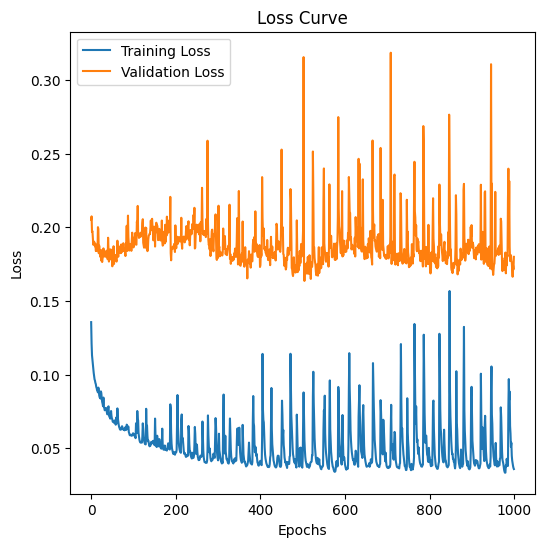

In [27]:
# Plot loss curves
plt.figure(figsize=(6, 6))

# Plotting Training and Validation Loss
plt.subplot(1, 1, 1)
plt.plot(train_losses, label='Training Loss')
plt.plot(valid_losses, label='Validation Loss')
plt.title('Loss Curve')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

### Load and test a model

In [19]:
# To load and use the best model

input_shape = (1, width, height)  # This is the shape of the input image to the network
num_classes = 1  # This is the number of output classes
output_shape = (num_classes, width, height)  # This is the shape of the output mask
init_channels = 32  # This is the number of channels in the first layer of the network

#model = UNet(input_shape=input_shape, output_shape=output_shape, init_channels=init_channels).to(device)

model_weights_path = "../Modèles/2D/best_model_2.pth"
model.load_state_dict(torch.load(model_weights_path))

C:\Users\User\AppData\Local\Temp\ipykernel_30440\945301830.py:11: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_weights_path))


<All keys matched successfully>

In [20]:
num_workers = os.cpu_count() - 1
print("num_worker s=",num_workers)

# Create test_dataloader2, batch_size=1, just for the display of the following cell
test_dataloader2 = DataLoader(
    test_dataset, 
    batch_size=1, 
    pin_memory=torch.cuda.is_available(), 
    shuffle=False
)

# Create an iterator to iterate over the test dataloader
test_dataloader_iter = iter(test_dataloader2)

num_worker s= 11


Image shape: torch.Size([1, 1, 256, 256])


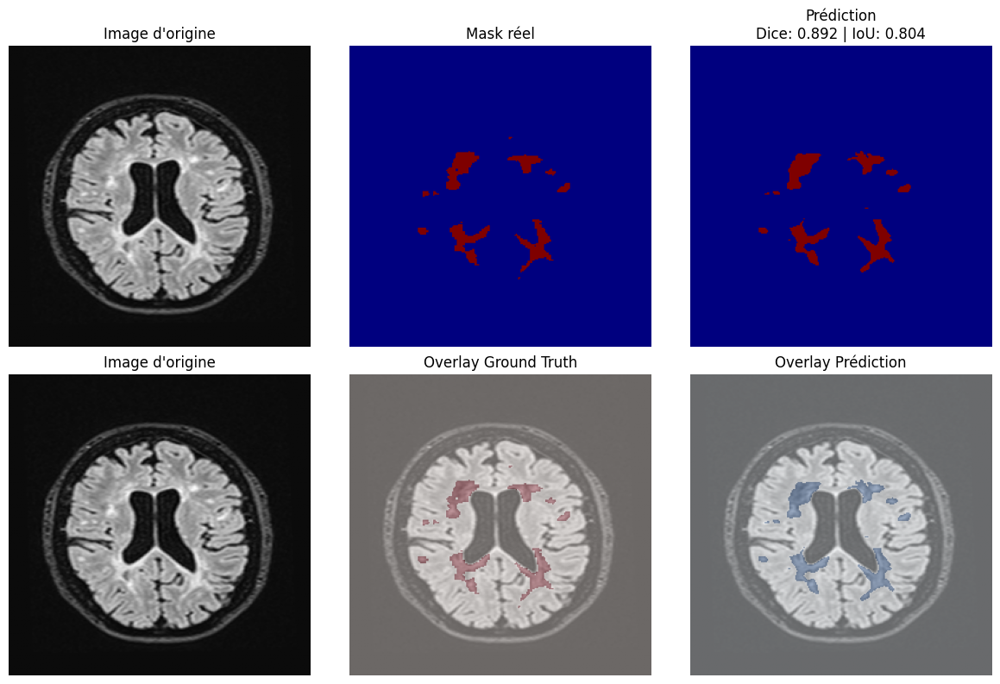

✅ Dice (MONAI) : 0.892
✅ IoU  (MONAI) : 0.804
✅ Dice (NumPy) : 0.892
✅ IoU  (NumPy) : 0.804


In [23]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import torch.nn.functional as F
from monai.networks.nets import UNet
from monai.metrics import DiceMetric, MeanIoU

# --- METRICS MONAI ---
dice_metric = DiceMetric(include_background=False, reduction="mean")
iou_metric = MeanIoU(include_background=False)

# --- METRICS numpy ---
def dice_score(pred, label):
    pred = pred.astype(np.bool_)
    label = label.astype(np.bool_)
    intersection = np.logical_and(pred, label).sum()
    return 2. * intersection / (pred.sum() + label.sum() + 1e-8)

def iou_score(pred, label):
    pred = pred.astype(np.bool_)
    label = label.astype(np.bool_)
    intersection = np.logical_and(pred, label).sum()
    union = np.logical_or(pred, label).sum()
    return intersection / (union + 1e-8)

# --- FONCTION D'ÉVALUATION ---
def evaluate_model_on_batch(model, dataloader, device):
    model = model.to(device)
    model.eval()

    dice_metric.reset()
    iou_metric.reset()

    batch_data = next(iter(dataloader))  # prend un batch

    with torch.no_grad():
        images, labels, names = batch_data  # attention ici : dataset retourne aussi les noms !
        images = images.to(device)
        labels = labels.to(device)

        # prendre seulement la première image du batch
        image = images[0].unsqueeze(0)  # [1, 1, H, W]
        label = labels[0].unsqueeze(0)  # [1, 1, H, W]

        print("Image shape:", image.shape)

        preds = model(image)

        # Appliquer sigmoid + threshold
        preds = torch.sigmoid(preds)
        preds = (preds > 0.5).float()

        # Calcul MONAI metrics
        dice_metric(preds, label)
        iou_metric(preds, label)
        dice_metric_result = dice_metric.aggregate().item()
        iou_metric_result = iou_metric.aggregate().item()

        # --- Conversion numpy pour affichage ---
        image_np = image.squeeze().detach().cpu().numpy()
        label_np = label.squeeze().detach().cpu().numpy()
        preds_np = preds.squeeze().detach().cpu().numpy()

        # Normaliser l'image [-1,1] → [0,1]
        image_np = (image_np + 1) / 2.0

        # Calcul numpy metrics
        dice = dice_score(preds_np, label_np)
        iou = iou_score(preds_np, label_np)

    # --- AFFICHAGE ---
    fig, axes = plt.subplots(2, 3, figsize=(12, 8))

    axes[0, 0].imshow(image_np, cmap="gray")
    axes[0, 0].set_title("Image d'origine")
    axes[0, 0].axis("off")

    axes[0, 1].imshow(label_np, cmap="jet")
    axes[0, 1].set_title("Mask réel")
    axes[0, 1].axis("off")

    axes[0, 2].imshow(preds_np, cmap="jet")
    axes[0, 2].set_title(f"Prédiction\nDice: {dice:.3f} | IoU: {iou:.3f}")
    axes[0, 2].axis("off")

    axes[1, 0].imshow(image_np, cmap="gray")
    axes[1, 0].set_title("Image d'origine")
    axes[1, 0].axis("off")

    axes[1, 1].imshow(image_np, cmap="gray")
    axes[1, 1].imshow(label_np, cmap="Reds", alpha=0.4)
    axes[1, 1].set_title("Overlay Ground Truth")
    axes[1, 1].axis("off")

    axes[1, 2].imshow(image_np, cmap="gray")
    axes[1, 2].imshow(preds_np, cmap="Blues", alpha=0.4)
    axes[1, 2].set_title("Overlay Prédiction")
    axes[1, 2].axis("off")

    plt.tight_layout()
    plt.show()

    print(f"✅ Dice (MONAI) : {dice_metric_result:.3f}")
    print(f"✅ IoU  (MONAI) : {iou_metric_result:.3f}")
    print(f"✅ Dice (NumPy) : {dice:.3f}")
    print(f"✅ IoU  (NumPy) : {iou:.3f}")

# --- UTILISATION ---
# Exemple :
# model = UNet(...)  # Ton modèle déjà chargé
# test_dataloader = DataLoader(test_dataset, batch_size=4, shuffle=False, num_workers=1)

evaluate_model_on_batch(model, test_dataloader, device)

## Affichage des matrices Dice/IoU par modèle et patient (2D U-Net)

In [24]:
import os
import torch
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# 1. Lister tous les modèles 2D disponibles
models_dir_2d = "../Modèles/2D/"
model_files_2d = [f for f in os.listdir(models_dir_2d) if f.endswith('.pth')]
model_files_2d.sort()

# 2. Liste des patients (à partir des dossiers pngData)
patient_dirs_2d = [p for p in os.listdir(ROOT_DIR) if os.path.isdir(os.path.join(ROOT_DIR, p))]
patient_dirs_2d.sort()
patient_names_2d = patient_dirs_2d

# 3. Matrices pour stocker les scores
dice_matrix_2d = np.zeros((len(model_files_2d), len(patient_names_2d)))
iou_matrix_2d = np.zeros((len(model_files_2d), len(patient_names_2d)))

# 4. Boucle sur chaque modèle et chaque patient
from monai.networks.nets import UNet

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

for m_idx, model_file in enumerate(model_files_2d):
    model_path = os.path.join(models_dir_2d, model_file)
    model = UNet(
        spatial_dims=2,
        in_channels=1,
        out_channels=1,
        channels=(16, 32, 64, 128, 256),
        strides=(2, 2, 2, 2),
        num_res_units=1
    ).to(device)
    try:
        state_dict = torch.load(model_path, map_location=device)
        model.load_state_dict(state_dict)
    except Exception as e:
        print(f"⚠️ Erreur lors du chargement de {model_file} : {e}")
        continue
    model.eval()
    with torch.no_grad():
        for p_idx, patient_name in enumerate(patient_names_2d):
            images_folder = os.path.join(ROOT_DIR, patient_name, "images")
            masks_folder = os.path.join(ROOT_DIR, patient_name, "masks")
            image_files = sorted([f for f in os.listdir(images_folder) if f.endswith('.png')])
            dice_scores = []
            iou_scores = []
            for img_file in image_files:
                img_path = os.path.join(images_folder, img_file)
                mask_path = os.path.join(masks_folder, img_file)
                if not (os.path.exists(img_path) and os.path.exists(mask_path)):
                    continue
                img = Image.open(img_path).convert('L').resize((width, height))
                mask = Image.open(mask_path).convert('L').resize((width, height))
                img_tensor = transforms.ToTensor()(img).unsqueeze(0).to(device)
                mask_tensor = (transforms.ToTensor()(mask) > 0.5).float().unsqueeze(0).to(device)
                output = torch.sigmoid(model(img_tensor))
                pred = (output > 0.4).float()
                intersection = (pred * mask_tensor).sum().item()
                dice = (2.0 * intersection) / (pred.sum().item() + mask_tensor.sum().item() + 1e-8)
                iou = intersection / ((pred + mask_tensor).clamp(0, 1).sum().item() + 1e-8)
                dice_scores.append(dice)
                iou_scores.append(iou)
            # Moyenne sur toutes les slices du patient
            dice_matrix_2d[m_idx, p_idx] = np.mean(dice_scores) if dice_scores else 0
            iou_matrix_2d[m_idx, p_idx] = np.mean(iou_scores) if iou_scores else 0
    del model
    torch.cuda.empty_cache()

C:\Users\User\AppData\Local\Temp\ipykernel_30440\2076973313.py:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load(model_path, map_location=device)


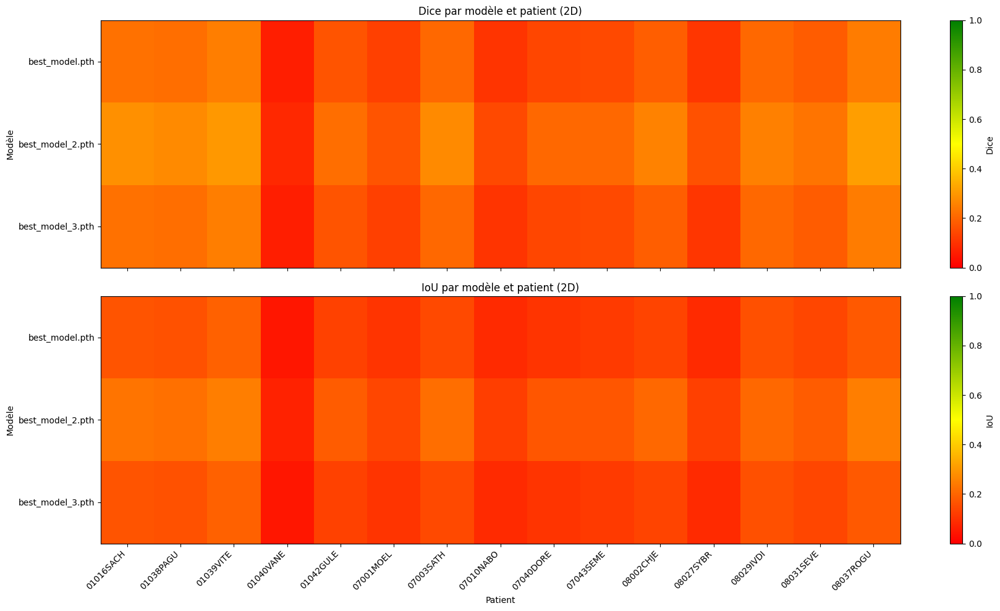

In [25]:
# Affichage matplotlib avec colormap rouge-jaune-vert
cmap_rjyv = mcolors.LinearSegmentedColormap.from_list("rjyv", ["red", "yellow", "green"])

fig, axes = plt.subplots(2, 1, figsize=(18, 10), sharex=True)

# Dice
im1 = axes[0].imshow(dice_matrix_2d, aspect='auto', cmap=cmap_rjyv, vmin=0, vmax=1)
axes[0].set_title('Dice par modèle et patient (2D)')
axes[0].set_ylabel('Modèle')
axes[0].set_yticks(np.arange(len(model_files_2d)))
axes[0].set_yticklabels(model_files_2d)
axes[0].set_xticks(np.arange(len(patient_names_2d)))
axes[0].set_xticklabels(patient_names_2d, rotation=45, ha='right')
fig.colorbar(im1, ax=axes[0], label='Dice')

# IoU
im2 = axes[1].imshow(iou_matrix_2d, aspect='auto', cmap=cmap_rjyv, vmin=0, vmax=1)
axes[1].set_title('IoU par modèle et patient (2D)')
axes[1].set_ylabel('Modèle')
axes[1].set_xlabel('Patient')
axes[1].set_yticks(np.arange(len(model_files_2d)))
axes[1].set_yticklabels(model_files_2d)
axes[1].set_xticks(np.arange(len(patient_names_2d)))
axes[1].set_xticklabels(patient_names_2d, rotation=45, ha='right')
fig.colorbar(im2, ax=axes[1], label='IoU')

plt.tight_layout()
plt.show()

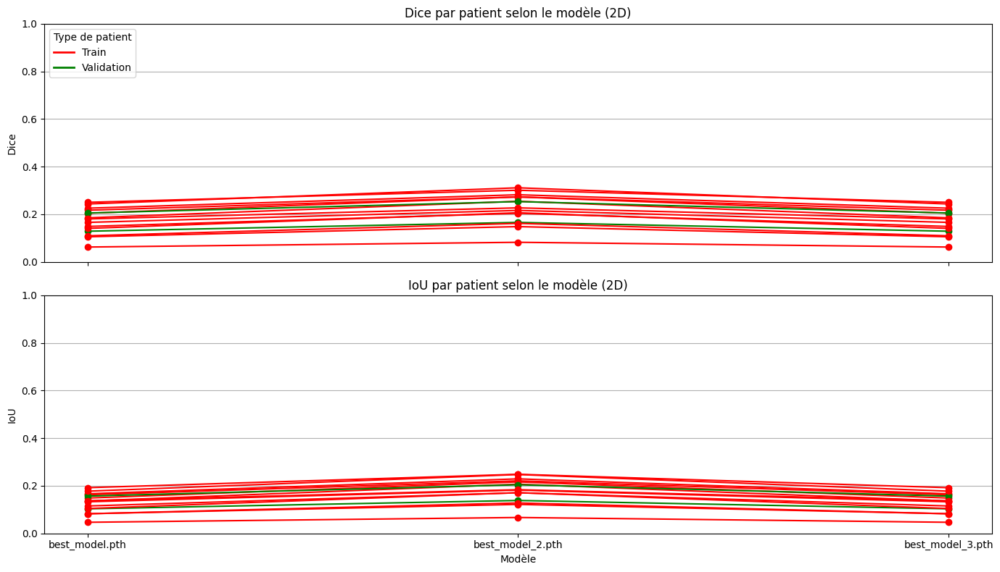

In [26]:
# Affichage des courbes par patient (Dice/IoU selon le modèle)
import matplotlib.pyplot as plt
import numpy as np

# Détermine le type (train/val) pour chaque patient (si possible)
# Ici, on suppose que la répartition train/val est la même que dans le split du notebook
patient_types_2d = []
for name in patient_names_2d:
    idx = None
    for i, p in enumerate(train_dataset.dataset.image_paths):
        if name in p:
            idx = i
            break
    if idx is not None and idx in train_dataset.indices:
        patient_types_2d.append('train')
    else:
        patient_types_2d.append('val')
colors = ['red' if t == 'train' else 'green' for t in patient_types_2d]

fig, axes = plt.subplots(2, 1, figsize=(14, 8), sharex=True)

# Courbes Dice
for p_idx, name in enumerate(patient_names_2d):
    axes[0].plot(model_files_2d, dice_matrix_2d[:, p_idx], marker='o', color=colors[p_idx], label=name)
axes[0].set_title('Dice par patient selon le modèle (2D)')
axes[0].set_ylabel('Dice')
axes[0].set_ylim(0, 1)
axes[0].grid(True, axis='y')
from matplotlib.lines import Line2D
legend_elements = [
    Line2D([0], [0], color='red', lw=2, label='Train'),
    Line2D([0], [0], color='green', lw=2, label='Validation')
]
axes[0].legend(handles=legend_elements, loc='upper left', title="Type de patient")

# Courbes IoU
for p_idx, name in enumerate(patient_names_2d):
    axes[1].plot(model_files_2d, iou_matrix_2d[:, p_idx], marker='o', color=colors[p_idx], label=name)
axes[1].set_title('IoU par patient selon le modèle (2D)')
axes[1].set_ylabel('IoU')
axes[1].set_xlabel('Modèle')
axes[1].set_ylim(0, 1)
axes[1].grid(True, axis='y')

plt.tight_layout()
plt.show()

C:\Users\User\AppData\Local\Temp\ipykernel_30440\2175837184.py:16: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load("../Modèles/2D/best_model_2

Patient choisi (train): 01039VITE


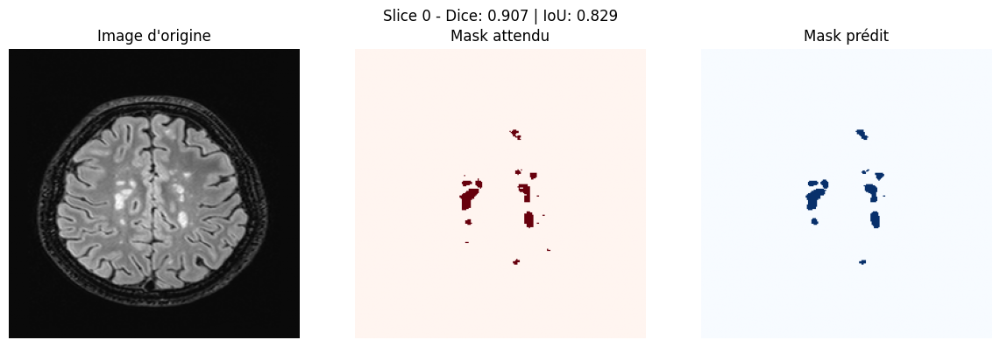

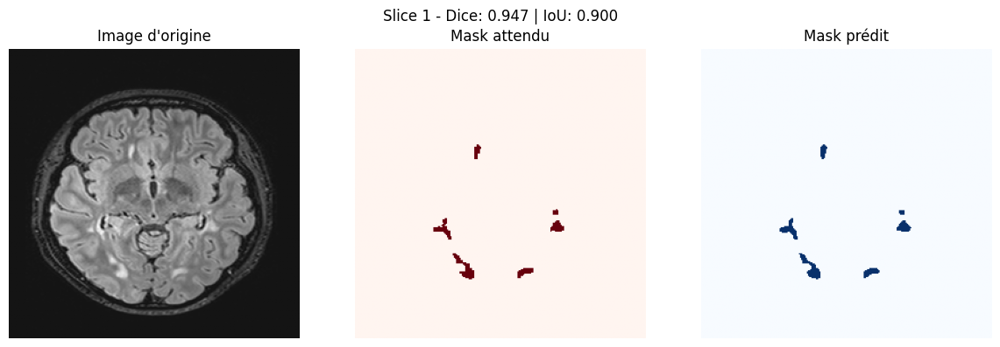

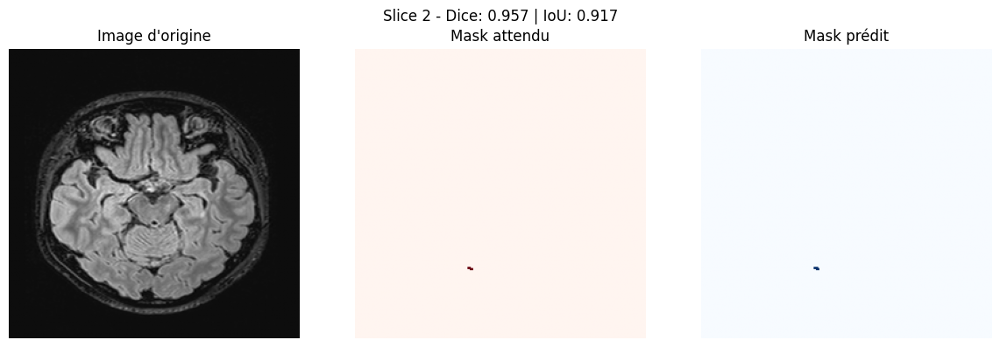

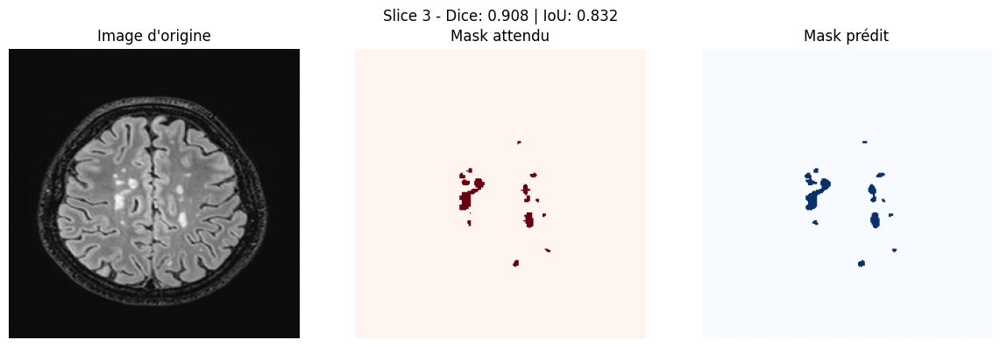

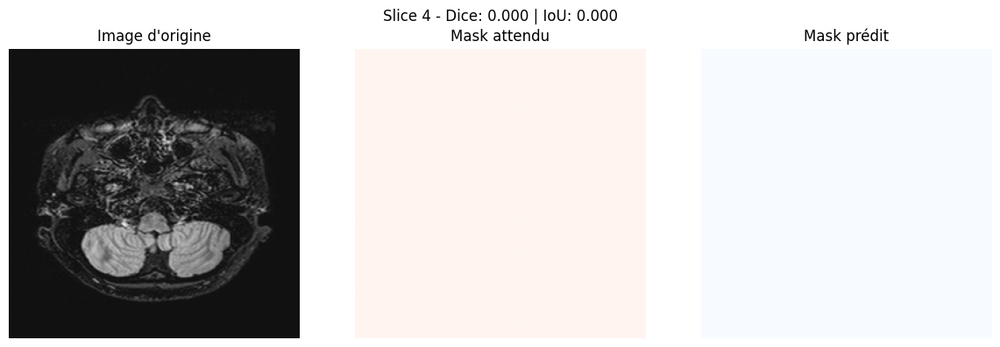

...

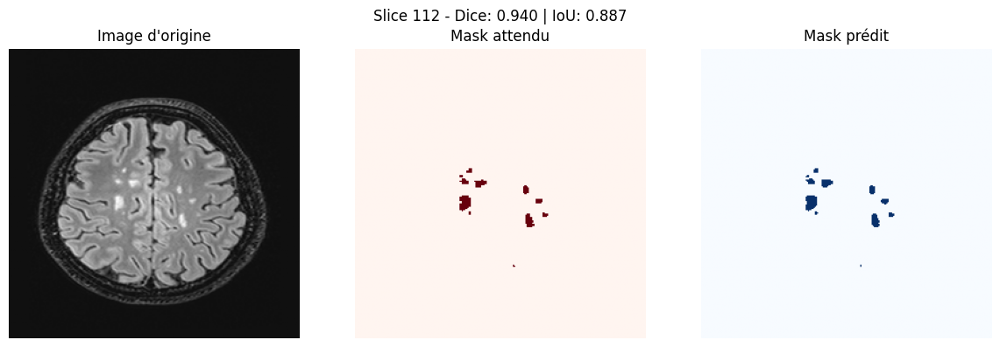

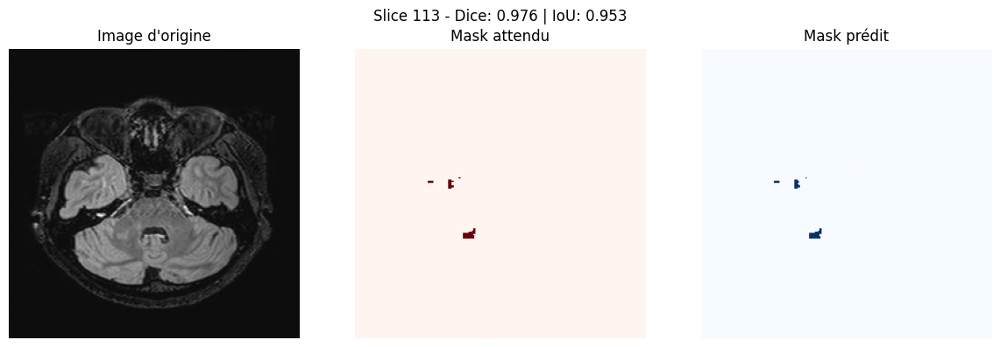

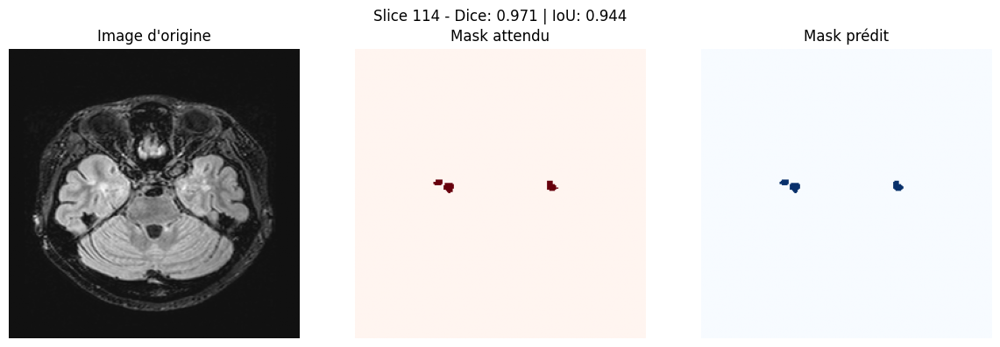

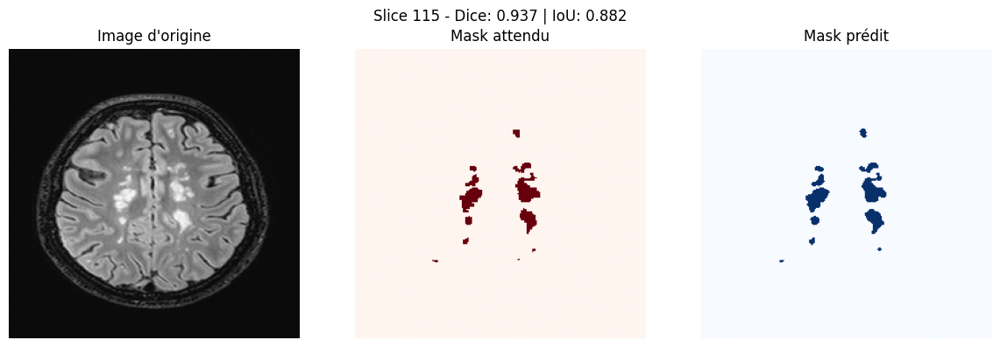

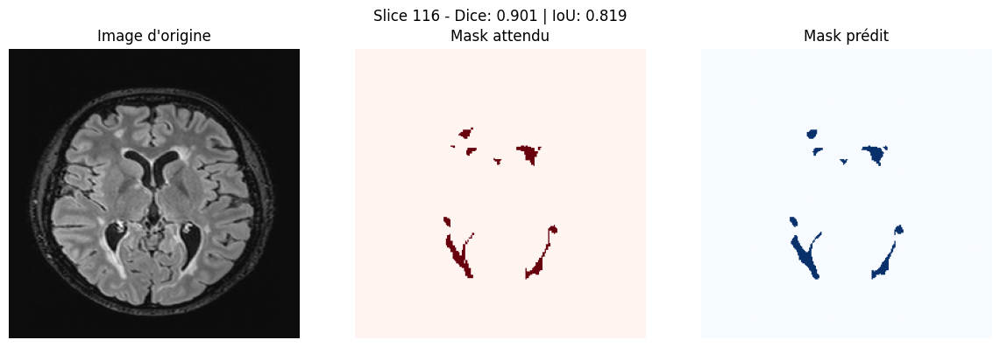

Dice moyen sur 117 slices : 0.8123
IoU moyen sur 117 slices : 0.7679


In [32]:
import random
import torch
import numpy as np
import matplotlib.pyplot as plt

# Charger le modèle best_model_2.pth (s'assure que c'est bien ce modèle qui est utilisé)
from monai.networks.nets import UNet
model = UNet(
    spatial_dims=2,
    in_channels=1,
    out_channels=1,
    channels=(16, 32, 64, 128, 256),
    strides=(2, 2, 2, 2),
    num_res_units=1
).to(device)
model.load_state_dict(torch.load("../Modèles/2D/best_model_2.pth", map_location=device))
model.eval()

# Sélectionner un patient aléatoire du training set
patient_image_paths = [train_dataset.dataset.image_paths[i] for i in train_dataset.indices]
patient_names = [os.path.normpath(p).split(os.sep)[-3] for p in patient_image_paths]
unique_patients = list(sorted(set(patient_names)))
random_patient = random.choice(unique_patients)
print(f"Patient choisi (train): {random_patient}")

# Récupérer tous les indices de slices de ce patient dans le train_dataset
slice_indices = [i for i, p in zip(train_dataset.indices, patient_image_paths) if random_patient in p]
if not slice_indices:
    print("Aucune slice trouvée pour ce patient dans le train_dataset.")
else:
    dice_list = []
    iou_list = []
    for idx_num, idx in enumerate(slice_indices):
        img, mask, _ = train_dataset.dataset[idx]
        img = img.unsqueeze(0).to(device)  # [1, 1, H, W]
        mask = mask.unsqueeze(0).to(device)  # [1, 1, H, W]
        with torch.no_grad():
            output = model(img)
            pred = torch.sigmoid(output) > 0.5
        pred_np = pred.squeeze().cpu().numpy()
        mask_np = mask.squeeze().cpu().numpy()
        img_np = img.squeeze().cpu().numpy()
        intersection = np.logical_and(pred_np, mask_np).sum()
        dice = (2. * intersection) / (pred_np.sum() + mask_np.sum() + 1e-8)
        union = np.logical_or(pred_np, mask_np).sum()
        iou = intersection / (union + 1e-8)
        dice_list.append(dice)
        iou_list.append(iou)

        # Affichage slice par slice : image, mask attendu, mask prédit
        fig, axs = plt.subplots(1, 3, figsize=(12, 4))
        axs[0].imshow((img_np + 1) / 2.0, cmap='gray')
        axs[0].set_title("Image d'origine")
        axs[0].axis('off')
        axs[1].imshow(mask_np, cmap='Reds')
        axs[1].set_title("Mask attendu")
        axs[1].axis('off')
        axs[2].imshow(pred_np, cmap='Blues')
        axs[2].set_title("Mask prédit")
        axs[2].axis('off')
        plt.suptitle(f"Slice {idx_num} - Dice: {dice:.3f} | IoU: {iou:.3f}")
        plt.tight_layout()
        plt.show()

    # Moyenne
    print(f"Dice moyen sur {len(dice_list)} slices : {np.mean(dice_list):.4f}")
    print(f"IoU moyen sur {len(iou_list)} slices : {np.mean(iou_list):.4f}")